In [1]:
from minidataset_constants import PATHS_DICTIONARY

from plot_utils import plot_clusters_from_labels, \
                       plot_cluster_labels_count, \
                       plot_grid_clusters, \
                       plot_kneighbours,\
                       get_number_of_clusters

from data_utils import classify_zernike_coefficients_clusters

from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering

import numpy as np

import hdbscan

from collections import Counter

import matplotlib.pyplot as plt

from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN

from sklearn.metrics import normalized_mutual_info_score


In [2]:
minidataset_9m_dict = PATHS_DICTIONARY['MINI_9M']

# Cluster Zernike Coefficients

Load coefficients

In [3]:
zernike_coefficients_9m = np.load(minidataset_9m_dict['zernike_mode_coefficients_path'])

Compute original labels

In [4]:
zernike_original_labels_9m = classify_zernike_coefficients_clusters(zernike_coefficients_9m, 
                                                         minidataset_9m_dict['labels_dictionary'])

The most repeated label is 26 with 127 occurrences.
The least repeated label is 14 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


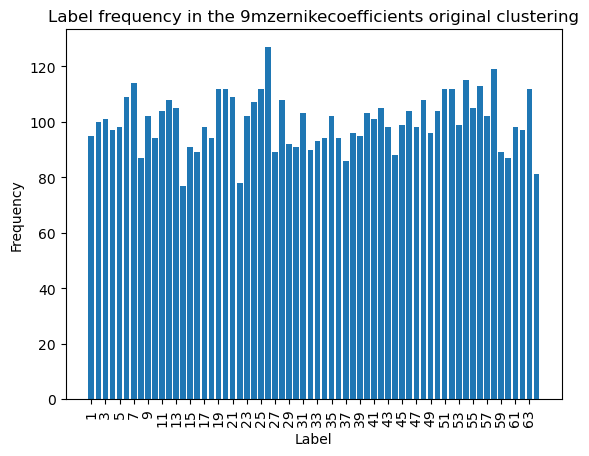

In [5]:
plot_cluster_labels_count(zernike_original_labels_9m, 
                          'original', 
                          '9mzernikecoefficients')

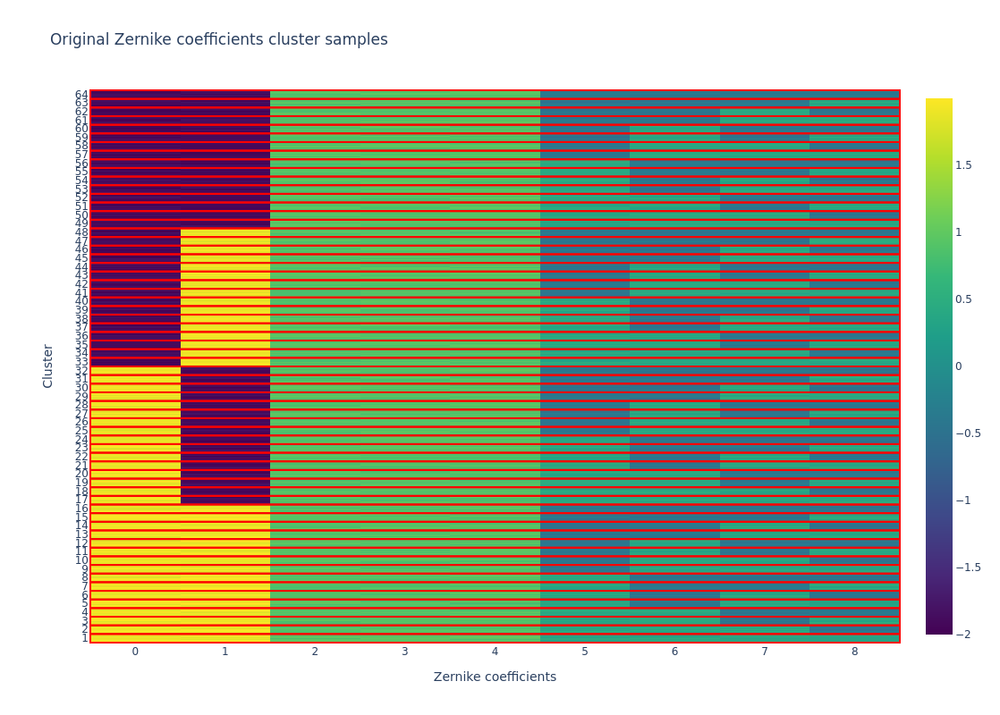

In [6]:
plot_grid_clusters(
    zernike_coefficients_9m,
    zernike_original_labels_9m,
    [n for n in range(1,65)],
    "Original Zernike coefficients cluster samples",
    "Zernike coefficients",
    "Cluster",
    1,
    '9mzernikecoefficients',
    'original'
    )

### K-MEANS

In [7]:
kmeans = KMeans(n_clusters=64,
                n_init=10)
zernike_kmeans_labels_9m = kmeans.fit_predict(zernike_coefficients_9m)

The most repeated label is 32 with 127 occurrences.
The least repeated label is 9 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


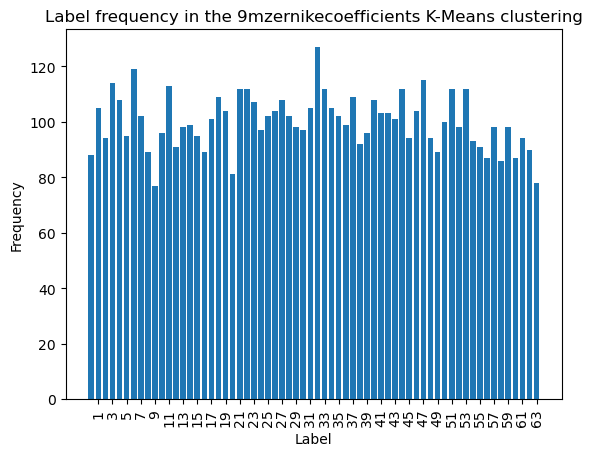

In [8]:
plot_cluster_labels_count(zernike_kmeans_labels_9m,
                          'K-Means', 
                          '9mzernikecoefficients')

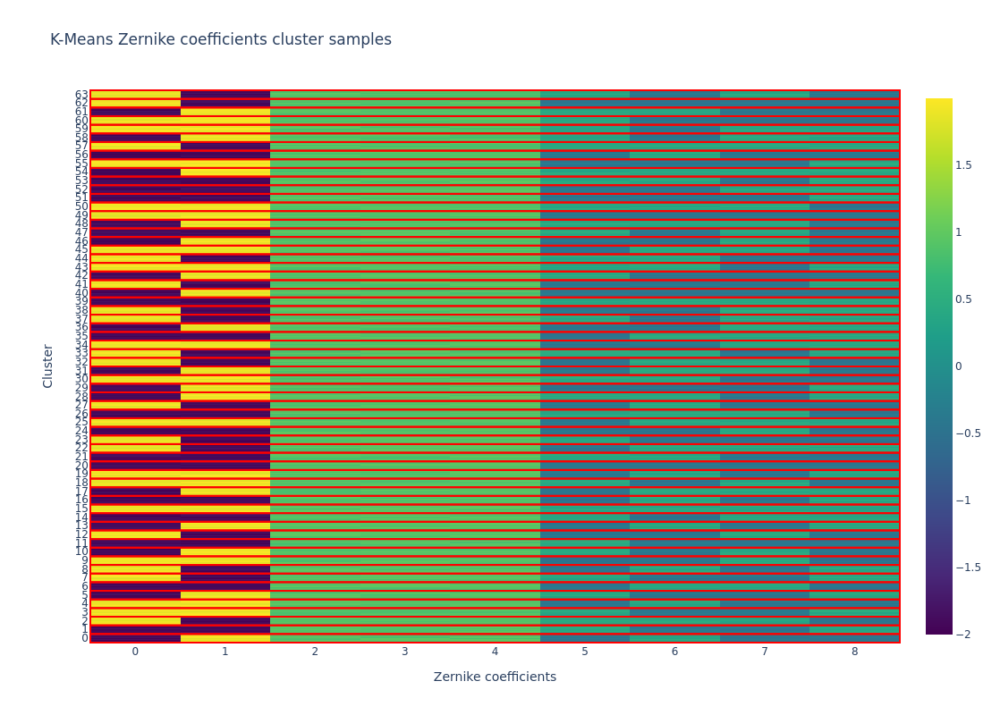

In [9]:
plot_grid_clusters(
    zernike_coefficients_9m,
    zernike_kmeans_labels_9m,
    [n for n in range(0,64)],
    "K-Means Zernike coefficients cluster samples",
    "Zernike coefficients",
    "Cluster",
    1,
    '9mzernikecoefficients',
    'K-Means'
    )

### DBSCAN

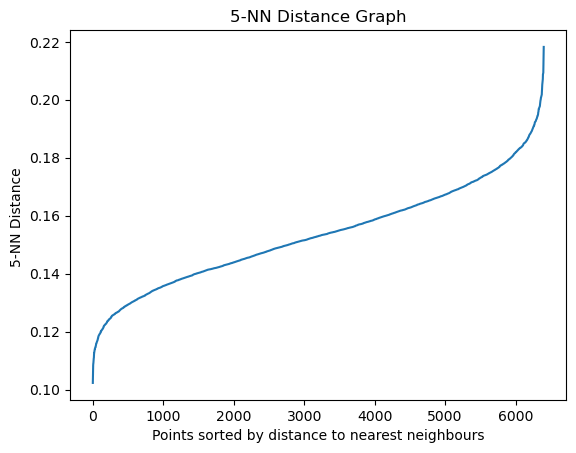

Number of clusters: 64
Numbers that are not noise: 6400


array([ 0,  1,  2, ..., 50, 55, 61])

In [13]:
n_neighbours = 5
plot_kneighbours(zernike_coefficients_9m, n_neighbours)
epsilon = 0.2
dbscan = DBSCAN(eps=epsilon, min_samples=n_neighbours)
zernike_dbscan_labels_9m = dbscan.fit_predict(zernike_coefficients_9m)
get_number_of_clusters(zernike_dbscan_labels_9m)

The most repeated label is 35 with 127 occurrences.
The least repeated label is 8 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


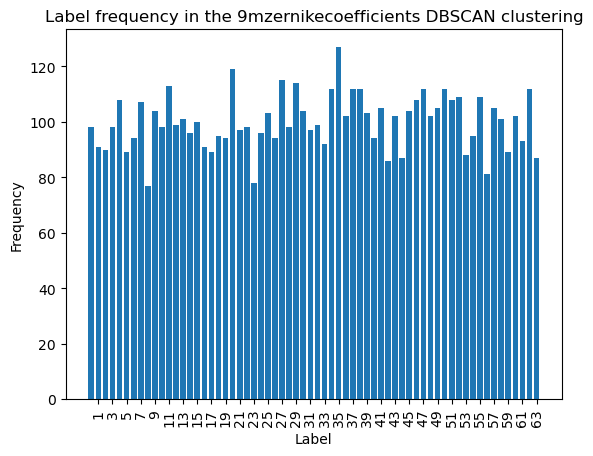

In [14]:
plot_cluster_labels_count(zernike_dbscan_labels_9m, 
                          'DBSCAN',
                          '9mzernikecoefficients')

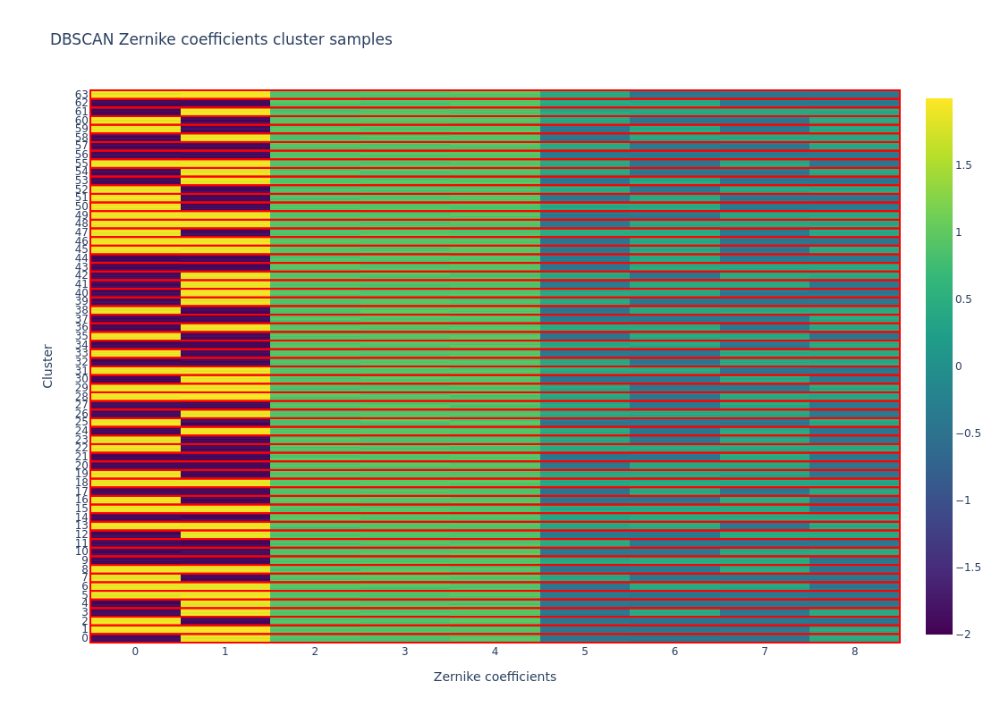

In [16]:
plot_grid_clusters(
    zernike_coefficients_9m,
    zernike_dbscan_labels_9m,
    [n for n in range(0,64)],
    "DBSCAN Zernike coefficients cluster samples",
    "Zernike coefficients",
    "Cluster",
    1,
    '9mzernikecoefficients',
    'DBSCAN'
    )

### HDBSCAN

In [17]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=50)
zernike_hdbscan_labels_9m = clusterer.fit_predict(zernike_coefficients_9m)

The most repeated label is 54 with 127 occurrences.
The least repeated label is 9 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


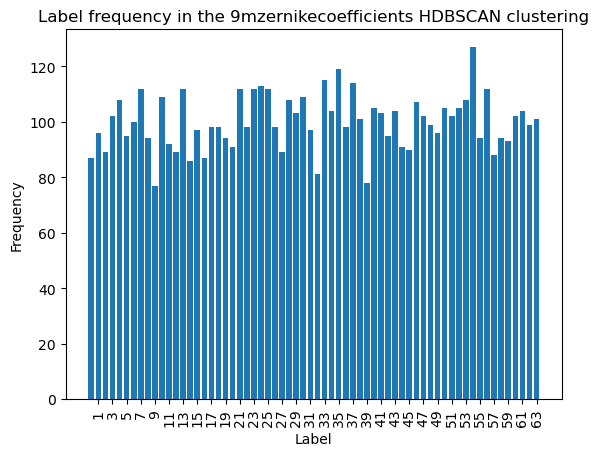

In [18]:
plot_cluster_labels_count(zernike_hdbscan_labels_9m, 
                          'HDBSCAN', 
                          '9mzernikecoefficients')

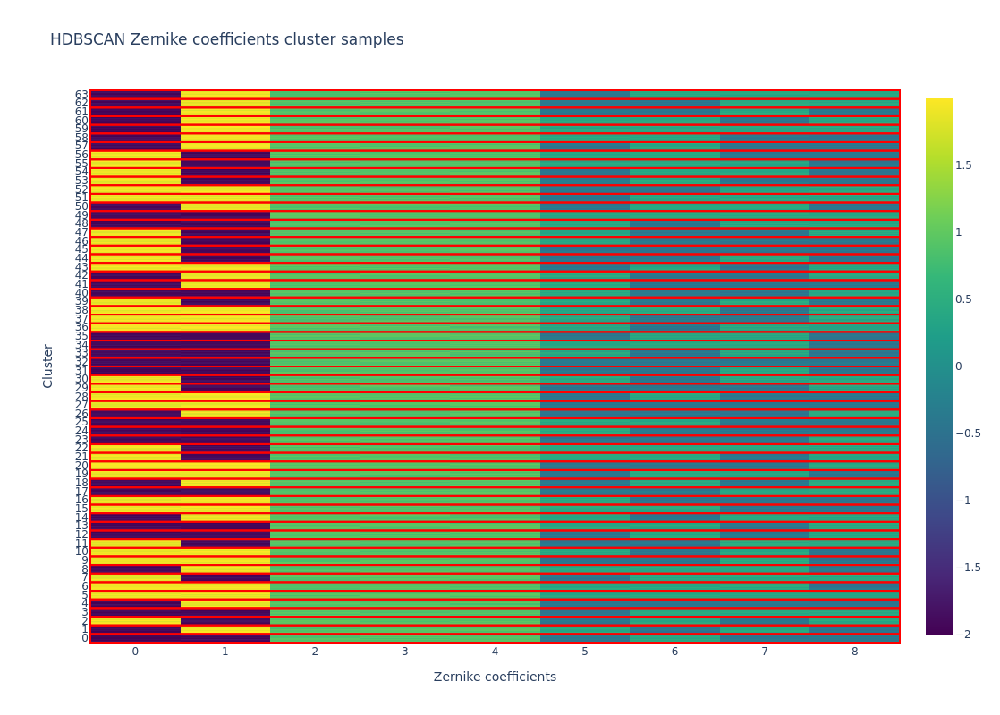

In [20]:
plot_grid_clusters(
    zernike_coefficients_9m,
    zernike_hdbscan_labels_9m,
    [n for n in range(0,64)],
    "HDBSCAN Zernike coefficients cluster samples",
    "Zernike coefficients",
    "Cluster",
    1,
    '9mzernikecoefficients',
    'HDBSCAN'
    )

### Agglomerative clustering

In [21]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=64)
zernike_agglomerative_labels_9m = agglomerativeclustering.fit_predict(zernike_coefficients_9m)

The most repeated label is 6 with 127 occurrences.
The least repeated label is 56 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


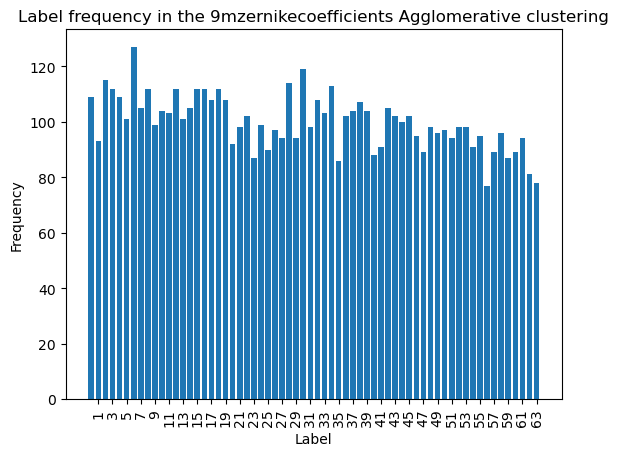

In [22]:
plot_cluster_labels_count(zernike_agglomerative_labels_9m, 
                          'Agglomerative', 
                          '9mzernikecoefficients')

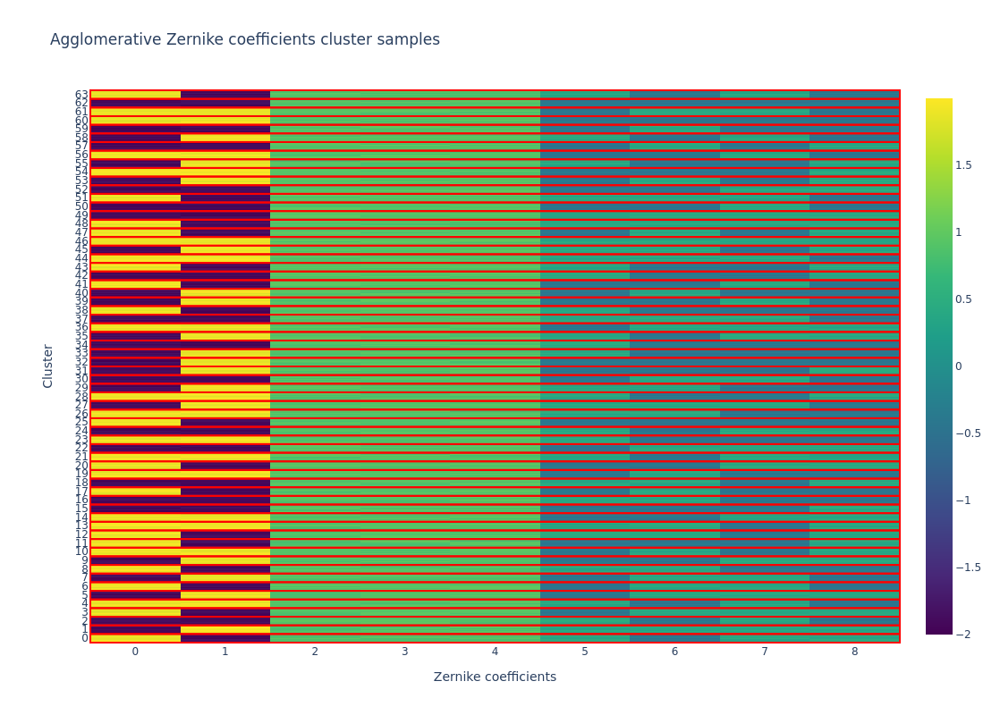

In [23]:
plot_grid_clusters(
    zernike_coefficients_9m,
    zernike_agglomerative_labels_9m,
    [n for n in range(0,64)],
    "Agglomerative Zernike coefficients cluster samples",
    "Zernike coefficients",
    "Cluster",
    1,
    '9mzernikecoefficients',
    'Agglomerative'
    )

In [24]:
print(normalized_mutual_info_score(zernike_kmeans_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(zernike_dbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(zernike_hdbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(zernike_agglomerative_labels_9m, zernike_original_labels_9m))

print(normalized_mutual_info_score(zernike_dbscan_labels_9m, zernike_kmeans_labels_9m))
print(normalized_mutual_info_score(zernike_hdbscan_labels_9m, zernike_kmeans_labels_9m))
print(normalized_mutual_info_score(zernike_agglomerative_labels_9m, zernike_kmeans_labels_9m))

print(normalized_mutual_info_score(zernike_hdbscan_labels_9m, zernike_dbscan_labels_9m))
print(normalized_mutual_info_score(zernike_agglomerative_labels_9m, zernike_dbscan_labels_9m))

print(normalized_mutual_info_score(zernike_agglomerative_labels_9m, zernike_hdbscan_labels_9m))

1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0000000000000002
1.0000000000000002
1.0


# Clustering LP coefficients

In [48]:
lp_coefficients_9m = np.load(minidataset_9m_dict['lp_modes_path']).reshape(6400, 2*19)

The most repeated label is 26 with 127 occurrences.
The least repeated label is 14 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


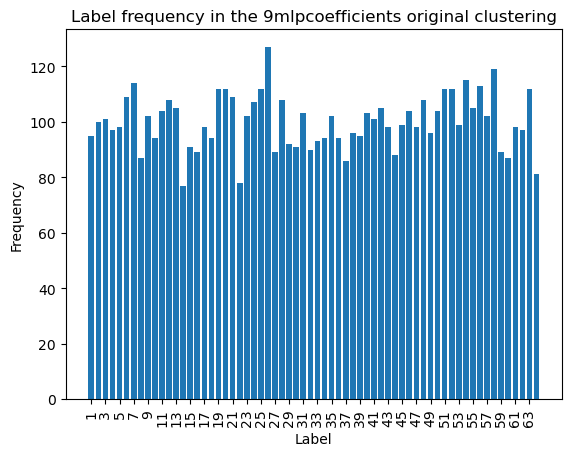

In [49]:
plot_cluster_labels_count(zernike_original_labels_9m, 
                          'original',
                          '9mlpcoefficients')

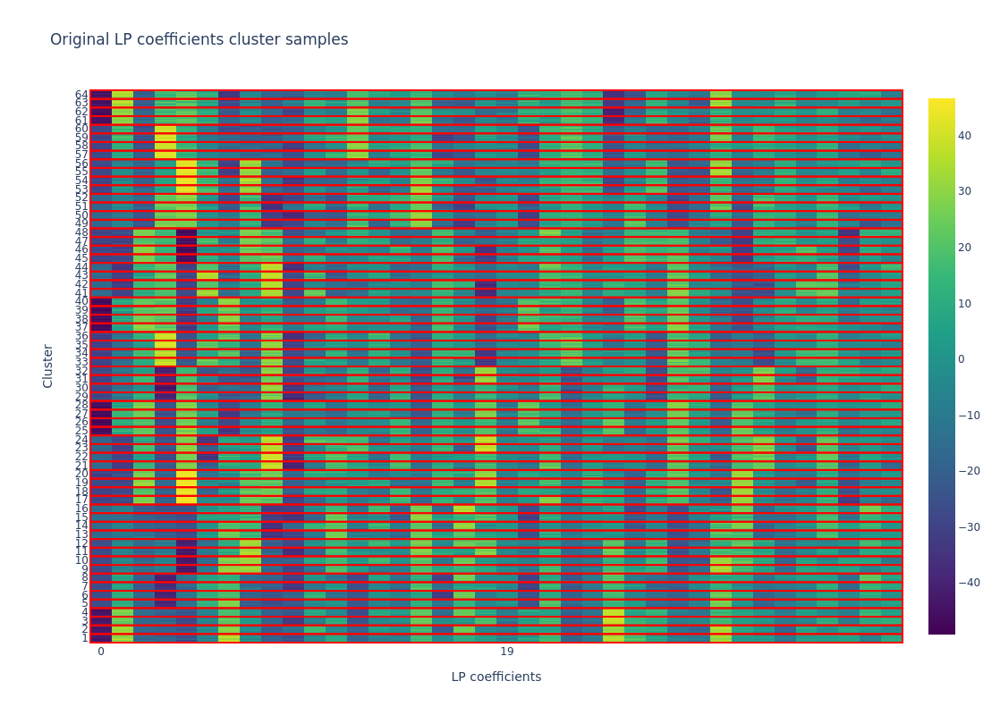

In [50]:
plot_grid_clusters(
    lp_coefficients_9m,
    zernike_original_labels_9m,
    [n for n in range(1, 65)],
    "Original LP coefficients cluster samples",
    "LP coefficients",
    "Cluster",
    19,
    '9mlpcoefficients',
    'original'
    )

### K-Means

In [51]:
kmeans = KMeans(n_clusters=64,
                n_init=100)
lp_kmeans_labels_9m = kmeans.fit_predict(lp_coefficients_9m)

The most repeated label is 44 with 127 occurrences.
The least repeated label is 14 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


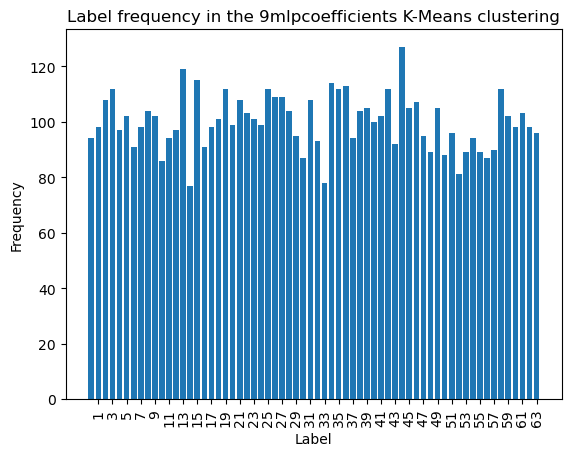

In [52]:
plot_cluster_labels_count(lp_kmeans_labels_9m, 
                          'K-Means',
                          '9mlpcoefficients')

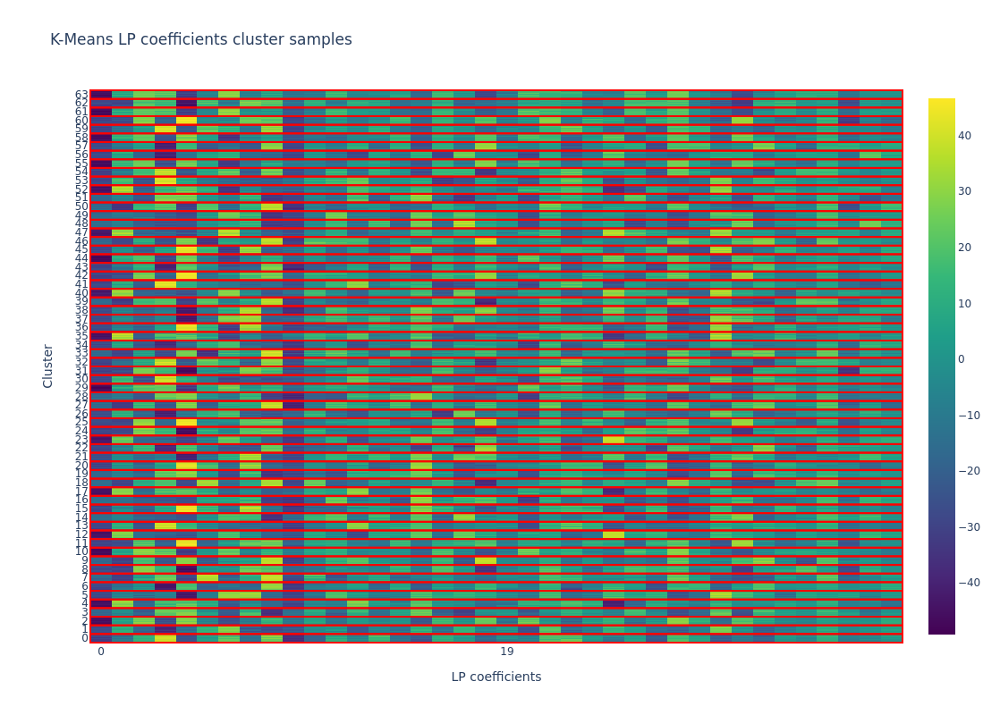

In [53]:
plot_grid_clusters(
    lp_coefficients_9m,
    lp_kmeans_labels_9m,
    [n for n in range(0,64)],
    "K-Means LP coefficients cluster samples",
    "LP coefficients",
    "Cluster",
    19,
    '9mlpcoefficients',
    'K-Means'
    )

### DBSCAN

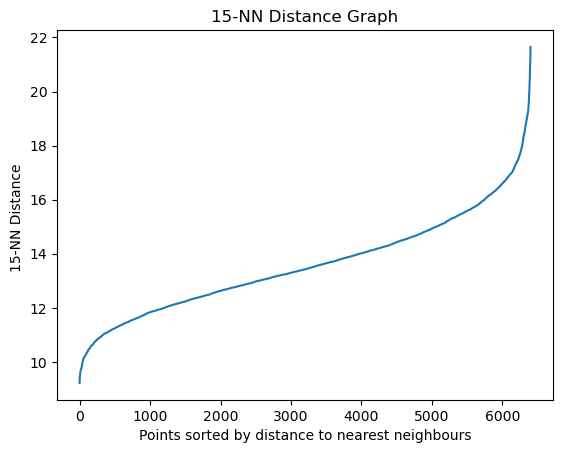

Number of clusters: 64
Numbers that are not noise: 6400


array([ 0,  1,  2, ..., 50, 54, 60])

In [54]:
n_neighbours = 15
plot_kneighbours(lp_coefficients_9m, n_neighbours)
epsilon = 18
dbscan = DBSCAN(eps=epsilon, min_samples=n_neighbours)
lp_dbscan_labels_9m = dbscan.fit_predict(lp_coefficients_9m)
get_number_of_clusters(lp_dbscan_labels_9m)

The most repeated label is 35 with 127 occurrences.
The least repeated label is 8 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


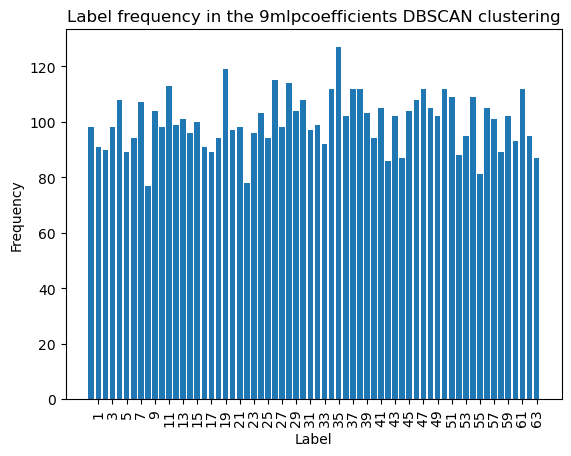

In [55]:
plot_cluster_labels_count(lp_dbscan_labels_9m, 
                          'DBSCAN', 
                          '9mlpcoefficients')

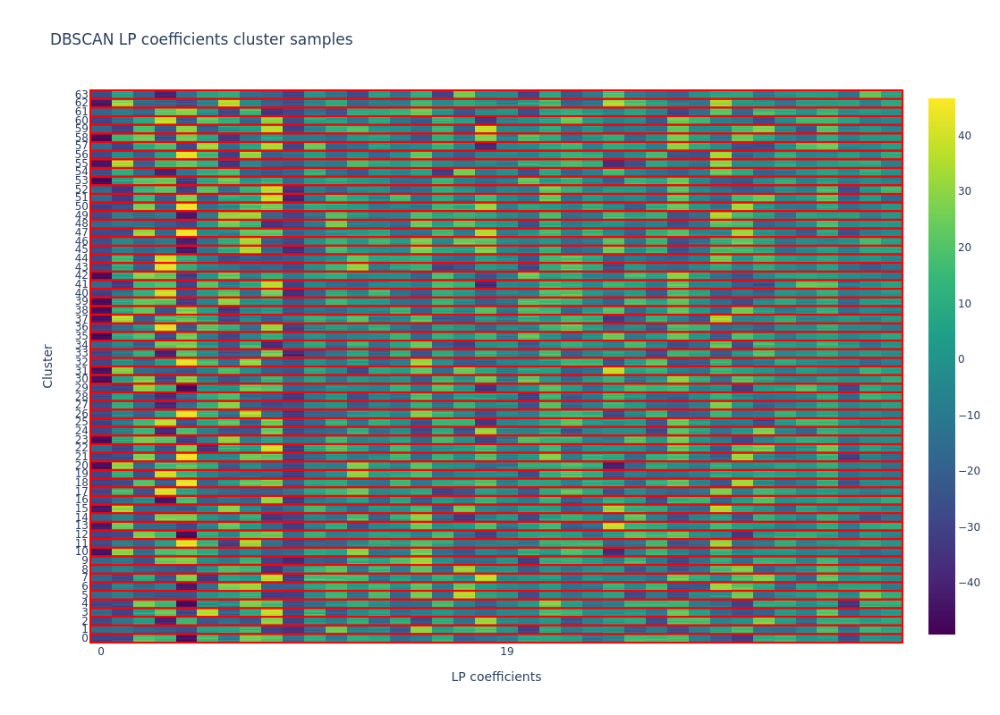

In [56]:
plot_grid_clusters(
    lp_coefficients_9m,
    lp_dbscan_labels_9m,
    [n for n in range(0, 64)],
    "DBSCAN LP coefficients cluster samples",
    "LP coefficients",
    "Cluster",
    19,
    '9mlpcoefficients',
    'DBSCAN'
    )

### HDBSCAN

In [57]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=21)
lp_hdbscan_labels_9m = clusterer.fit_predict(lp_coefficients_9m)

The most repeated label is 22 with 127 occurrences.
The least repeated label is 16 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


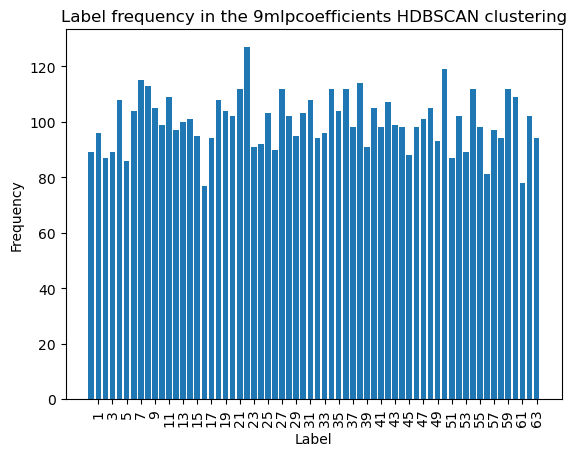

In [58]:
plot_cluster_labels_count(lp_hdbscan_labels_9m, 
                          'HDBSCAN', 
                          '9mlpcoefficients')

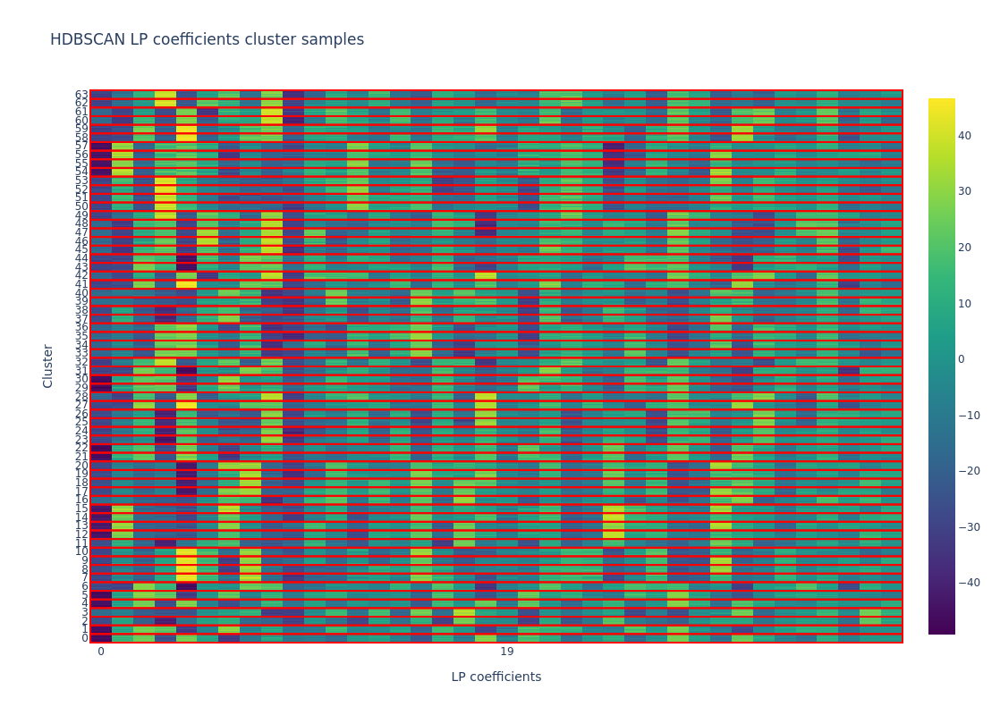

In [59]:
plot_grid_clusters(
    lp_coefficients_9m,
    lp_hdbscan_labels_9m,
    [n for n in range(0, 64)],
    "HDBSCAN LP coefficients cluster samples",
    "LP coefficients",
    "Cluster",
    19,
    '9mlpcoefficients',
    'HDBSCAN'
    )

### Agglomerative clustering

In [60]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=64)
lp_agglomerative_labels_9m = agglomerativeclustering.fit_predict(lp_coefficients_9m)

The most repeated label is 0 with 127 occurrences.
The least repeated label is 55 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


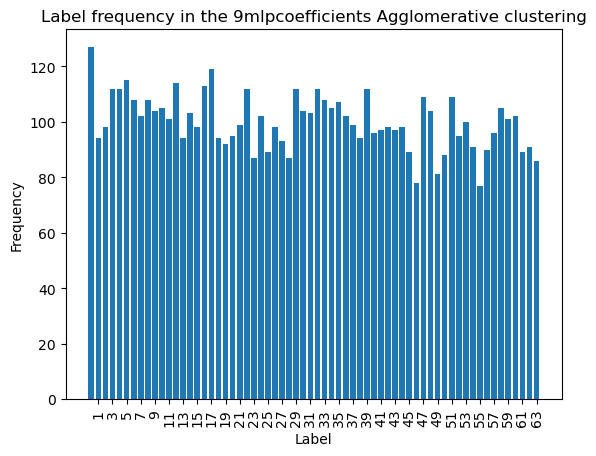

In [61]:
plot_cluster_labels_count(lp_agglomerative_labels_9m, 
                          'Agglomerative',
                         '9mlpcoefficients')

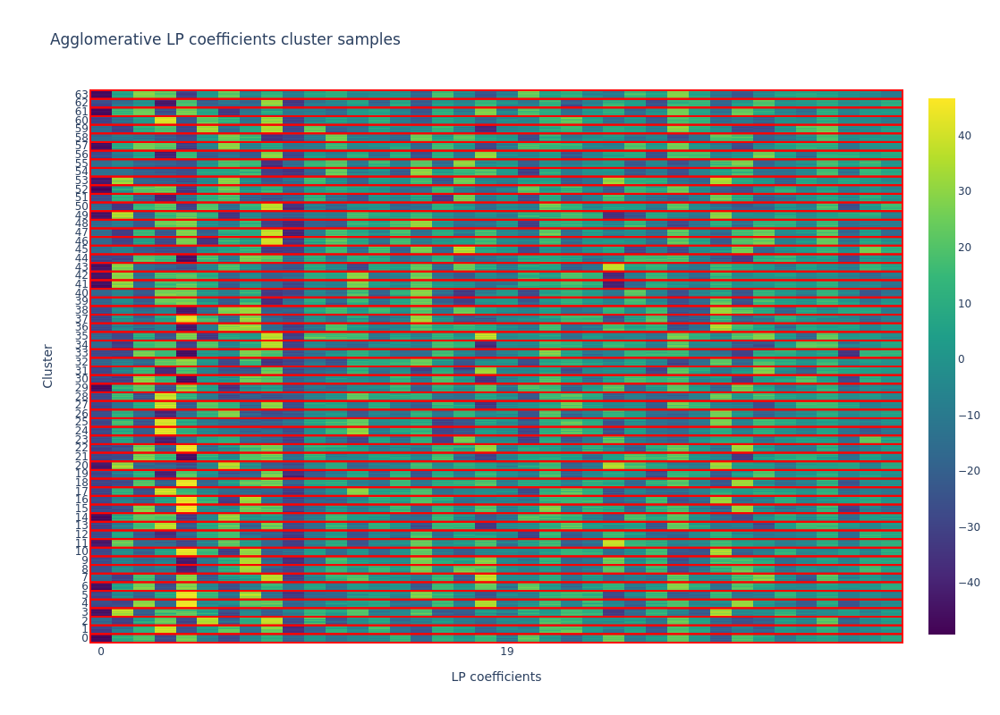

In [62]:
plot_grid_clusters(
    lp_coefficients_9m,
    lp_agglomerative_labels_9m,
    [n for n in range(0, 64)],
    "Agglomerative LP coefficients cluster samples",
    "LP coefficients",
    "Cluster",
    19,
    '9mlpcoefficients',
    'Agglomerative'
    )

In [63]:
print(normalized_mutual_info_score(lp_kmeans_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(lp_dbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(lp_hdbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(lp_agglomerative_labels_9m, zernike_original_labels_9m))
print()

print(normalized_mutual_info_score(lp_dbscan_labels_9m, lp_kmeans_labels_9m))
print(normalized_mutual_info_score(lp_hdbscan_labels_9m, lp_kmeans_labels_9m))
print(normalized_mutual_info_score(lp_agglomerative_labels_9m, lp_kmeans_labels_9m))
print()

print(normalized_mutual_info_score(lp_hdbscan_labels_9m, lp_dbscan_labels_9m))
print(normalized_mutual_info_score(lp_agglomerative_labels_9m, lp_dbscan_labels_9m))
print()

print(normalized_mutual_info_score(lp_agglomerative_labels_9m, lp_hdbscan_labels_9m))

1.0
1.0
1.0
1.0

1.0
1.0
0.9999999999999998

1.0
0.9999999999999998

0.9999999999999998


# Clustering Output fluxes

In [64]:
output_fluxes_9m = np.load(minidataset_9m_dict['output_fluxes'])

The most repeated label is 26 with 127 occurrences.
The least repeated label is 14 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


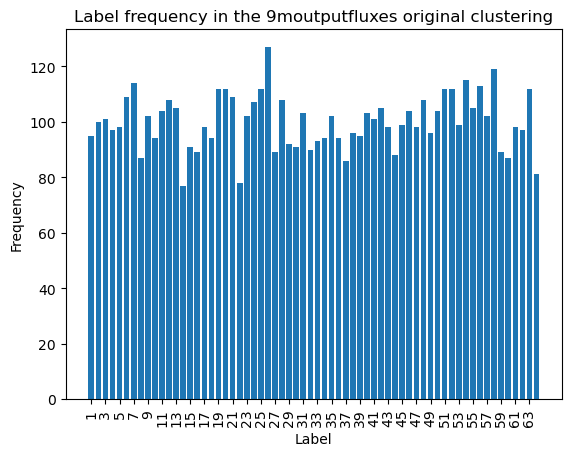

In [65]:
plot_cluster_labels_count(zernike_original_labels_9m, 
                          'original',
                          '9moutputfluxes')

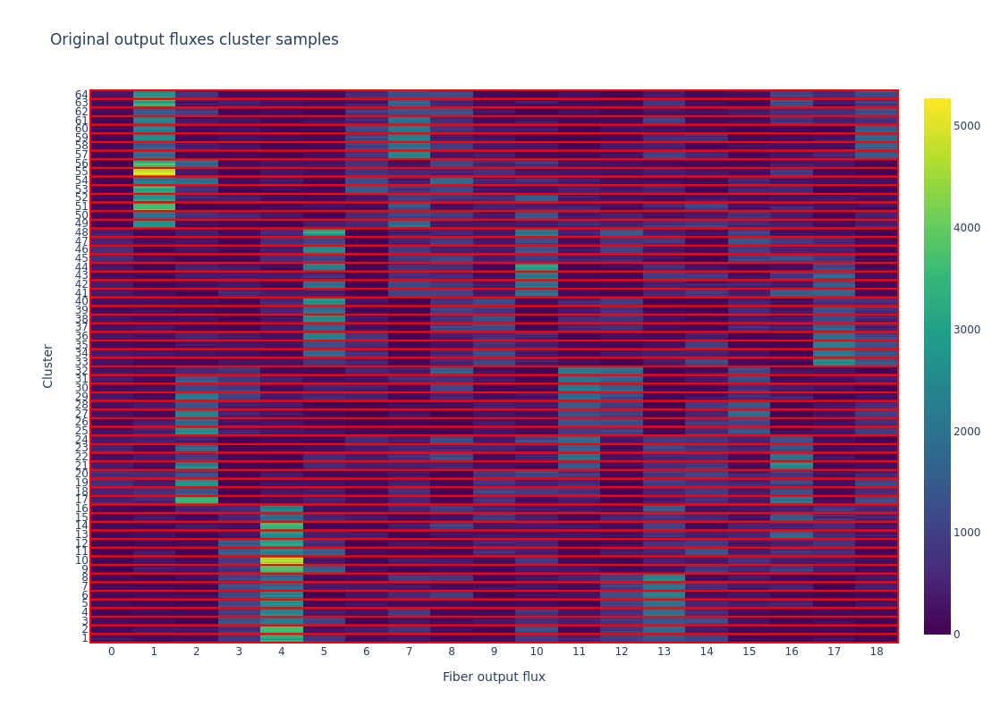

In [66]:
plot_grid_clusters(
    output_fluxes_9m,
    zernike_original_labels_9m,
    [n for n in range(1, 65)],
    "Original output fluxes cluster samples",
    "Fiber output flux",
    "Cluster",
    1,
    '9moutputfluxes',
    'original'
    )

### K-Means

In [72]:
kmeans = KMeans(n_clusters=64,
                n_init=100)
flux_kmeans_labels_9m = kmeans.fit_predict(output_fluxes_9m)

The most repeated label is 12 with 199 occurrences.
The least repeated label is 62 with 32 occurrence.
Cluster density mean: 100.0
Cluster density variance: 18.269681168537122


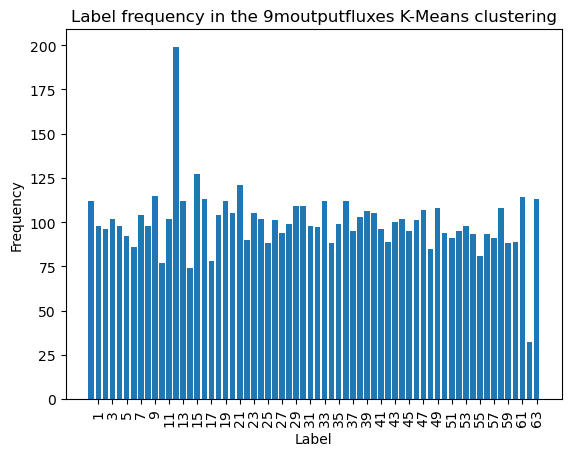

In [73]:
plot_cluster_labels_count(flux_kmeans_labels_9m, 
                          'K-Means',
                          '9moutputfluxes')

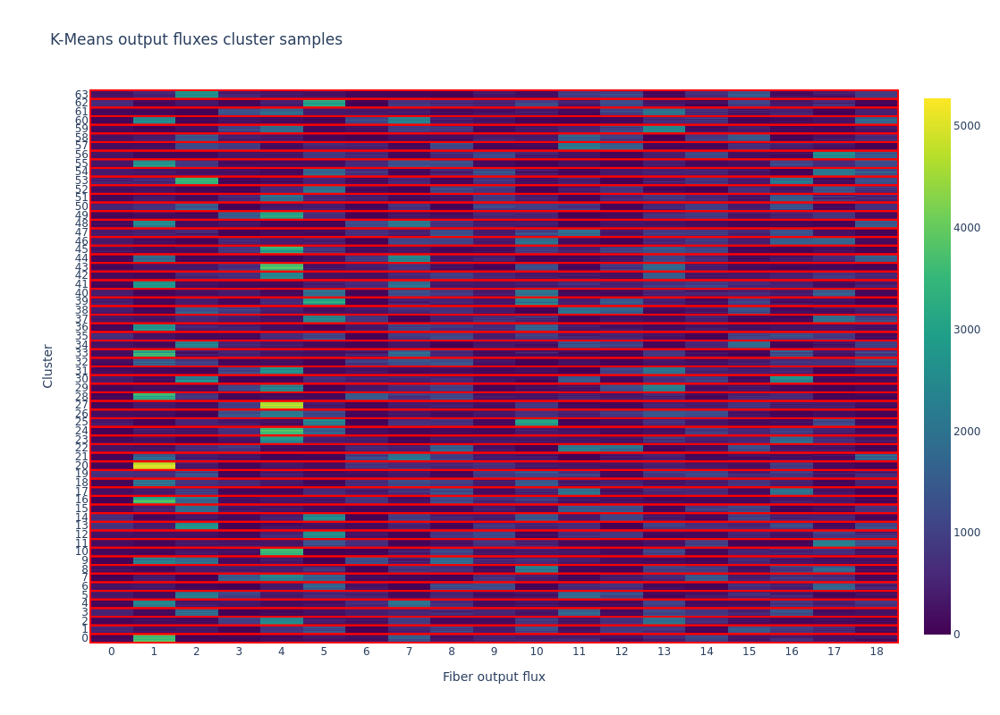

In [74]:
plot_grid_clusters(
    output_fluxes_9m,
    flux_kmeans_labels_9m,
    [n for n in range(0, 64)],
    "K-Means output fluxes cluster samples",
    "Fiber output flux",
    "Cluster",
    1,
    '9moutputfluxes',
    'K-Means'
    )

### DBSCAN

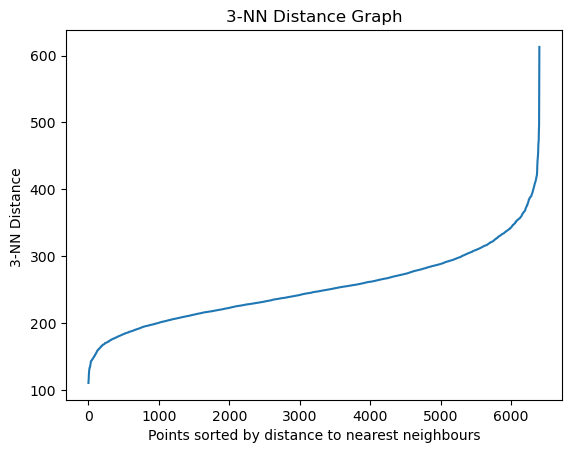

Number of clusters: 64
Numbers that are not noise: 6372


array([ 0,  1,  2, ..., 51, 55, 60])

In [96]:
n_neighbours = 3
plot_kneighbours(output_fluxes_9m, n_neighbours)
epsilon = 400
dbscan = DBSCAN(eps=epsilon, min_samples=n_neighbours)
flux_dbscan_labels_9m = dbscan.fit_predict(output_fluxes_9m)
get_number_of_clusters(flux_dbscan_labels_9m)

The most repeated label is 36 with 127 occurrences.
The least repeated label is 23 with 76 occurrence.
Cluster density mean: 99.5625
Cluster density variance: 9.872428462642816


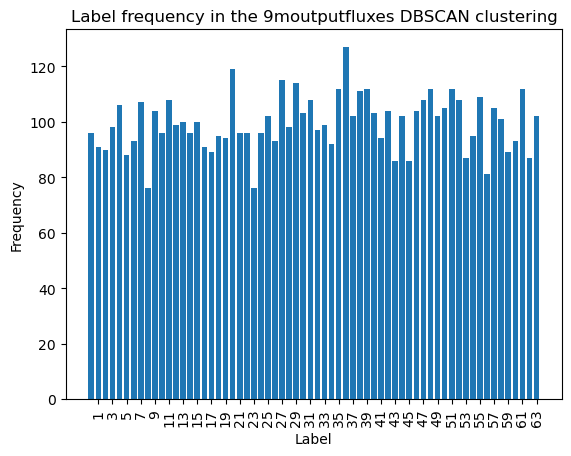

In [97]:
plot_cluster_labels_count(flux_dbscan_labels_9m, 
                          'DBSCAN', 
                          '9moutputfluxes')

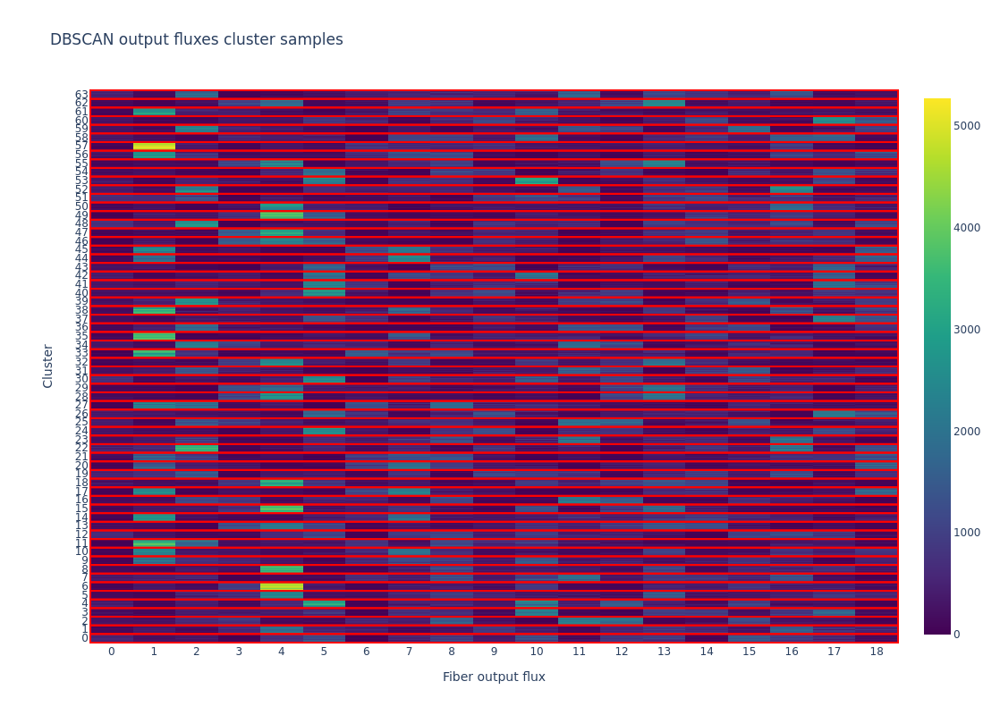

In [98]:
plot_grid_clusters(
    output_fluxes_9m,
    flux_dbscan_labels_9m,
    [n for n in range(0, 64)],
    "DBSCAN output fluxes cluster samples",
    "Fiber output flux",
    "Cluster",
    1,
    '9moutputfluxes',
    'DBSCAN'
    )

### HDBSCAN

In [103]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=10)
flux_hdbscan_labels_9m = clusterer.fit_predict(output_fluxes_9m)

The most repeated label is 26 with 127 occurrences.
The least repeated label is 18 with 77 occurrence.
Cluster density mean: 99.515625
Cluster density variance: 9.921555112953564


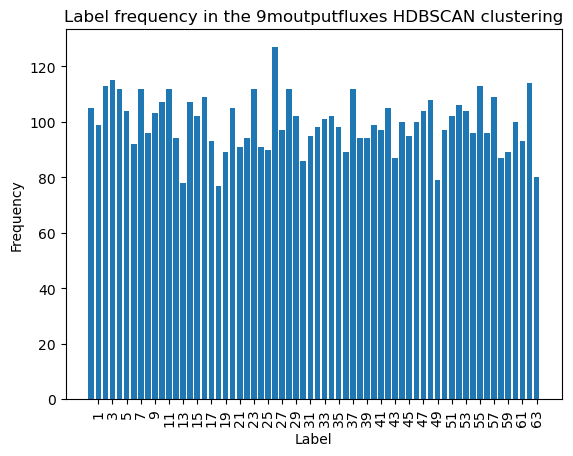

In [104]:
plot_cluster_labels_count(flux_hdbscan_labels_9m, 
                          'HDBSCAN',
                          '9moutputfluxes')

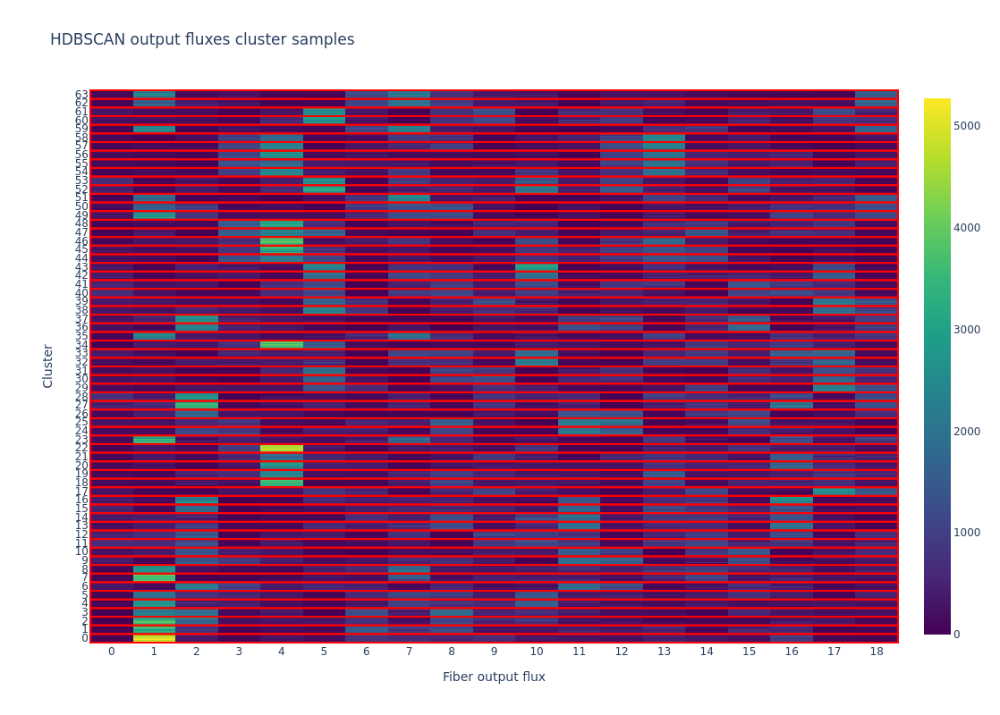

In [105]:
plot_grid_clusters(
    output_fluxes_9m,
    flux_hdbscan_labels_9m,
    [n for n in range(0, 64)],
    "HDBSCAN output fluxes cluster samples",
    "Fiber output flux",
    "Cluster",
    1,
    '9moutputfluxes',
    'HDBSCAN'
    )

### Agglomerative clustering

In [106]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=64)
flux_agglomerative_labels_9m = agglomerativeclustering.fit_predict(output_fluxes_9m)

The most repeated label is 14 with 127 occurrences.
The least repeated label is 60 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


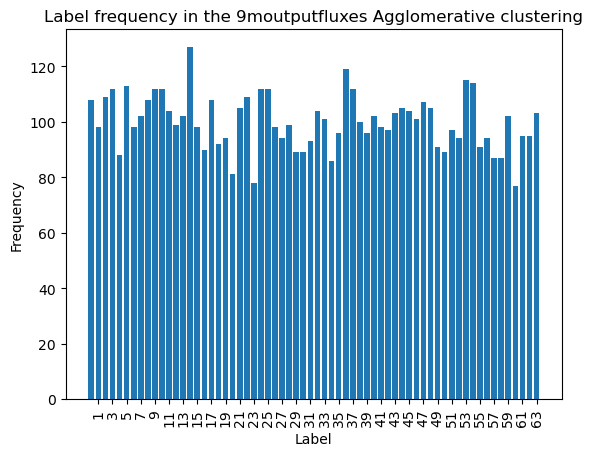

In [107]:
plot_cluster_labels_count(flux_agglomerative_labels_9m, 
                          'Agglomerative',
                          '9moutputfluxes')

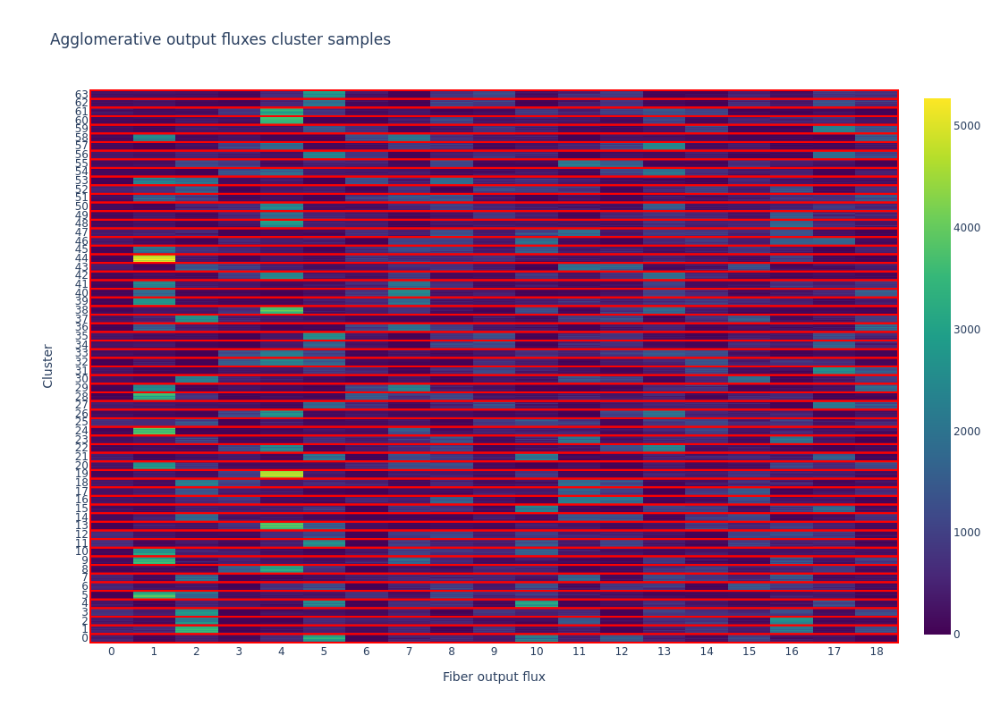

In [108]:
plot_grid_clusters(
    output_fluxes_9m,
    flux_agglomerative_labels_9m,
    [n for n in range(0, 64)],
    "Agglomerative output fluxes cluster samples",
    "Fiber output flux",
    "Cluster",
    1,
    '9moutputfluxes',
    'Agglomerative'
    )

In [109]:
print(normalized_mutual_info_score(flux_kmeans_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(flux_dbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(flux_hdbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(flux_agglomerative_labels_9m, zernike_original_labels_9m))
print()

print(normalized_mutual_info_score(flux_dbscan_labels_9m, flux_kmeans_labels_9m))
print(normalized_mutual_info_score(flux_hdbscan_labels_9m, flux_kmeans_labels_9m))
print(normalized_mutual_info_score(flux_agglomerative_labels_9m, flux_kmeans_labels_9m))
print()

print(normalized_mutual_info_score(flux_hdbscan_labels_9m, flux_dbscan_labels_9m))
print(normalized_mutual_info_score(flux_agglomerative_labels_9m, flux_dbscan_labels_9m))
print()

print(normalized_mutual_info_score(flux_agglomerative_labels_9m, flux_hdbscan_labels_9m))

0.9949004198497517
0.9958734308677916
0.9959735378242598
1.0

0.9909764896875293
0.9913918232875879
0.994900419849752

0.9931972872651219
0.9958734308677916

0.9959735378242598


# Clustering PCA PSF Intensities

In [112]:
pca_intensities_9m = np.load(minidataset_9m_dict['pca_intensities_path'])

The most repeated label is 26 with 127 occurrences.
The least repeated label is 14 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


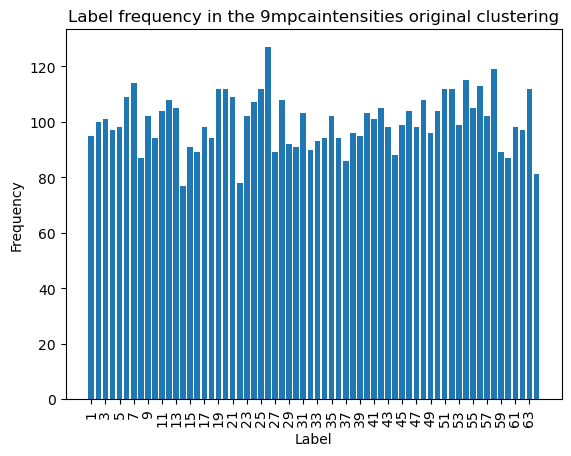

In [113]:
plot_cluster_labels_count(zernike_original_labels_9m, 
                          'original',
                          '9mpcaintensities')

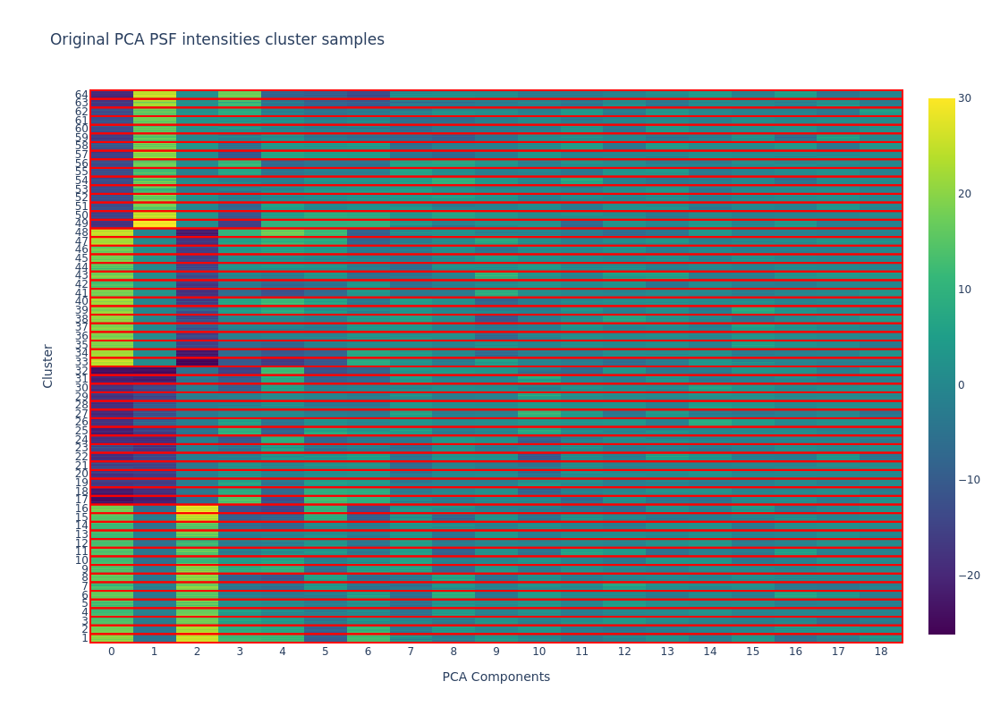

In [114]:
plot_grid_clusters(
    pca_intensities_9m,
    zernike_original_labels_9m,
    [n for n in range(1, 65)],
    "Original PCA PSF intensities cluster samples",
    "PCA Components",
    "Cluster",
    1,
    '9mpcaintensities',
    'original'
    )

### K-Means

In [115]:
kmeans = KMeans(n_clusters=64,
                n_init=100)
pca_intensities_kmeans_labels_9m = kmeans.fit_predict(pca_intensities_9m)

The most repeated label is 47 with 127 occurrences.
The least repeated label is 13 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


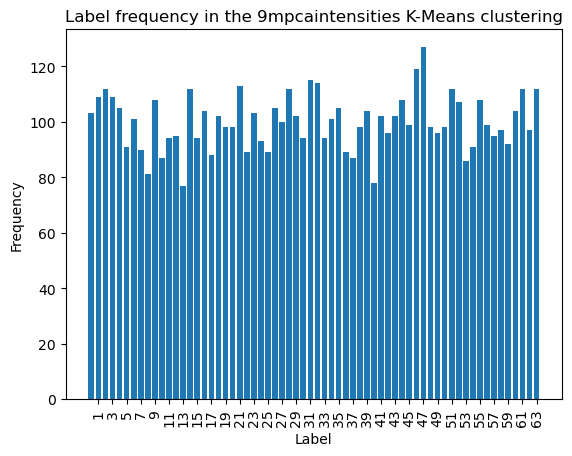

In [116]:
plot_cluster_labels_count(pca_intensities_kmeans_labels_9m, 
                          'K-Means',
                          '9mpcaintensities')

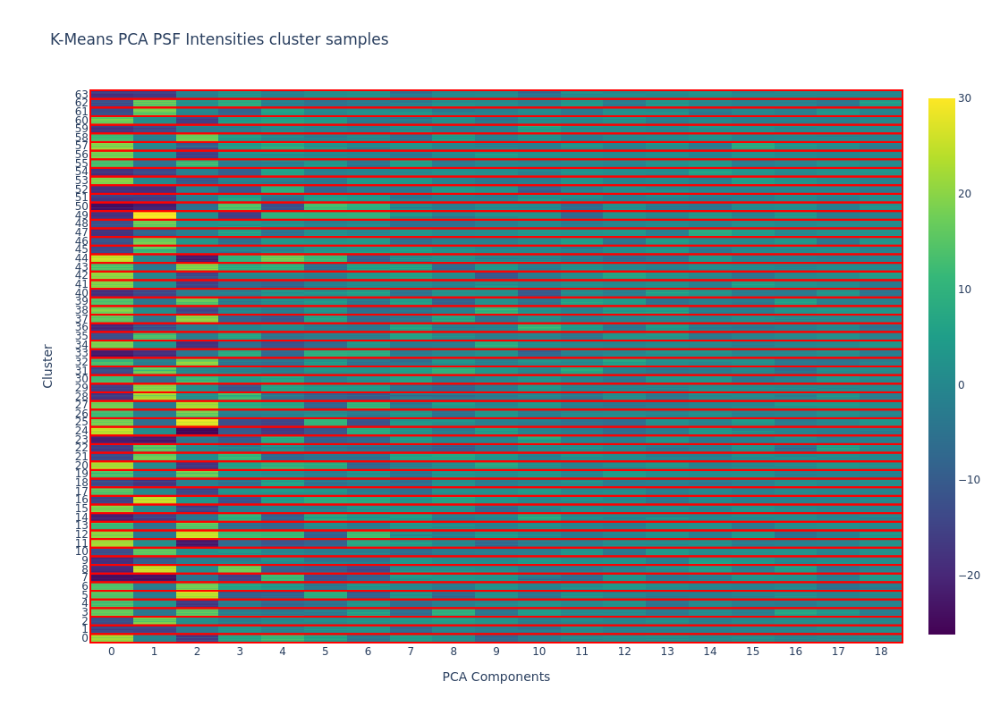

In [117]:
plot_grid_clusters(
    pca_intensities_9m,
    pca_intensities_kmeans_labels_9m,
    [n for n in range(0, 64)],
    "K-Means PCA PSF Intensities cluster samples",
    "PCA Components",
    "Cluster",
    1,
    '9mpcaintensities',
    'K-Means'
    )

### DBSCAN

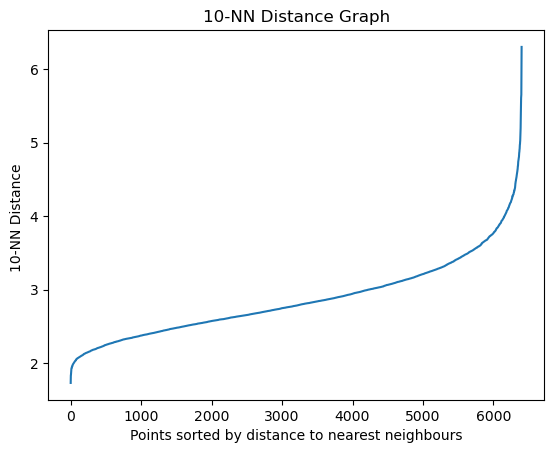

Number of clusters: 64
Numbers that are not noise: 6394


array([ 0,  1,  2, ..., 46, 51, 58])

In [122]:
n_neighbours = 10
plot_kneighbours(pca_intensities_9m, n_neighbours)
epsilon = 4
dbscan = DBSCAN(eps=epsilon, min_samples=n_neighbours)
pca_intensities_dbscan_labels_9m = dbscan.fit_predict(pca_intensities_9m)
get_number_of_clusters(pca_intensities_dbscan_labels_9m)

The most repeated label is 31 with 127 occurrences.
The least repeated label is 8 with 77 occurrence.
Cluster density mean: 99.90625
Cluster density variance: 9.800699512662348


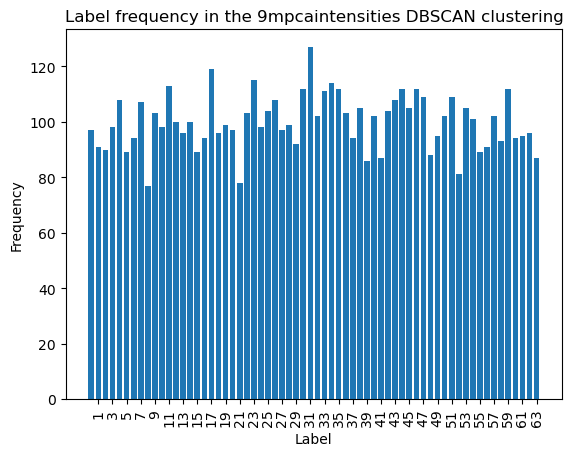

In [123]:
plot_cluster_labels_count(pca_intensities_dbscan_labels_9m, 
                          'DBSCAN', 
                          '9mpcaintensities')

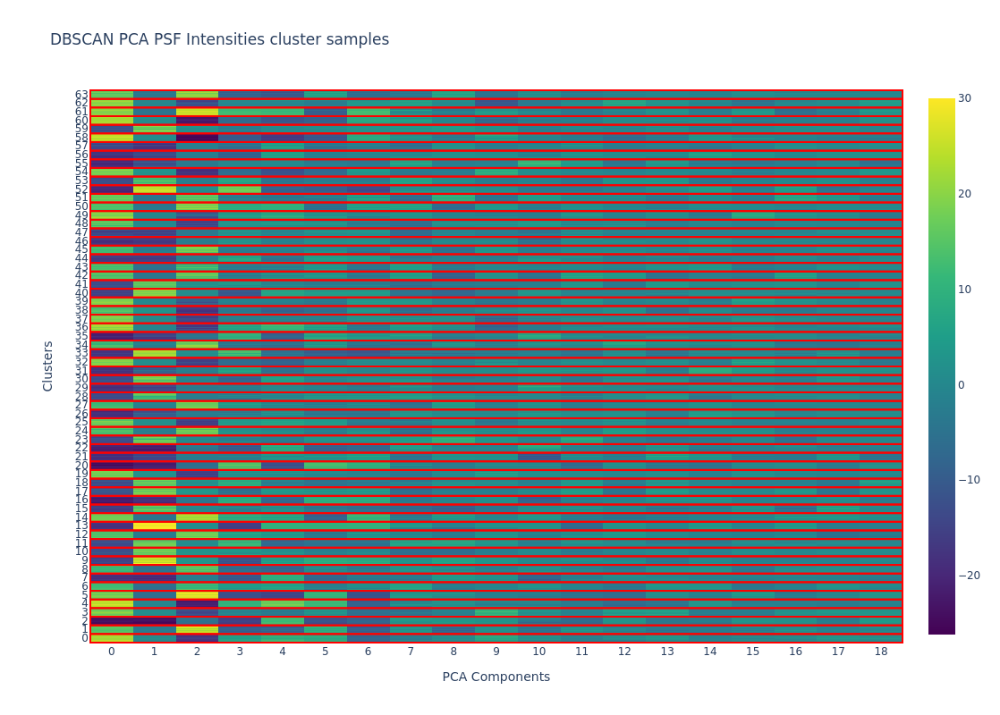

In [124]:
plot_grid_clusters(
    pca_intensities_9m,
    pca_intensities_dbscan_labels_9m,
    [n for n in range(0, 64)],
    "DBSCAN PCA PSF Intensities cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '9mpcaintensities',
    'DBSCAN'
    )

### HDBSCAN

In [125]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=15)
pca_intensities_hdbscan_labels_9m = clusterer.fit_predict(pca_intensities_9m)

The most repeated label is 56 with 127 occurrences.
The least repeated label is 49 with 77 occurrence.
Cluster density mean: 99.875
Cluster density variance: 9.82264602843857


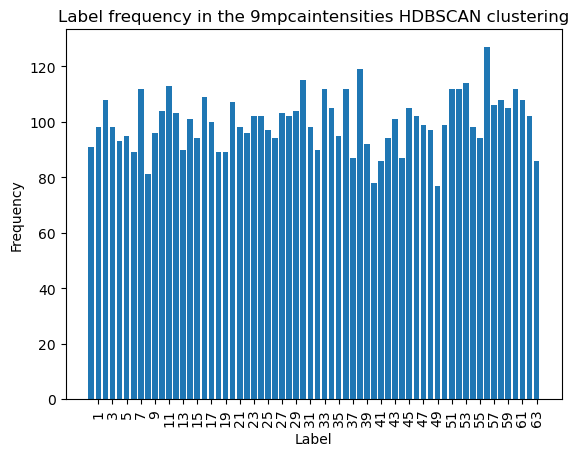

In [126]:
plot_cluster_labels_count(pca_intensities_hdbscan_labels_9m, 
                          'HDBSCAN', 
                          '9mpcaintensities')

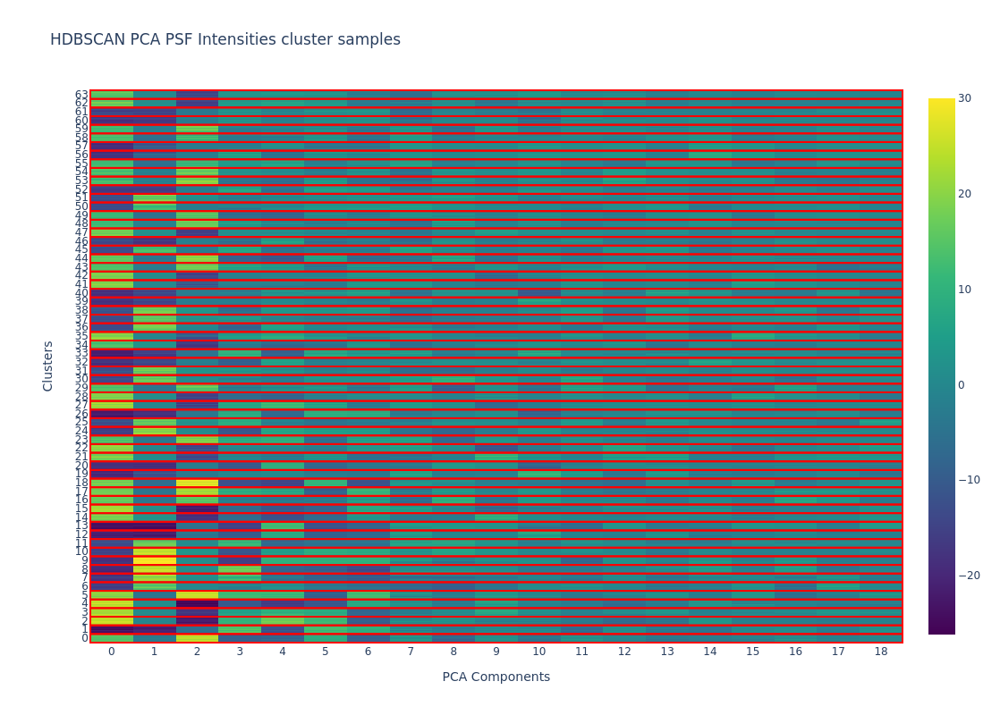

In [127]:
plot_grid_clusters(
    pca_intensities_9m,
    pca_intensities_hdbscan_labels_9m,
    [n for n in range(0, 64)],
    "HDBSCAN PCA PSF Intensities cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '9mpcaintensities',
    'HDBSCAN'
    )

### Agglomerative clustering

In [130]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=64)
pca_intensities_agglomerative_labels_9m = agglomerativeclustering.fit_predict(pca_intensities_9m)

The most repeated label is 1 with 127 occurrences.
The least repeated label is 56 with 77 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.812300953395182


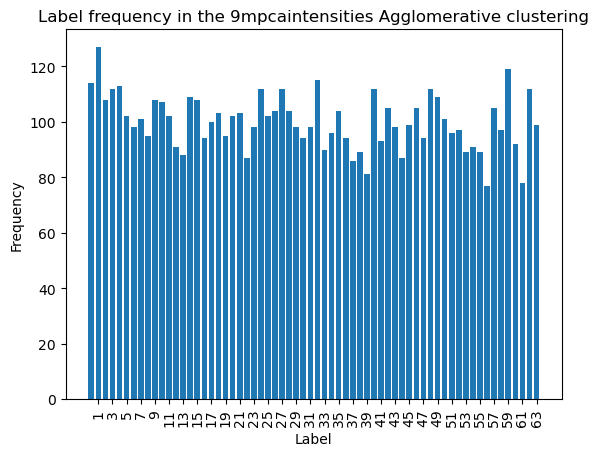

In [131]:
plot_cluster_labels_count(pca_intensities_agglomerative_labels_9m, 
                          'Agglomerative',
                          '9mpcaintensities')

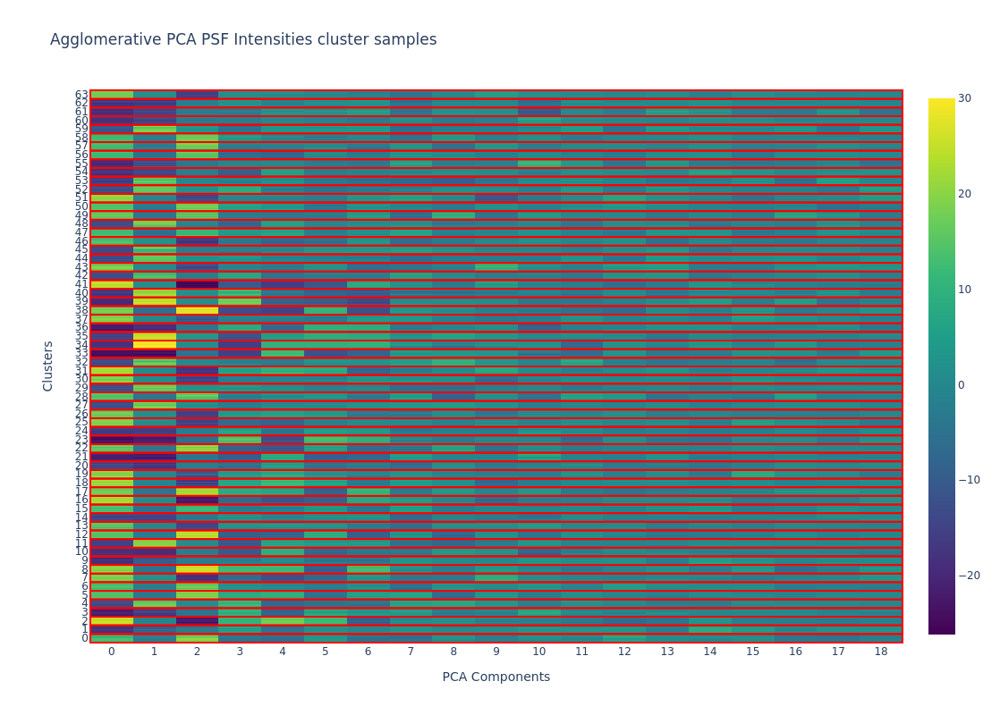

In [134]:
plot_grid_clusters(
    pca_intensities_9m,
    pca_intensities_agglomerative_labels_9m,
    [n for n in range(0, 64)],
    "Agglomerative PCA PSF Intensities cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '9mpcaintensities',
    'Agglomerative'
    )

In [135]:
print(normalized_mutual_info_score(pca_intensities_kmeans_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(pca_intensities_dbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(pca_intensities_hdbscan_labels_9m, zernike_original_labels_9m))
print(normalized_mutual_info_score(pca_intensities_agglomerative_labels_9m, zernike_original_labels_9m))
print()

print(normalized_mutual_info_score(pca_intensities_dbscan_labels_9m, pca_intensities_kmeans_labels_9m))
print(normalized_mutual_info_score(pca_intensities_hdbscan_labels_9m, pca_intensities_kmeans_labels_9m))
print(normalized_mutual_info_score(pca_intensities_agglomerative_labels_9m, pca_intensities_kmeans_labels_9m))

print()
print(normalized_mutual_info_score(pca_intensities_hdbscan_labels_9m, pca_intensities_dbscan_labels_9m))
print(normalized_mutual_info_score(pca_intensities_agglomerative_labels_9m, pca_intensities_dbscan_labels_9m))

print()
print(normalized_mutual_info_score(pca_intensities_agglomerative_labels_9m, pca_intensities_hdbscan_labels_9m))

1.0
0.9991645135034621
0.9990026930902886
1.0

0.9991645135034619
0.9990026930902883
0.9999999999999998

0.9981680776592965
0.9991645135034624

0.9990026930902886


# Clustering PCA Zernike coefficients

In [6]:
pca_zernike_coefficients_5m = np.load(minidataset_5m_dict['pca_zernike_mode_coefficients_path'])

The most repeated label is 31 with 124 occurrences.
The least repeated label is 5 with 82 occurrence.
Cluster density mean: 100.0
Cluster density variance: 9.496709956611289


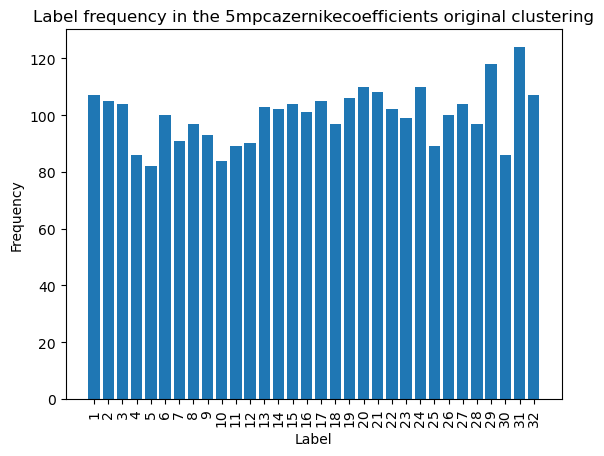

In [7]:
plot_cluster_labels_count(zernike_original_labels_5m, 
                          'original',
                          '5mpcazernikecoefficients')

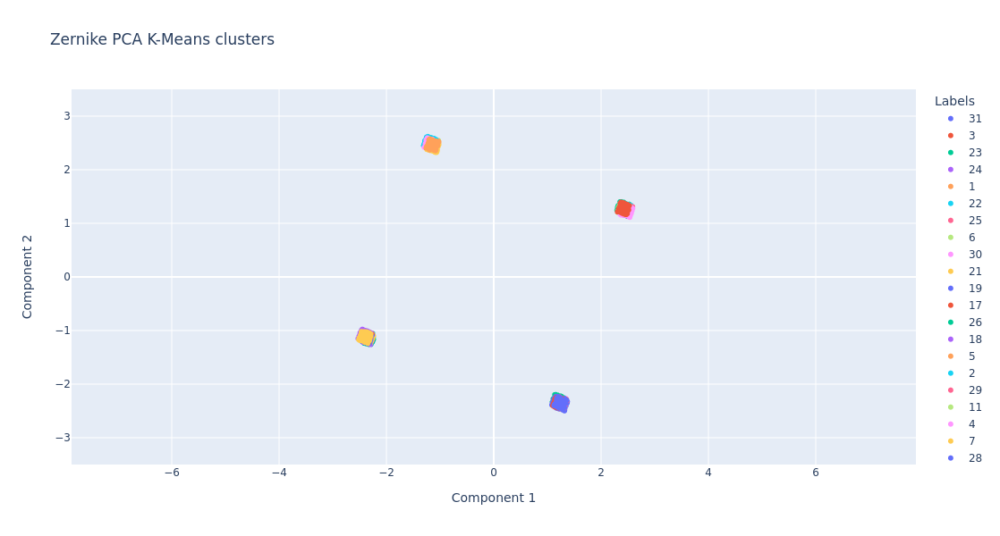

In [40]:
plot_clusters_from_labels(pca_zernike_coefficients_5m,
                          zernike_original_labels_5m,
                          'Zernike PCA K-Means clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcazernikecoefficients',
                          'original',
                          axis_range=[-3.5, 3.5])

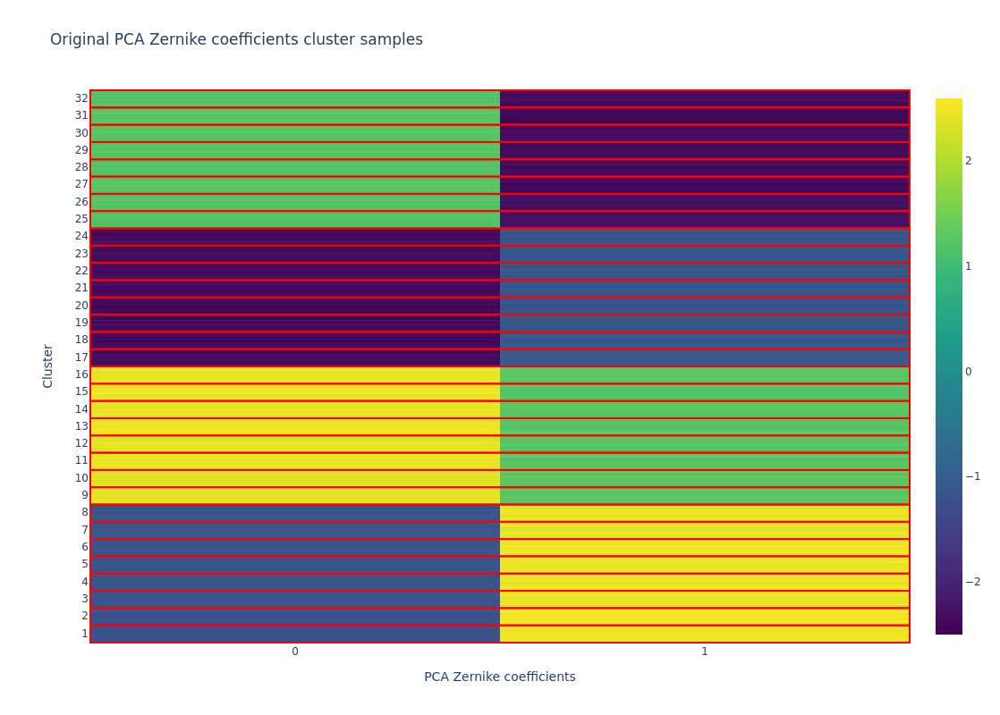

In [42]:
plot_grid_clusters(
    pca_zernike_coefficients_5m,
    zernike_original_labels_5m,
    [n for n in range(1,33)],
    "Original PCA Zernike coefficients cluster samples",
    "PCA Zernike coefficients",
    "Cluster",
    1,
    '5mpcazernikecoefficients',
    'original'
    )

### K-Means

In [43]:
kmeans = KMeans(n_clusters=32,
                n_init=100)
pca_zernike_kmeans_labels_5m = kmeans.fit_predict(pca_zernike_coefficients_5m)

The most repeated label is 2 with 135 occurrences.
The least repeated label is 27 with 61 occurrence.
Cluster density mean: 100.0
Cluster density variance: 19.586347285800894


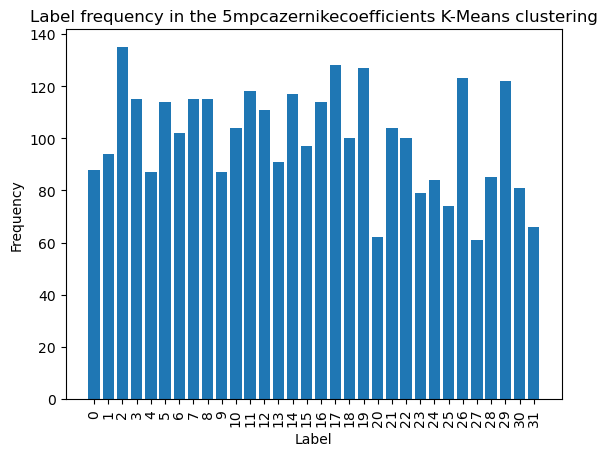

In [44]:
plot_cluster_labels_count(pca_zernike_kmeans_labels_5m, 
                          'K-Means',
                          '5mpcazernikecoefficients')

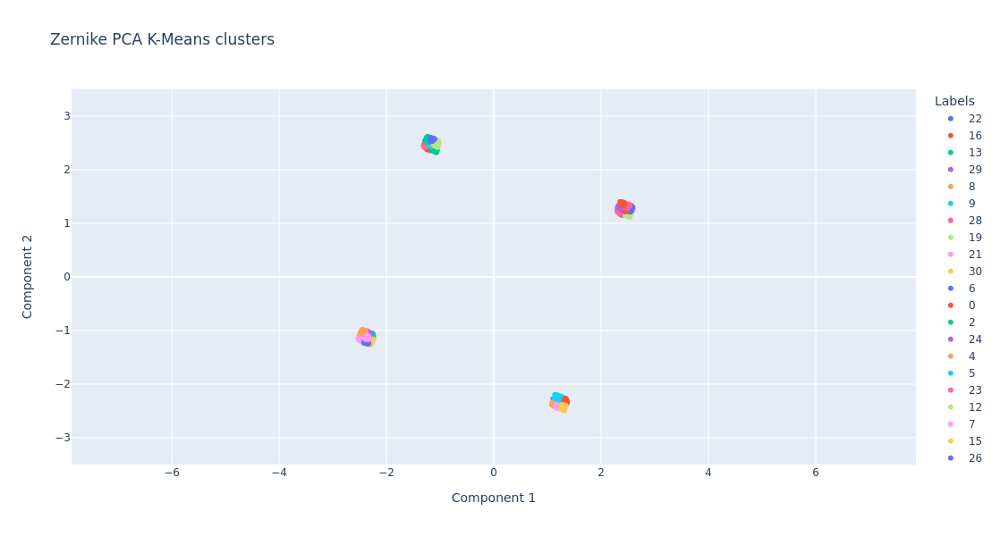

In [45]:
plot_clusters_from_labels(pca_zernike_coefficients_5m,
                          pca_zernike_kmeans_labels_5m,
                          'Zernike PCA K-Means clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcazernikecoefficients',
                          'K-Means',
                          axis_range=[-3.5, 3.5])

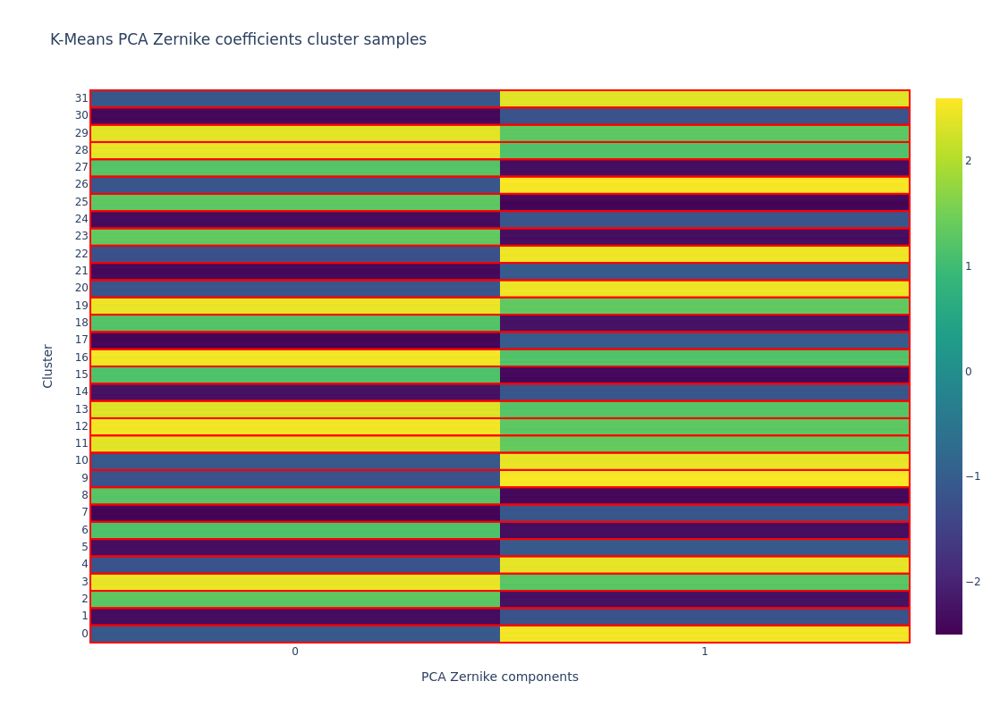

In [46]:
plot_grid_clusters(
    pca_zernike_coefficients_5m,
    pca_zernike_hdbscan_labels_5m,
    [n for n in range(0,32)],
    "K-Means PCA Zernike coefficients cluster samples",
    "PCA Zernike components",
    "Cluster",
    1,
    '5mpcazernikecoefficients',
    'K-Means'
    )

### DBSCAN

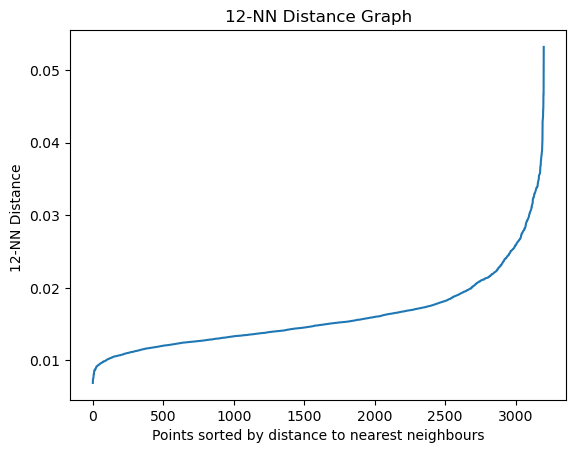

Number of clusters: 4
Numbers that are not noise: 3200


array([0, 1, 2, ..., 1, 1, 1])

In [56]:
n_neighbours = 12
plot_kneighbours(pca_zernike_coefficients_5m, n_neighbours)
epsilon = 0.03

dbscan = DBSCAN(eps=epsilon, min_samples=n_neighbours)
pca_zernike_dbscan_labels_5m = dbscan.fit_predict(pca_zernike_coefficients_5m)
get_number_of_clusters(pca_zernike_dbscan_labels_5m)

The most repeated label is 2 with 837 occurrences.
The least repeated label is 3 with 766 occurrence.
Cluster density mean: 800.0
Cluster density variance: 31.36080356113344


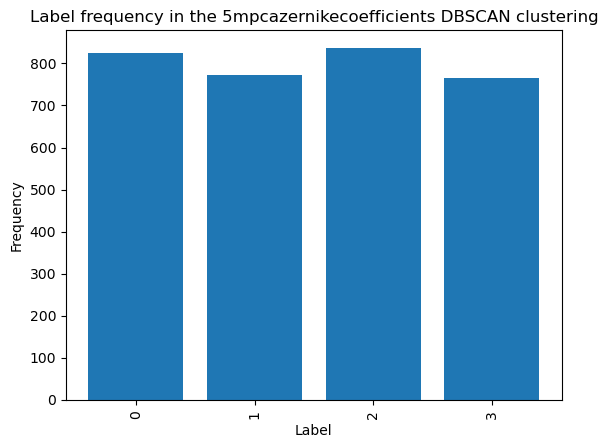

In [57]:
plot_cluster_labels_count(pca_zernike_dbscan_labels_5m, 
                          'DBSCAN', 
                          '5mpcazernikecoefficients')

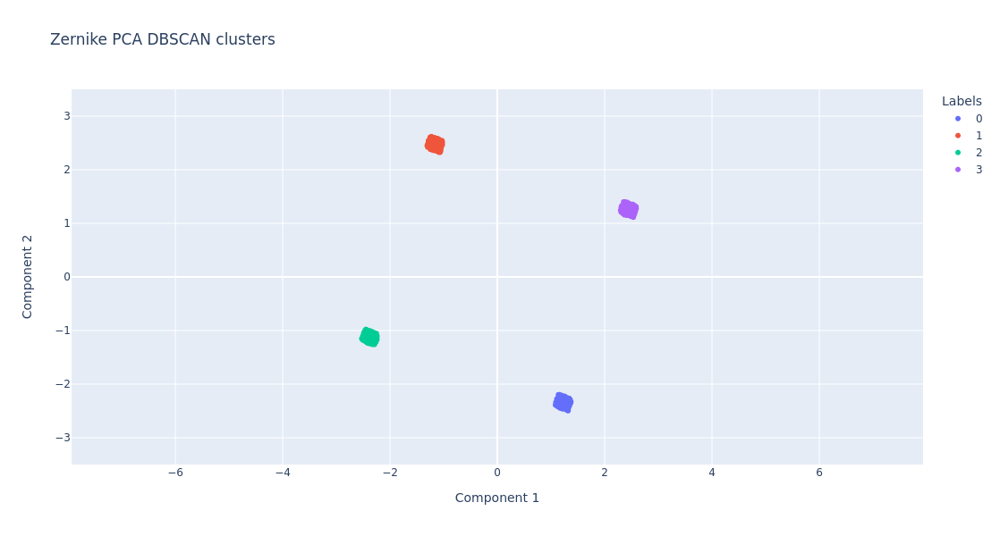

In [77]:
plot_clusters_from_labels(pca_zernike_coefficients_5m,
                          pca_zernike_dbscan_labels_5m,
                          'Zernike PCA DBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcazernikecoefficients',
                          'DBSCAN',
                          axis_range=[-3.5, 3.5])

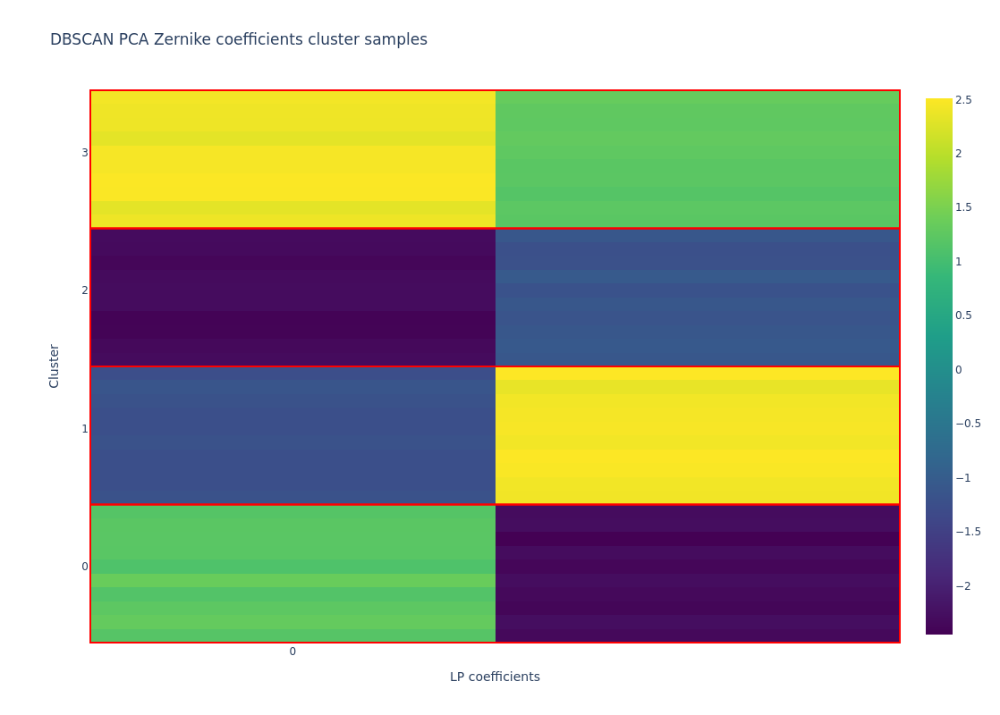

In [78]:
plot_grid_clusters(
    pca_zernike_coefficients_5m,
    pca_zernike_dbscan_labels_5m,
    [n for n in range(0,32)],
    "DBSCAN PCA Zernike coefficients cluster samples",
    "LP coefficients",
    "Cluster",
    19,
    '5mpcazernikecoefficients',
    'DBSCAN'
    )

### HDBSCAN

In [79]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=21)
lp_hdbscan_labels_5m = clusterer.fit_predict(pca_zernike_coefficients_5m)

The most repeated label is 8 with 140 occurrences.
The least repeated label is 11 with 47 occurrence.
Cluster density mean: 100.0
Cluster density variance: 22.481937194112078


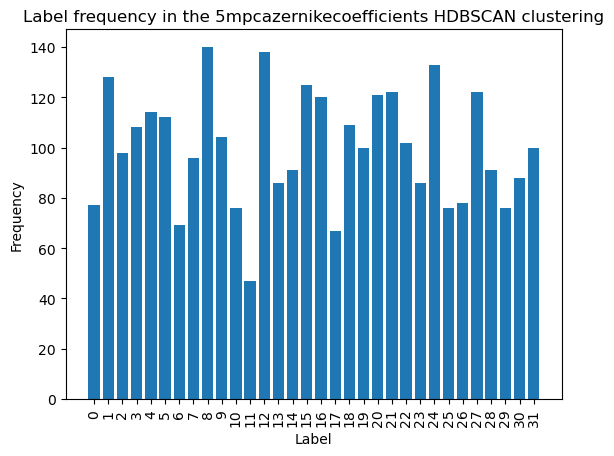

In [80]:
plot_cluster_labels_count(pca_zernike_hdbscan_labels_5m, 
                          'HDBSCAN', 
                          '5mpcazernikecoefficients')

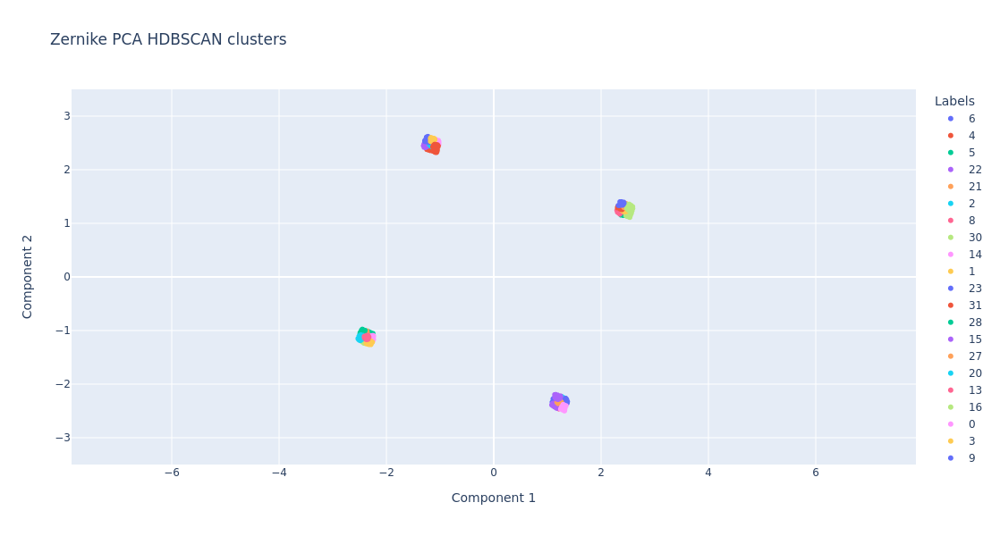

In [81]:
plot_clusters_from_labels(pca_zernike_coefficients_5m,
                          pca_zernike_hdbscan_labels_5m,
                          'Zernike PCA HDBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcazernikecoefficients',
                          'HDBSCAN',
                          axis_range=[-3.5, 3.5]
                          )

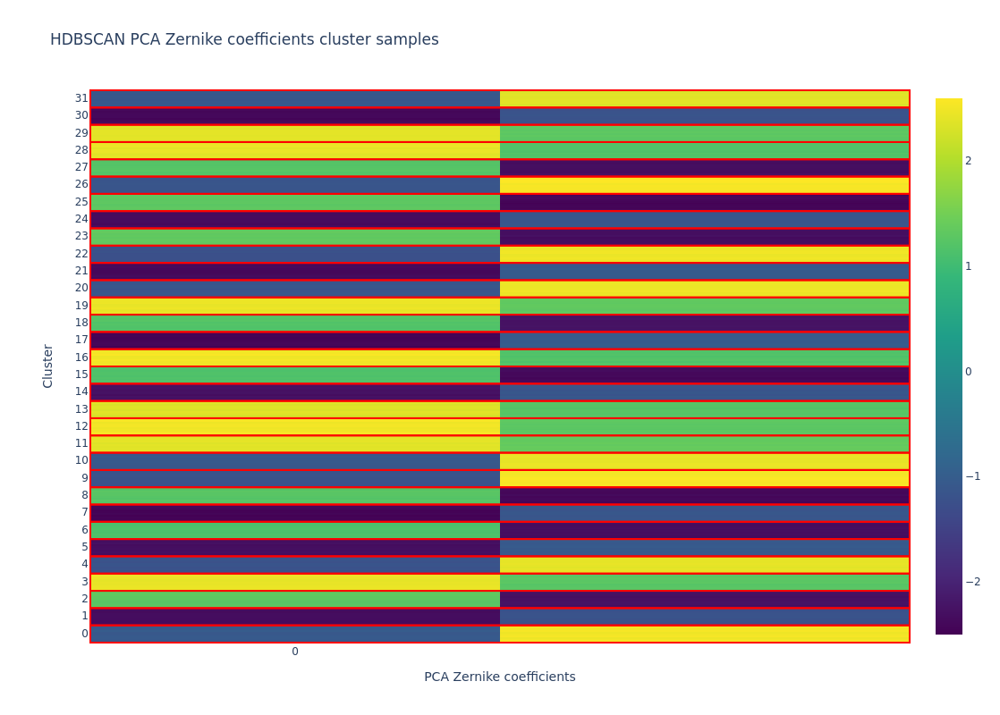

In [82]:
plot_grid_clusters(
    pca_zernike_coefficients_5m,
    pca_zernike_hdbscan_labels_5m,
    [n for n in range(0,32)],
    "HDBSCAN PCA Zernike coefficients cluster samples",
    "PCA Zernike coefficients",
    "Cluster",
    19,
    '5mpcazernikecoefficients',
    'HDBSCAN'
    )

### Agglomerative clustering

In [83]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=32)
pca_zernike_agglomerative_labels_5m = agglomerativeclustering.fit_predict(pca_zernike_coefficients_5m)

The most repeated label is 0 with 144 occurrences.
The least repeated label is 31 with 48 occurrence.
Cluster density mean: 100.0
Cluster density variance: 24.451482572637595


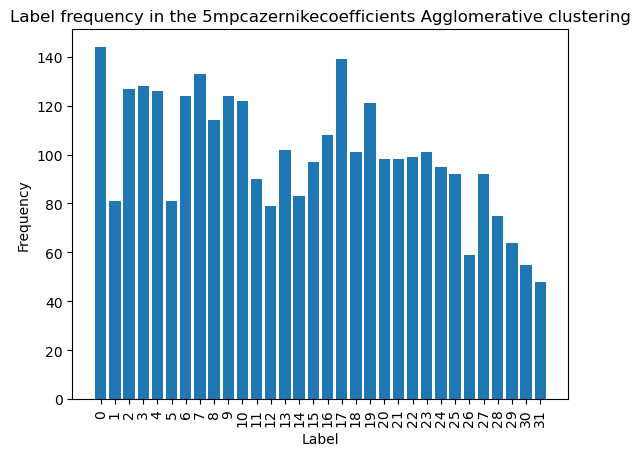

In [84]:
plot_cluster_labels_count(pca_zernike_agglomerative_labels_5m, 
                          'Agglomerative',
                          '5mpcazernikecoefficients')

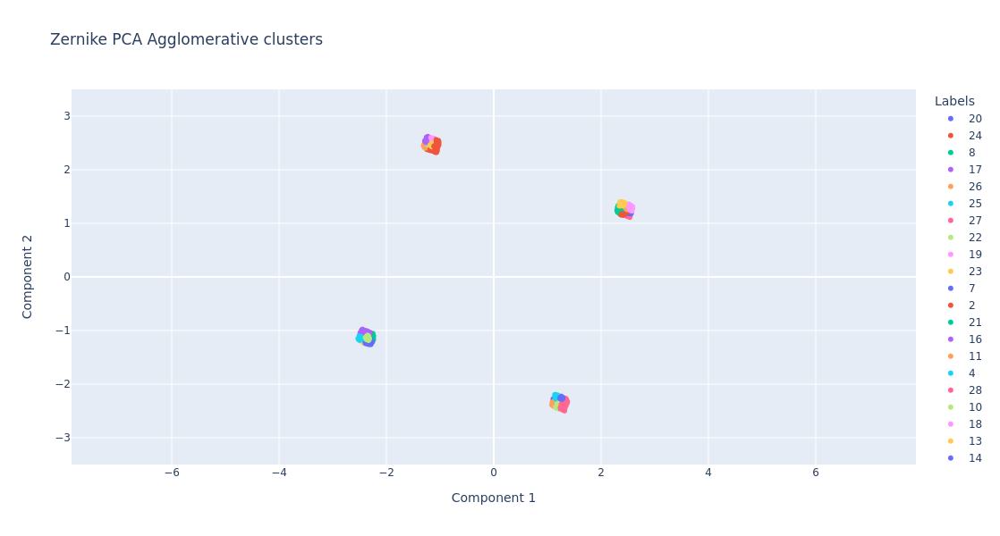

In [85]:
plot_clusters_from_labels(pca_zernike_coefficients_5m,
                          pca_zernike_agglomerative_labels_5m,
                          'Zernike PCA Agglomerative clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcazernikecoefficients',
                          'Agglomerative',
                          axis_range=[-3.5, 3.5]
                          )

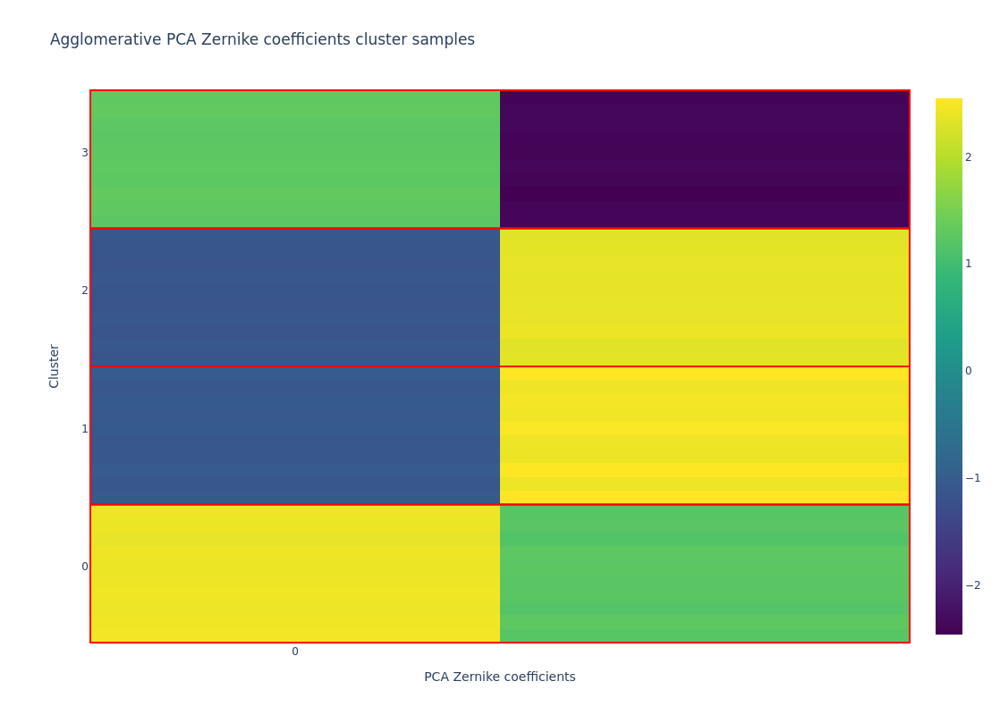

In [86]:
plot_grid_clusters(
    pca_zernike_coefficients_5m,
    pca_zernike_agglomerative_labels_5m,
    [0,1,2,3],
    "Agglomerative PCA Zernike coefficients cluster samples",
    "PCA Zernike coefficients",
    "Cluster",
    19,
    '5mpcazernikecoefficients',
    'Agglomerative'
    )

In [ ]:
print(normalized_mutual_info_score(pca_zernike_kmeans_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_zernike_dbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_zernike_hdbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_zernike_agglomerative_labels_5m, zernike_original_labels_5m))
print()

print(normalized_mutual_info_score(pca_zernike_dbscan_labels_5m, pca_zernike_kmeans_labels_5m))
print(normalized_mutual_info_score(pca_zernike_hdbscan_labels_5m, pca_zernike_kmeans_labels_5m))
print(normalized_mutual_info_score(pca_zernike_agglomerative_labels_5m, pca_zernike_kmeans_labels_5m))
print()

print(normalized_mutual_info_score(pca_zernike_hdbscan_labels_5m, pca_zernike_dbscan_labels_5m))
print(normalized_mutual_info_score(pca_zernike_agglomerative_labels_5m, pca_zernike_dbscan_labels_5m))
print()

print(normalized_mutual_info_score(pca_zernike_agglomerative_labels_5m, pca_zernike_hdbscan_labels_5m))

# Clustering PCA LP Coefficients

In [46]:
pca_lp_coefficients_5m = np.load(minidataset_5m_dict['pca_lp_modes_path'])

The most repeated label is 2 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


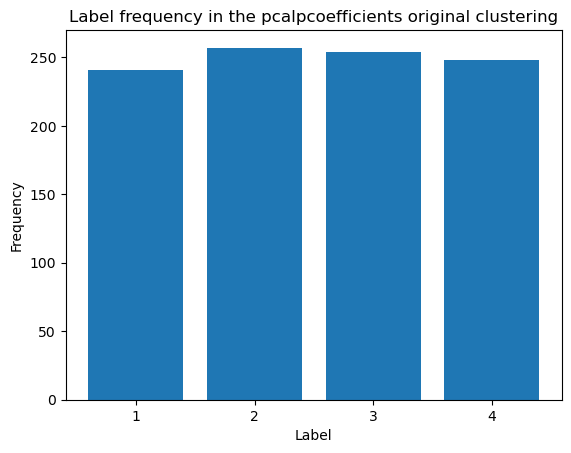

In [47]:
plot_cluster_labels_count(zernike_original_labels_5m, 
                          'original',
                          '5mpcalpcoefficients')

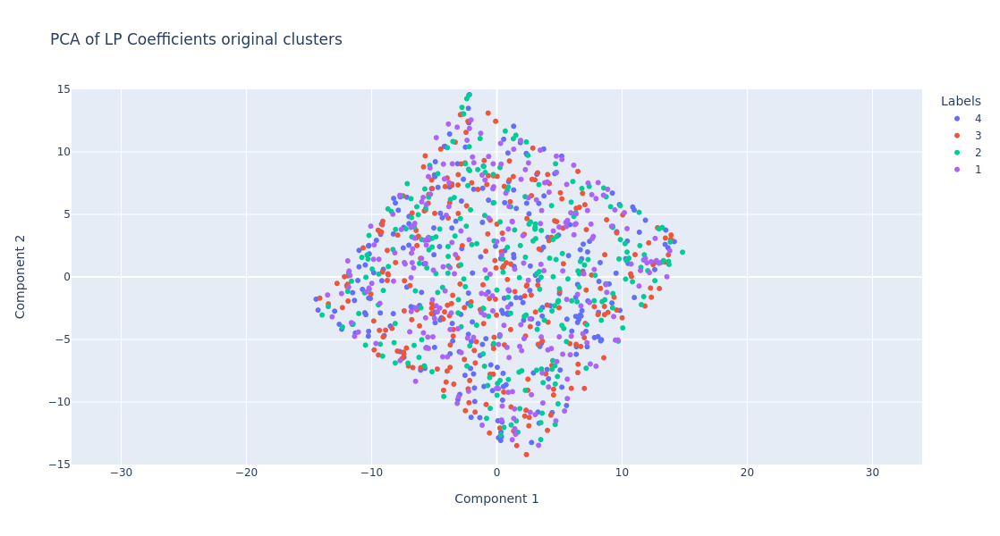

In [48]:
plot_clusters_from_labels(pca_lp_coefficients_5m,
                          zernike_original_labels_5m,
                          'PCA of LP Coefficients original clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcalpcoefficients',
                          'original',
                          axis_range=[-15, 15])

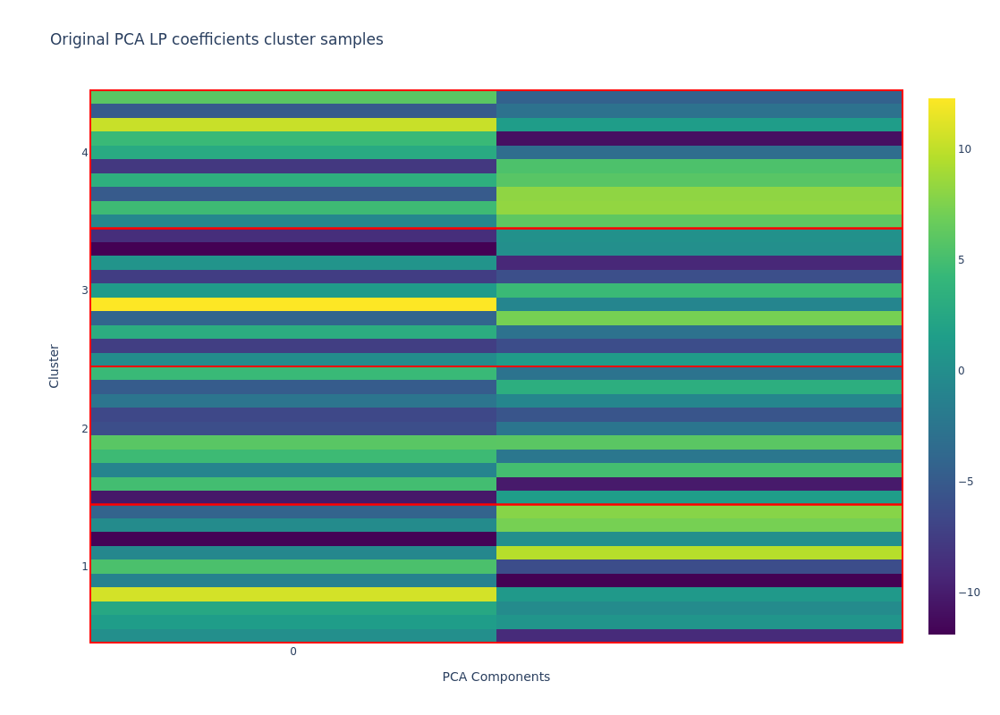

In [49]:
plot_grid_clusters(
    pca_lp_coefficients_5m,
    zernike_original_labels_5m,
    [1,2,3,4],
    "Original PCA LP coefficients cluster samples",
    "PCA Components",
    "Cluster",
    19,
    '5mpcalpcoefficients',
    'original'
    )

### K-Means

In [50]:
kmeans = KMeans(n_clusters=4,
                n_init=10)
pca_lp_kmeans_labels_5m = kmeans.fit_predict(pca_lp_coefficients_5m)

The most repeated label is 1 with 262 occurrences.
The least repeated label is 3 with 239 occurrence.
Cluster density mean: 250.0
Cluster density variance: 8.215838362577491


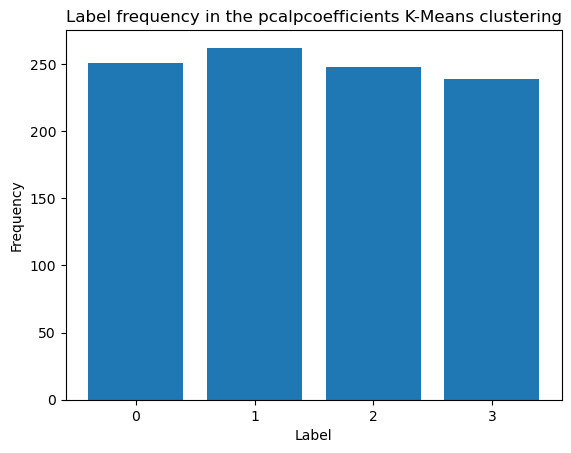

In [51]:
plot_cluster_labels_count(pca_lp_kmeans_labels_5m, 
                          'K-Means',
                          '5mpcalpcoefficients')

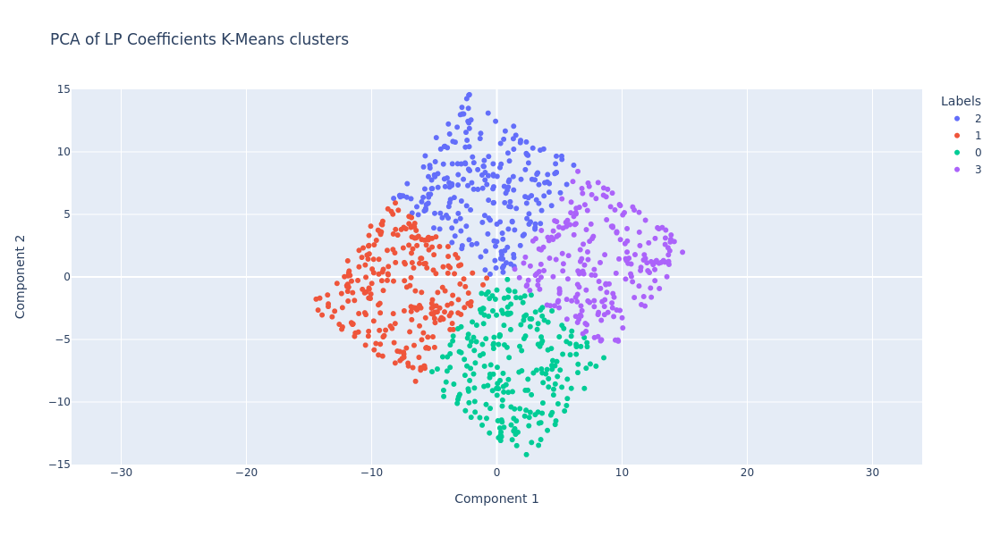

In [52]:
plot_clusters_from_labels(pca_lp_coefficients_5m,
                          pca_lp_kmeans_labels_5m,
                          'PCA of LP Coefficients K-Means clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcalpcoefficients',
                          'K-Means',
                          axis_range=[-15, 15])

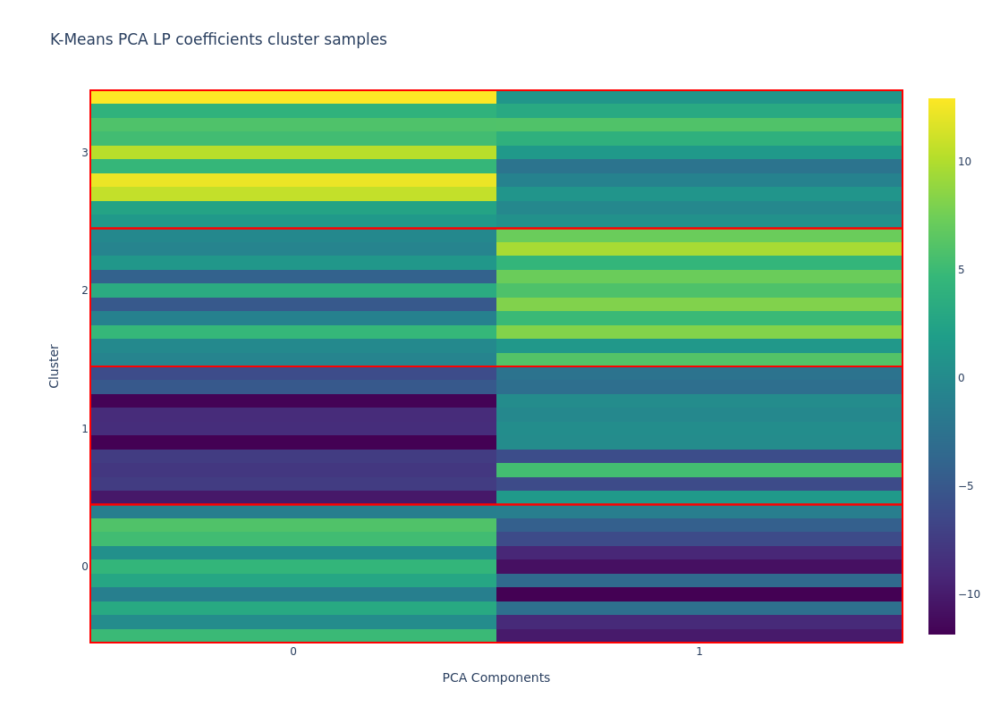

In [53]:
plot_grid_clusters(
    pca_lp_coefficients_5m,
    pca_lp_kmeans_labels_5m,
    [0,1,2,3],
    "K-Means PCA LP coefficients cluster samples",
    "PCA Components",
    "Cluster",
    1,
    '5mpcalpcoefficients',
    'K-Means'
    )

### DBSCAN

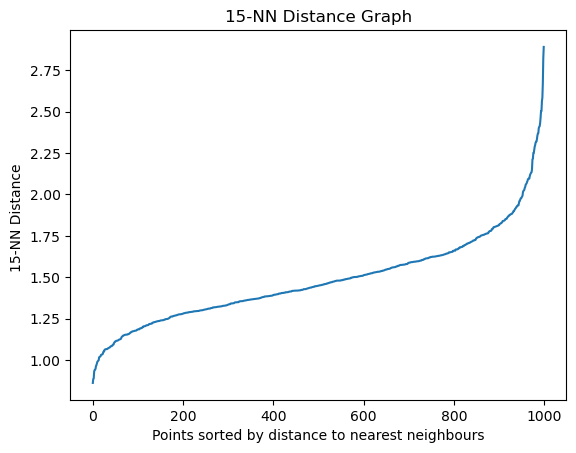

Number of clusters: 4
Numbers that are not noise: 953


In [54]:
n_neighbours = 15
plot_kneighbours(pca_lp_coefficients_5m, n_neighbours)
epsilon = 1.52
pca_lp_dbscan_labels_5m = get_number_of_clusters(pca_lp_coefficients_5m, epsilon, n_neighbours)

The most repeated label is 0 with 864 occurrences.
The least repeated label is 2 with 14 occurrence.
Cluster density mean: 238.25
Cluster density variance: 361.7543192554859


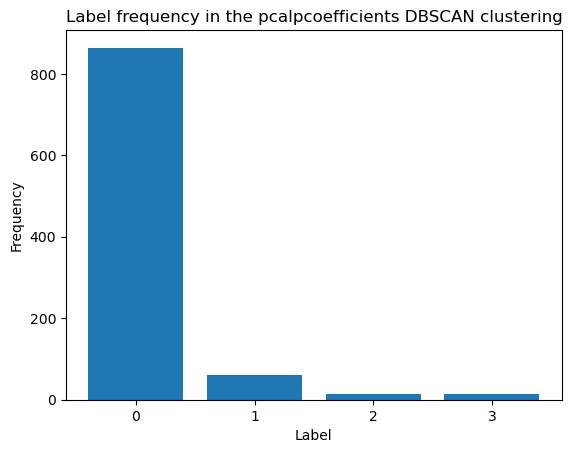

In [55]:
plot_cluster_labels_count(pca_lp_dbscan_labels_5m, 
                          'DBSCAN', 
                          '5mpcalpcoefficients')

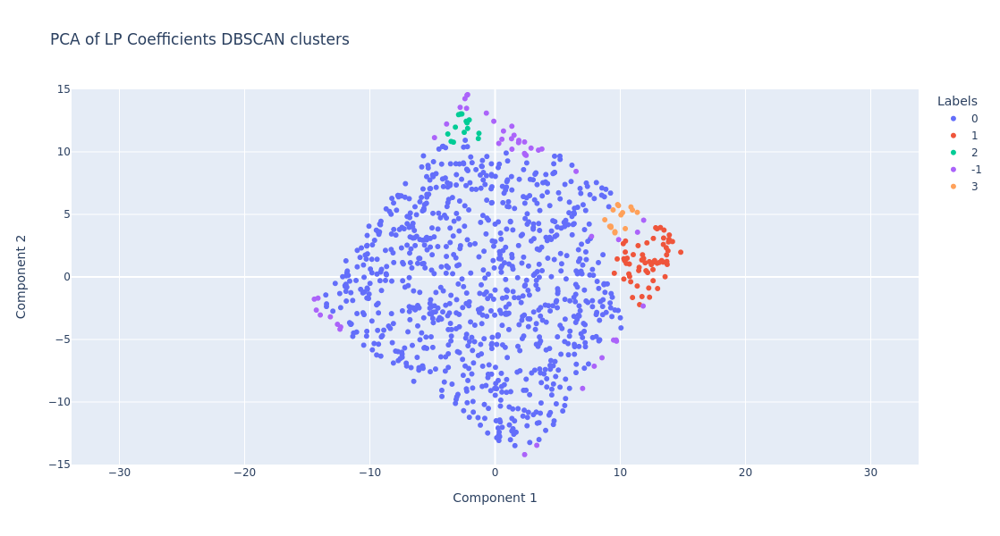

In [56]:
plot_clusters_from_labels(pca_lp_coefficients_5m,
                          pca_lp_dbscan_labels_5m,
                          'PCA of LP Coefficients DBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcalpcoefficients',
                          'DBSCAN',
                          axis_range=[-15, 15])

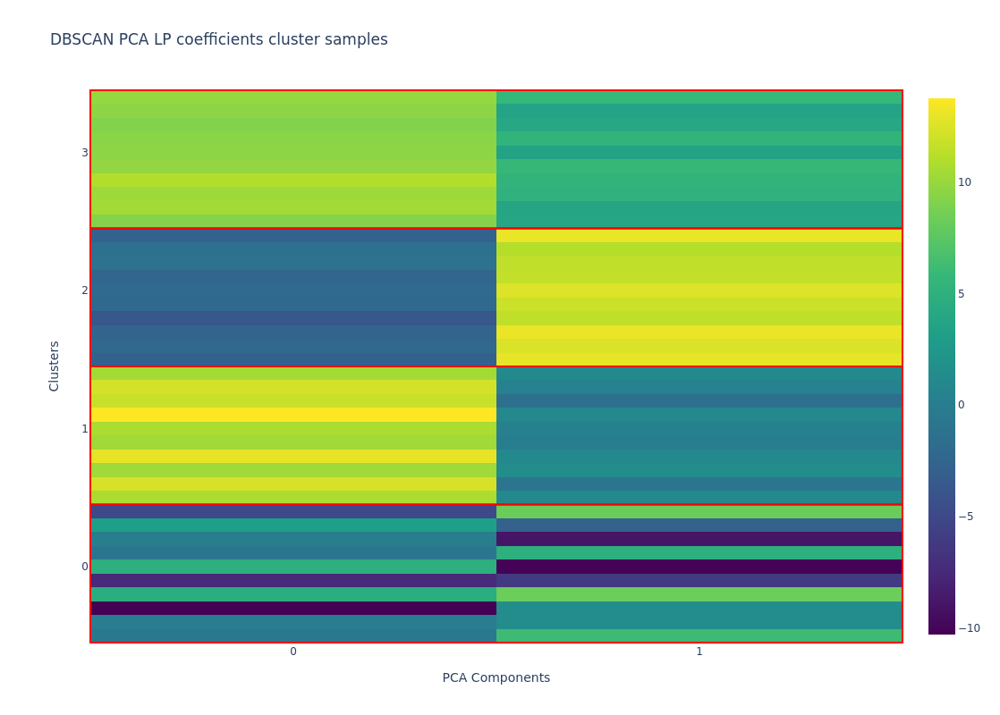

In [57]:
plot_grid_clusters(
    pca_lp_coefficients_5m,
    pca_lp_dbscan_labels_5m,
    [0,1,2,3],
    "DBSCAN PCA LP coefficients cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '5mpcalpcoefficients',
    'DBSCAN'
    )

### HDBSCAN

In [58]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=21)
pca_lp_hdbscan_labels_5m = clusterer.fit_predict(pca_lp_coefficients_5m)

The most repeated label is 2 with 227 occurrences.
The least repeated label is 3 with 28 occurrence.
Cluster density mean: 126.25
Cluster density variance: 91.17942476238814


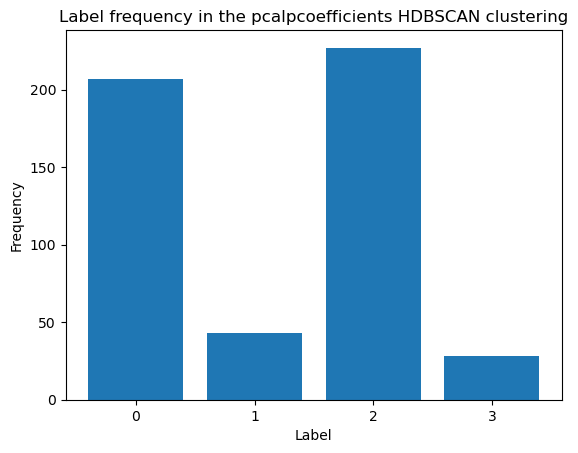

In [59]:
plot_cluster_labels_count(pca_lp_hdbscan_labels_5m, 
                          'HDBSCAN', 
                          '5mpcalpcoefficients')

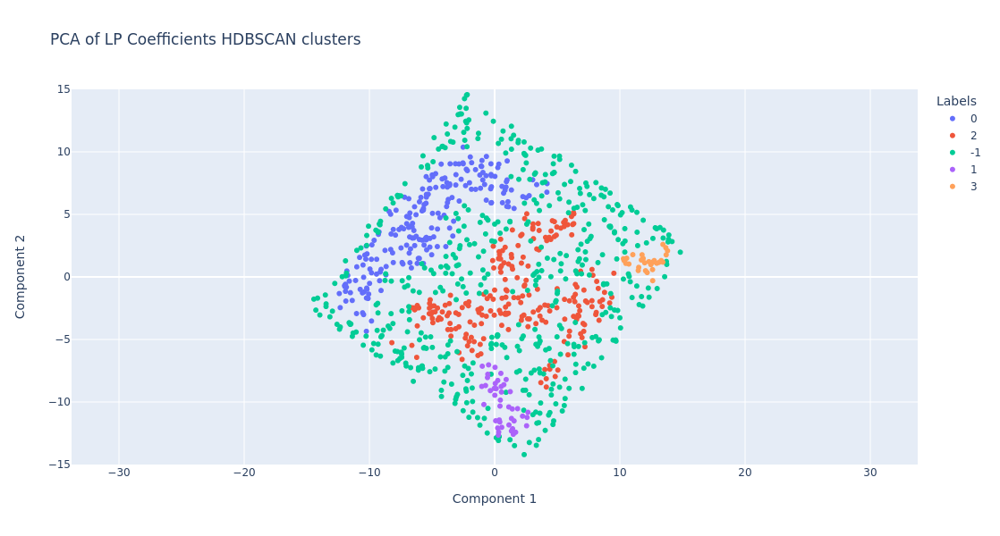

In [60]:
plot_clusters_from_labels(pca_lp_coefficients_5m,
                          pca_lp_hdbscan_labels_5m,
                          'PCA of LP Coefficients HDBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcalpcoefficients',
                          'HDBSCAN',
                          axis_range=[-15, 15]
                          )

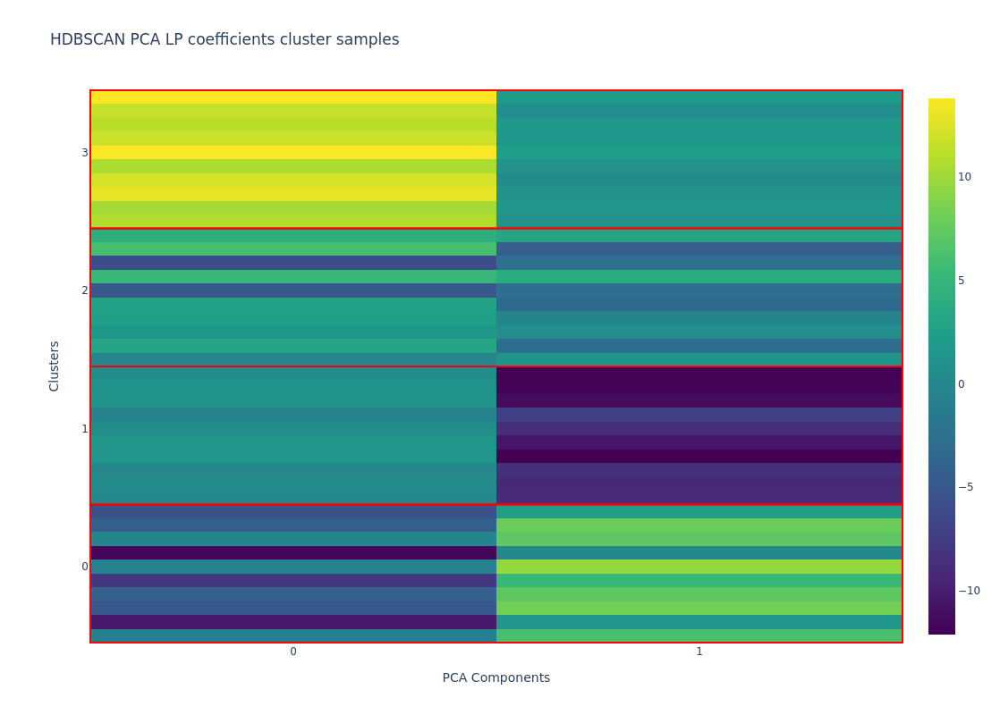

In [61]:
plot_grid_clusters(
    pca_lp_coefficients_5m,
    pca_lp_hdbscan_labels_5m,
    [0,1,2,3],
    "HDBSCAN PCA LP coefficients cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '5mpcalpcoefficients',
    'HDBSCAN'
    )

### Agglomerative clustering

In [62]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=4)
pca_lp_agglomerative_labels_5m = agglomerativeclustering.fit_predict(pca_lp_coefficients_5m)

The most repeated label is 0 with 382 occurrences.
The least repeated label is 3 with 154 occurrence.
Cluster density mean: 250.0
Cluster density variance: 85.63877626402656


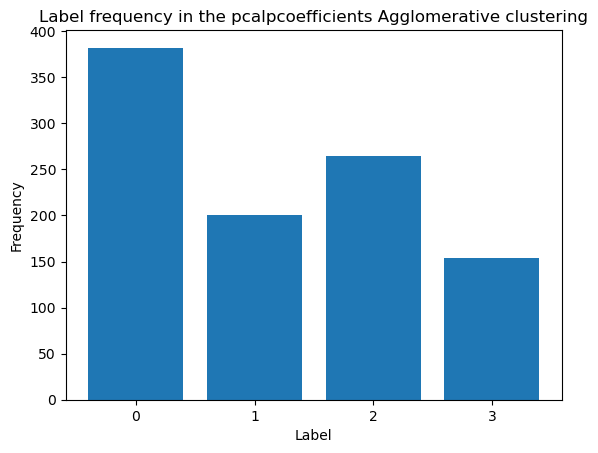

In [63]:
plot_cluster_labels_count(pca_lp_agglomerative_labels_5m, 
                          'Agglomerative',
                          '5mpcalpcoefficients')

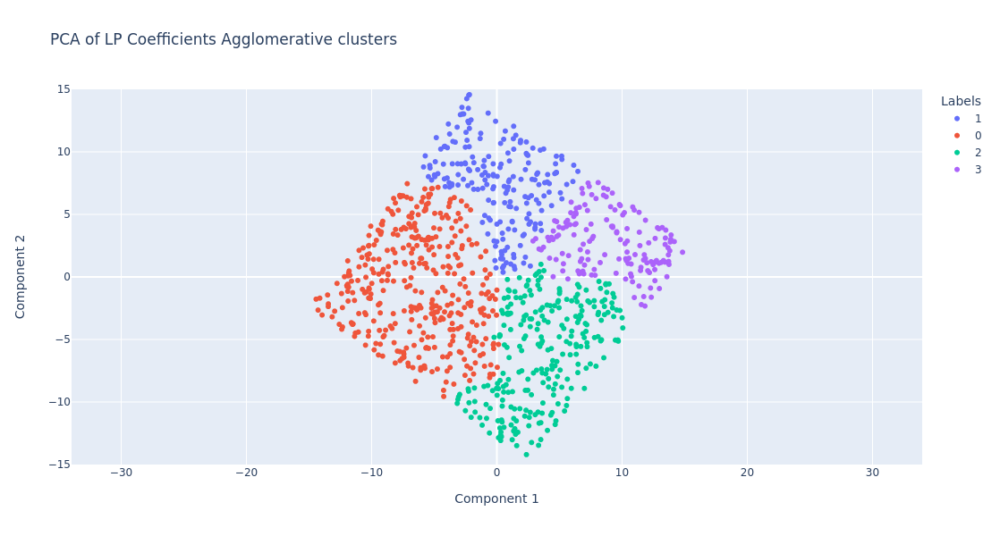

In [64]:
plot_clusters_from_labels(pca_lp_coefficients_5m,
                          pca_lp_agglomerative_labels_5m,
                          'PCA of LP Coefficients Agglomerative clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcalpcoefficients',
                          'Agglomerative',
                          axis_range=[-15, 15])

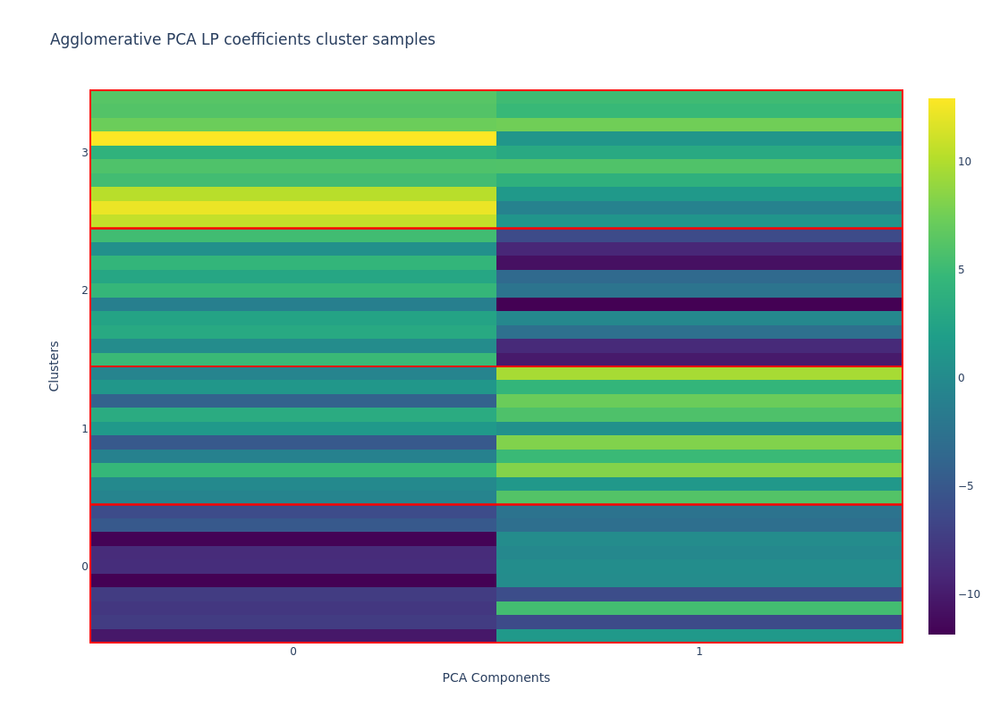

In [65]:
plot_grid_clusters(
    pca_lp_coefficients_5m,
    pca_lp_agglomerative_labels_5m,
    [0,1,2,3],
    "Agglomerative PCA LP coefficients cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '5mpcalpcoefficients',
    'Agglomerative'
    )

In [66]:
print(normalized_mutual_info_score(pca_lp_kmeans_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_lp_dbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_lp_hdbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_lp_agglomerative_labels_5m, zernike_original_labels_5m))
print()

print(normalized_mutual_info_score(pca_lp_dbscan_labels_5m, pca_lp_kmeans_labels_5m))
print(normalized_mutual_info_score(pca_lp_hdbscan_labels_5m, pca_lp_kmeans_labels_5m))
print(normalized_mutual_info_score(pca_lp_agglomerative_labels_5m, pca_lp_kmeans_labels_5m))
print()

print(normalized_mutual_info_score(pca_lp_hdbscan_labels_5m, pca_lp_dbscan_labels_5m))
print(normalized_mutual_info_score(pca_lp_agglomerative_labels_5m, pca_lp_dbscan_labels_5m))
print()

print(normalized_mutual_info_score(pca_lp_agglomerative_labels_5m, pca_lp_hdbscan_labels_5m))

0.002421191696886459
0.0039059328722469778
0.0032104776324466218
0.003178949346458999

0.15077313378955887
0.1986884239632213
0.6424783632759499

0.17894618935529216
0.2094791318273126

0.003178949346458999


# Clustering UMAP LP Coefficients

In [67]:
umap_lp_coefficients_5m = np.load(minidataset_5m_dict['umap_lp_modes_path'])

The most repeated label is 2 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


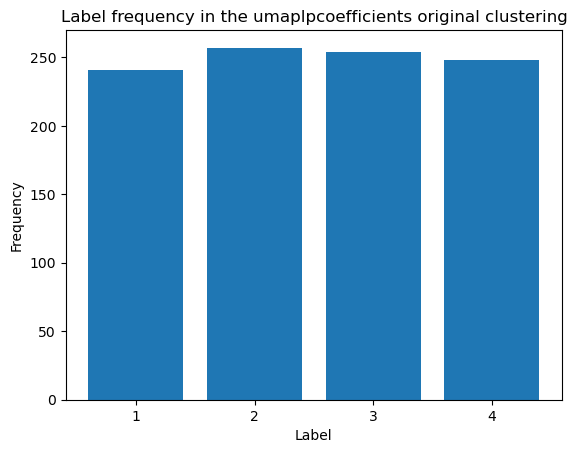

In [68]:
plot_cluster_labels_count(zernike_original_labels_5m, 
                          'original',
                          '5mumaplpcoefficients')

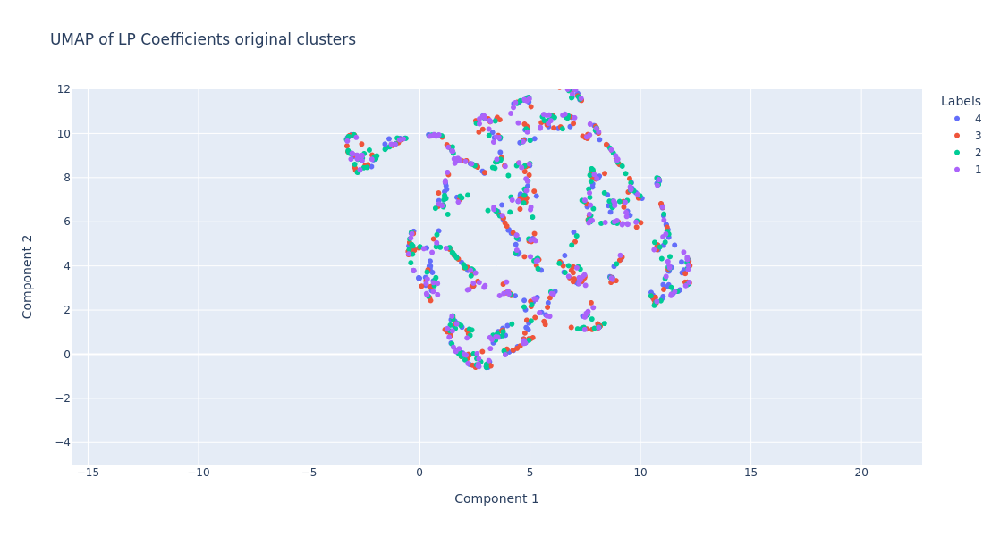

In [69]:
plot_clusters_from_labels(umap_lp_coefficients_5m,
                          zernike_original_labels_5m,
                          'UMAP of LP Coefficients original clusters',
                          'Component 1',
                          'Component 2',
                          '5mumaplpcoefficients',
                          'original',
                          axis_range=[-5, 12])

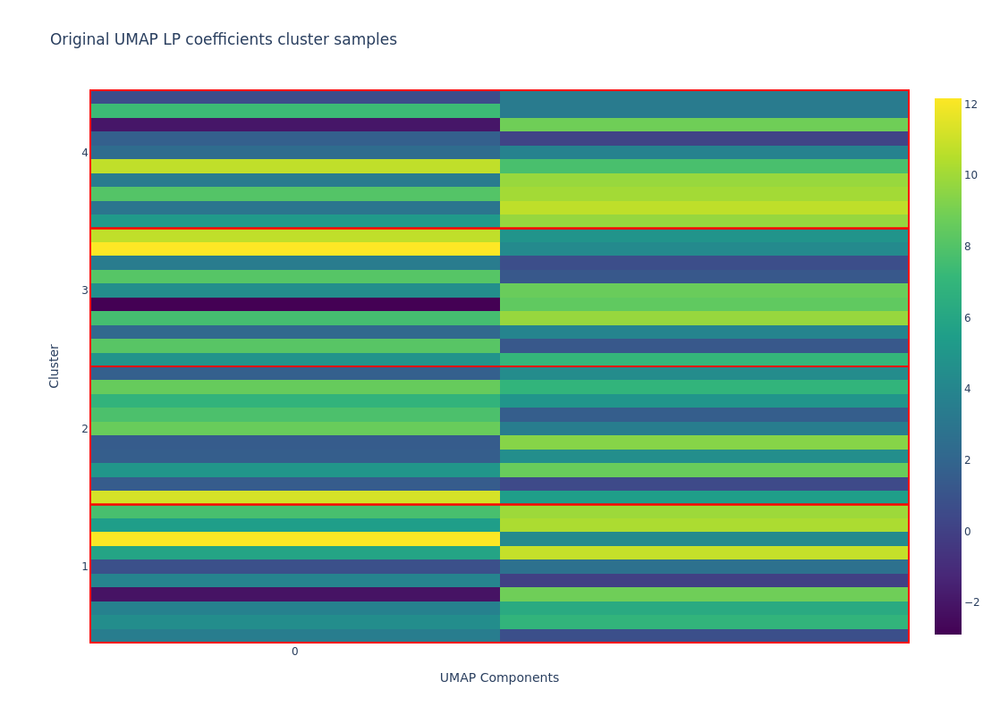

In [70]:
plot_grid_clusters(
    umap_lp_coefficients_5m,
    zernike_original_labels_5m,
    [1,2,3,4],
    "Original UMAP LP coefficients cluster samples",
    "UMAP Components",
    "Cluster",
    19,
    '5mumaplpcoefficients',
    'original'
    )

### K-Means

In [71]:
kmeans = KMeans(n_clusters=4,
                n_init=10)
umap_lp_kmeans_labels_5m = kmeans.fit_predict(umap_lp_coefficients_5m)

The most repeated label is 1 with 286 occurrences.
The least repeated label is 3 with 175 occurrence.
Cluster density mean: 250.0
Cluster density variance: 44.06245567373657


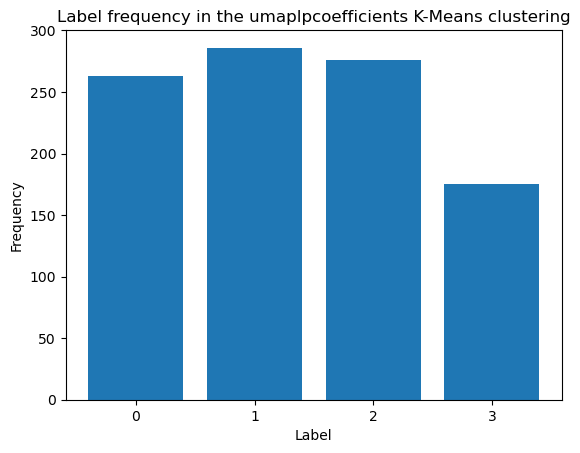

In [72]:
plot_cluster_labels_count(umap_lp_kmeans_labels_5m, 
                          'K-Means',
                          '5mumaplpcoefficients')

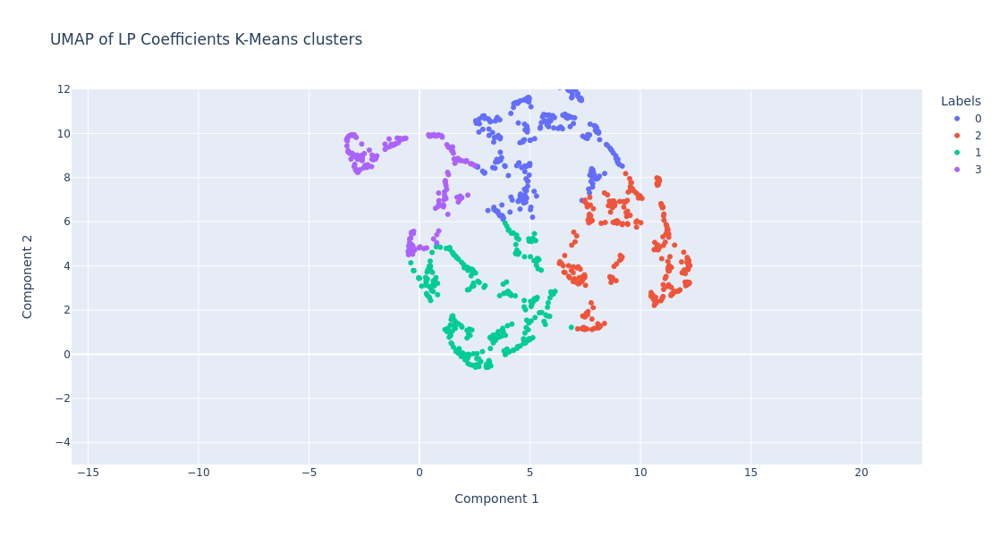

In [73]:
plot_clusters_from_labels(umap_lp_coefficients_5m,
                          umap_lp_kmeans_labels_5m,
                          'UMAP of LP Coefficients K-Means clusters',
                          'Component 1',
                          'Component 2',
                          '5mumaplpcoefficients',
                          'K-Means',
                          axis_range=[-5, 12])

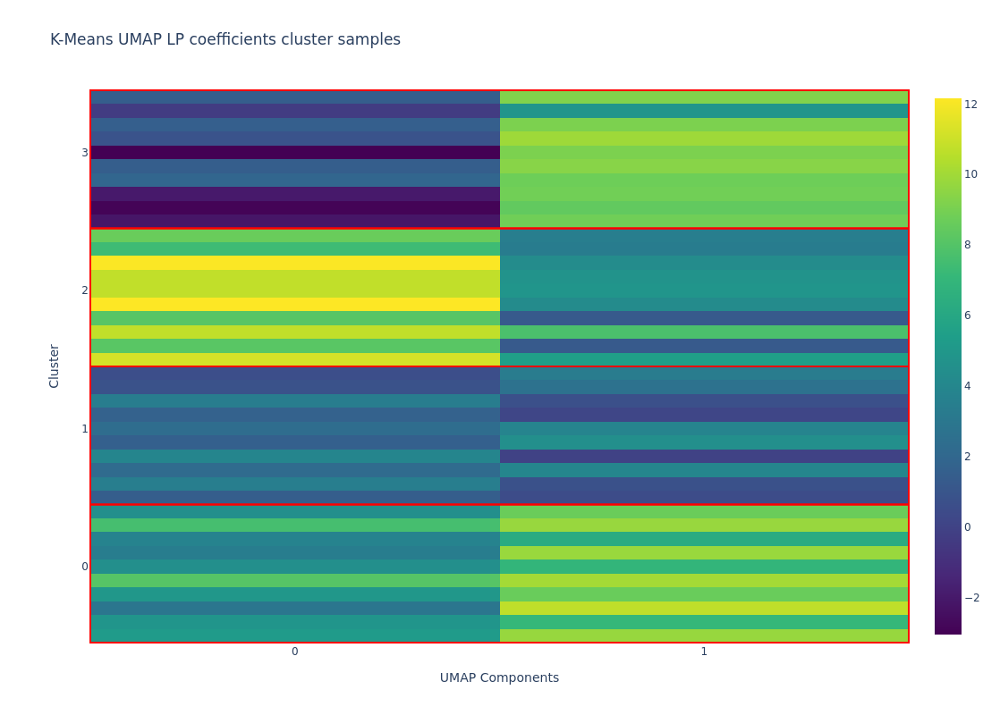

In [74]:
plot_grid_clusters(
    umap_lp_coefficients_5m,
    umap_lp_kmeans_labels_5m,
    [0,1,2,3],
    "K-Means UMAP LP coefficients cluster samples",
    "UMAP Components",
    "Cluster",
    1,
    '5mumaplpcoefficients',
    'K-Means'
    )

### DBSCAN

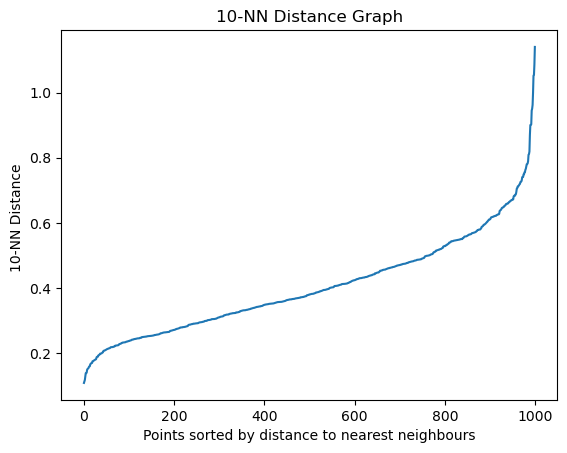

Number of clusters: 6
Numbers that are not noise: 1000


In [214]:
n_neighbours = 10
plot_kneighbours(umap_lp_coefficients_5m, n_neighbours)
epsilon = 0.85
umap_lp_dbscan_labels_5m = get_number_of_clusters(umap_lp_coefficients_5m, epsilon, n_neighbours)

The most repeated label is 0 with 439 occurrences.
The least repeated label is 5 with 16 occurrence.
Cluster density mean: 166.66666666666666
Cluster density variance: 146.5033181270043


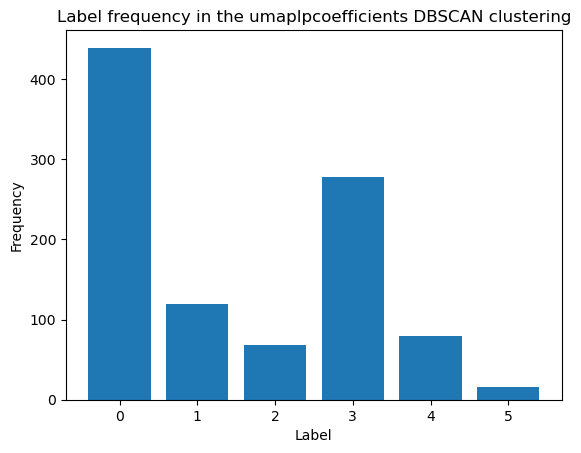

In [215]:
plot_cluster_labels_count(umap_lp_dbscan_labels_5m, 
                          'DBSCAN', 
                          '5mumaplpcoefficients')

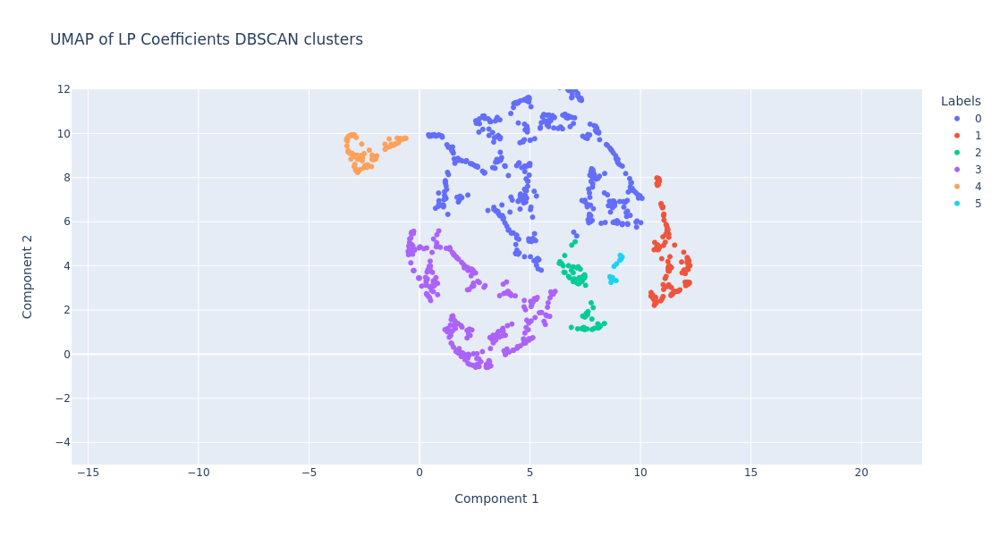

In [216]:
plot_clusters_from_labels(umap_lp_coefficients_5m,
                          umap_lp_dbscan_labels_5m,
                          'UMAP of LP Coefficients DBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mumaplpcoefficients',
                          'DBSCAN',
                          axis_range=[-5, 12])

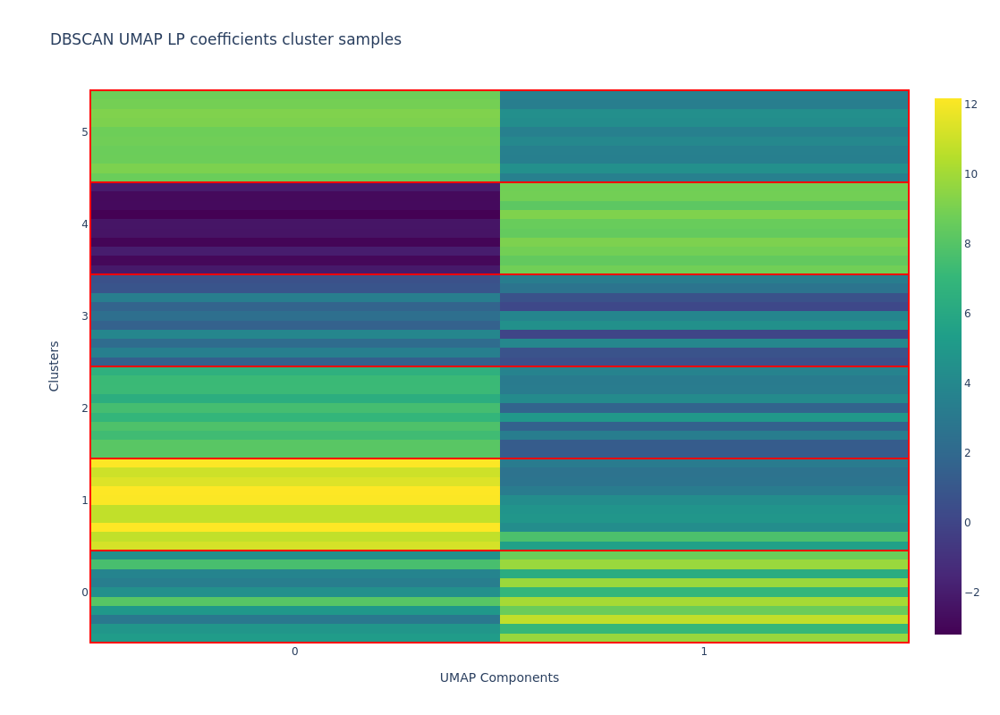

In [217]:
plot_grid_clusters(
    umap_lp_coefficients_5m,
    umap_lp_dbscan_labels_5m,
    [0,1,2,3,4,5],
    "DBSCAN UMAP LP coefficients cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumaplpcoefficients',
    'DBSCAN'
    )

### HDBSCAN

In [79]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=25)
umap_lp_hdbscan_labels_5m = clusterer.fit_predict(umap_lp_coefficients_5m)

The most repeated label is 4 with 144 occurrences.
The least repeated label is 7 with 29 occurrence.
Cluster density mean: 83.0
Cluster density variance: 38.1051177665153


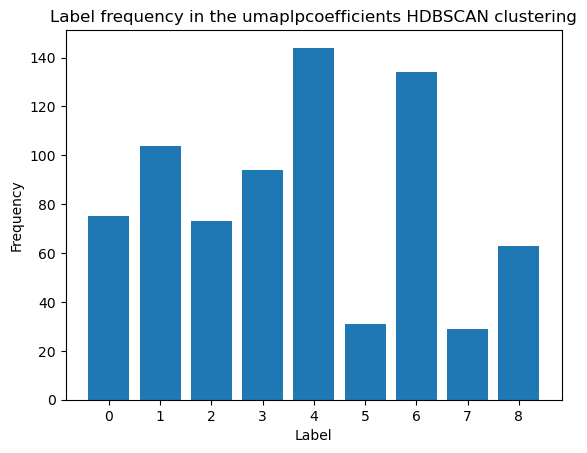

In [80]:
plot_cluster_labels_count(umap_lp_hdbscan_labels_5m, 
                          'HDBSCAN', 
                          '5mumaplpcoefficients')

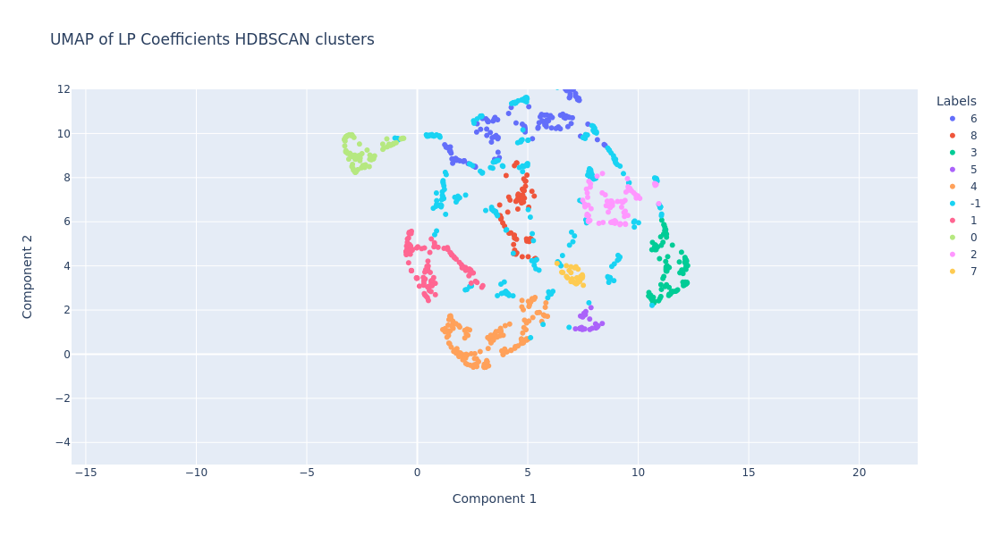

In [81]:
plot_clusters_from_labels(umap_lp_coefficients_5m,
                          umap_lp_hdbscan_labels_5m,
                          'UMAP of LP Coefficients HDBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mumaplpcoefficients',
                          'HDBSCAN',
                          axis_range=[-5, 12]
                          )

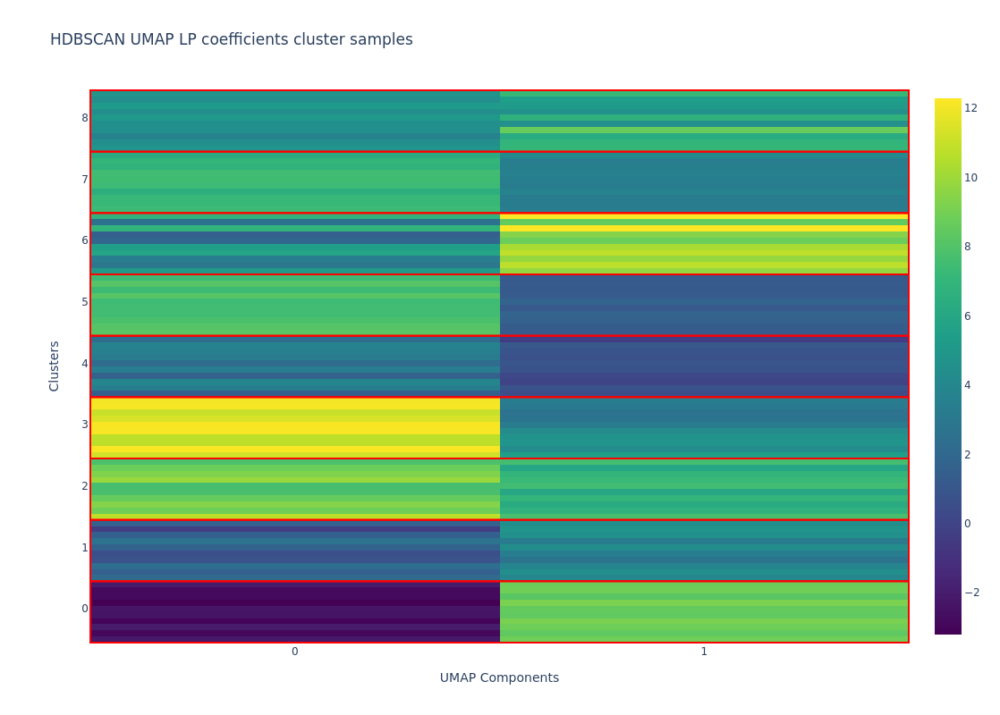

In [82]:
plot_grid_clusters(
    umap_lp_coefficients_5m,
    umap_lp_hdbscan_labels_5m,
    [0,1,2,3,4,5,6,7,8,9],
    "HDBSCAN UMAP LP coefficients cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumaplpcoefficients',
    'HDBSCAN'
    )

### Agglomerative clustering

In [83]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=4)
umap_lp_agglomerative_labels_5m = agglomerativeclustering.fit_predict(umap_lp_coefficients_5m)

The most repeated label is 0 with 346 occurrences.
The least repeated label is 3 with 80 occurrence.
Cluster density mean: 250.0
Cluster density variance: 101.26203632161463


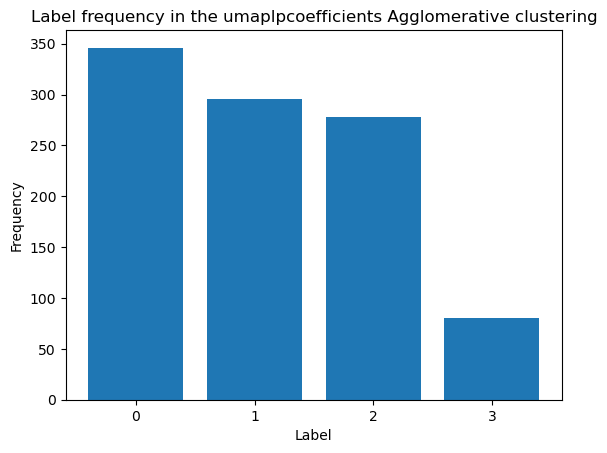

In [84]:
plot_cluster_labels_count(umap_lp_agglomerative_labels_5m, 
                          'Agglomerative',
                          '5mumaplpcoefficients')

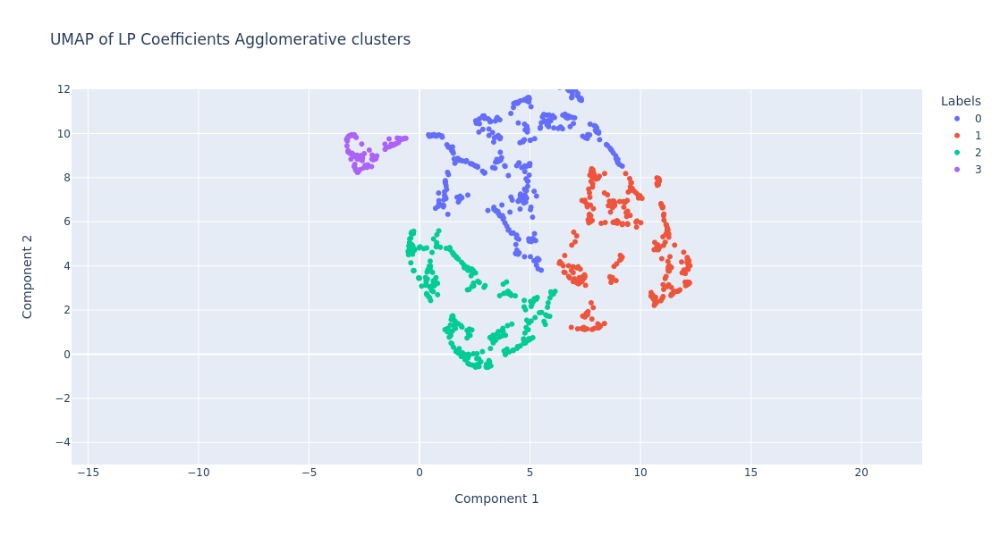

In [85]:
plot_clusters_from_labels(umap_lp_coefficients_5m,
                          umap_lp_agglomerative_labels_5m,
                          'UMAP of LP Coefficients Agglomerative clusters',
                          'Component 1',
                          'Component 2',
                          '5mumaplpcoefficients',
                          'Agglomerative',
                          axis_range=[-5, 12])

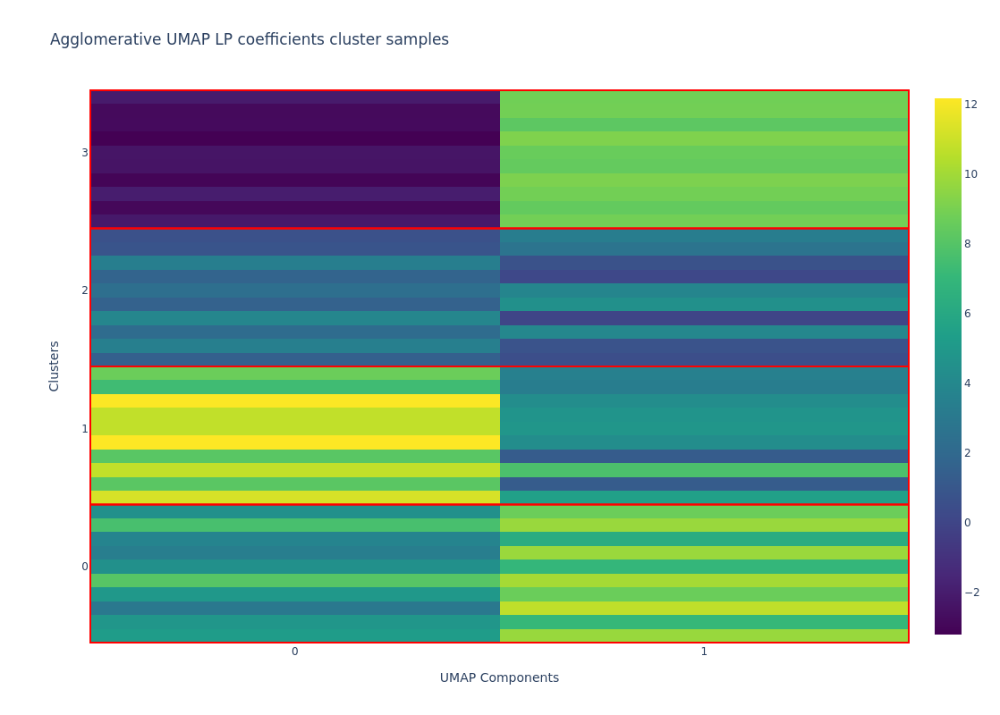

In [86]:
plot_grid_clusters(
    umap_lp_coefficients_5m,
    umap_lp_agglomerative_labels_5m,
    [0,1,2,3],
    "Agglomerative UMAP LP coefficients cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumaplpcoefficients',
    'Agglomerative'
    )

In [87]:
print(normalized_mutual_info_score(umap_lp_kmeans_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_lp_dbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_lp_hdbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_lp_agglomerative_labels_5m, zernike_original_labels_5m))
print()

print(normalized_mutual_info_score(umap_lp_dbscan_labels_5m, umap_lp_kmeans_labels_5m))
print(normalized_mutual_info_score(umap_lp_hdbscan_labels_5m, umap_lp_kmeans_labels_5m))
print(normalized_mutual_info_score(umap_lp_agglomerative_labels_5m, umap_lp_kmeans_labels_5m))
print()

print(normalized_mutual_info_score(umap_lp_hdbscan_labels_5m, umap_lp_dbscan_labels_5m))
print(normalized_mutual_info_score(umap_lp_agglomerative_labels_5m, umap_lp_dbscan_labels_5m))
print()

print(normalized_mutual_info_score(umap_lp_agglomerative_labels_5m, umap_lp_hdbscan_labels_5m))

0.003030590400761115
0.006634253606980179
0.008020624145803484
0.002344908185361688

0.5639797059120373
0.4880156681527555
0.6935290035448008

0.6386647991147362
0.7822381050540513

0.002344908185361688


# Clustering PCA Output fluxes

In [15]:
pca_output_fluxes_5m = np.load(minidataset_5m_dict['pca_output_fluxes_path'])

The most repeated label is 2 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


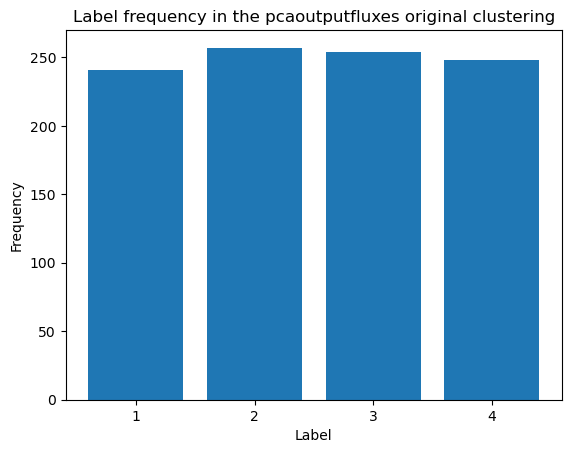

In [109]:
plot_cluster_labels_count(zernike_original_labels_5m, 
                          'original',
                          '5mpcaoutputfluxes')

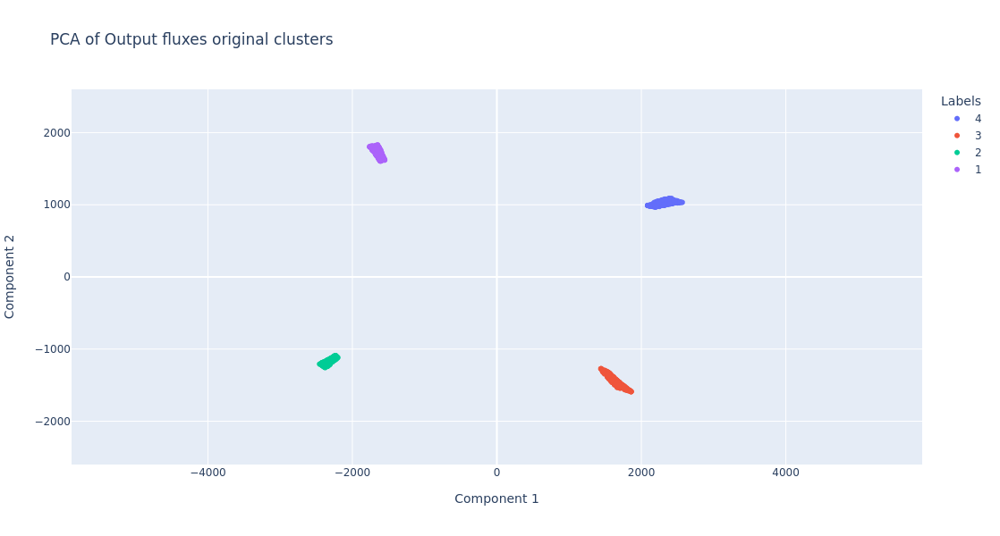

In [110]:
plot_clusters_from_labels(pca_output_fluxes_5m,
                          zernike_original_labels_5m,
                          'PCA of Output fluxes original clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcaoutputfluxes',
                          'original',
                          axis_range=[-2600, 2600])

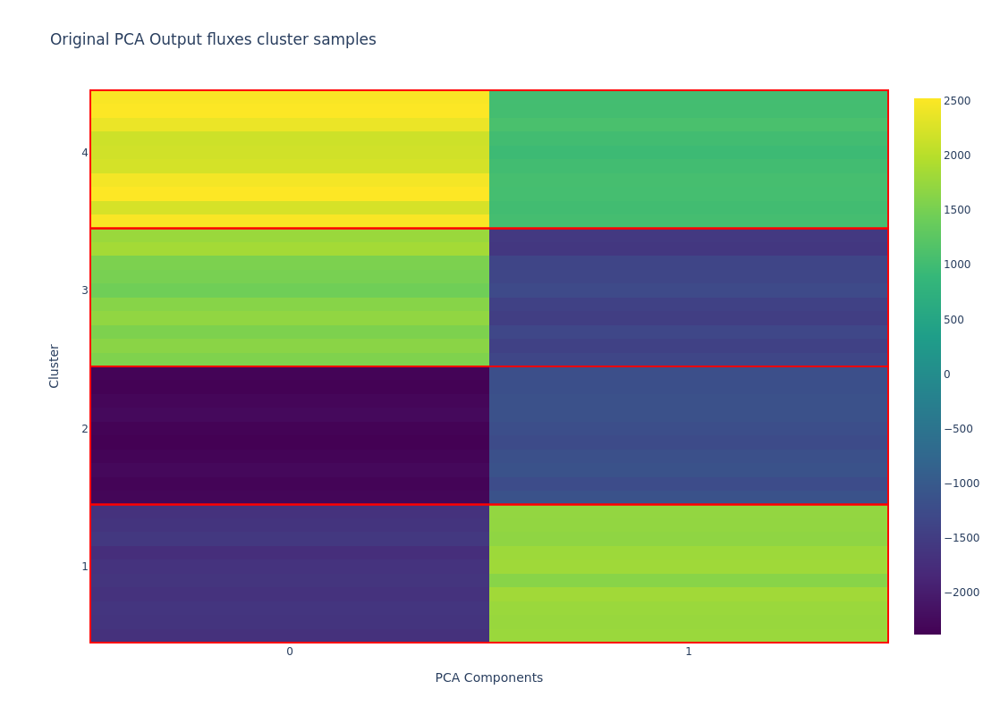

In [111]:
plot_grid_clusters(
    pca_output_fluxes_5m,
    zernike_original_labels_5m,
    [1,2,3,4],
    "Original PCA Output fluxes cluster samples",
    "PCA Components",
    "Cluster",
    1,
    '5mpcaoutputfluxes',
    'original'
    )

### K-Means

In [16]:
kmeans = KMeans(n_clusters=4,
                n_init=10)
pca_flux_kmeans_labels_5m = kmeans.fit_predict(pca_output_fluxes_5m)

The most repeated label is 1 with 257 occurrences.
The least repeated label is 2 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


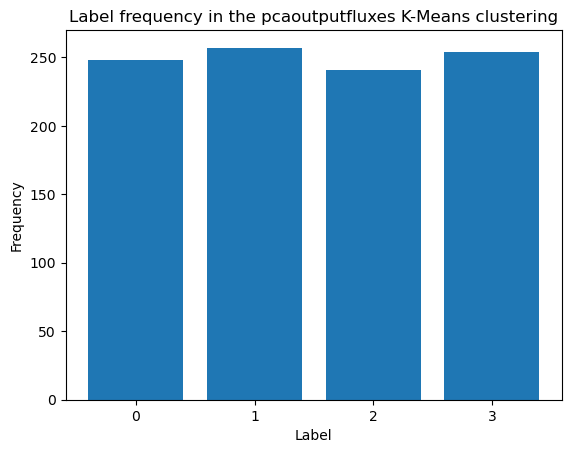

In [17]:
plot_cluster_labels_count(pca_flux_kmeans_labels_5m, 
                          'K-Means',
                          '5mpcaoutputfluxes')

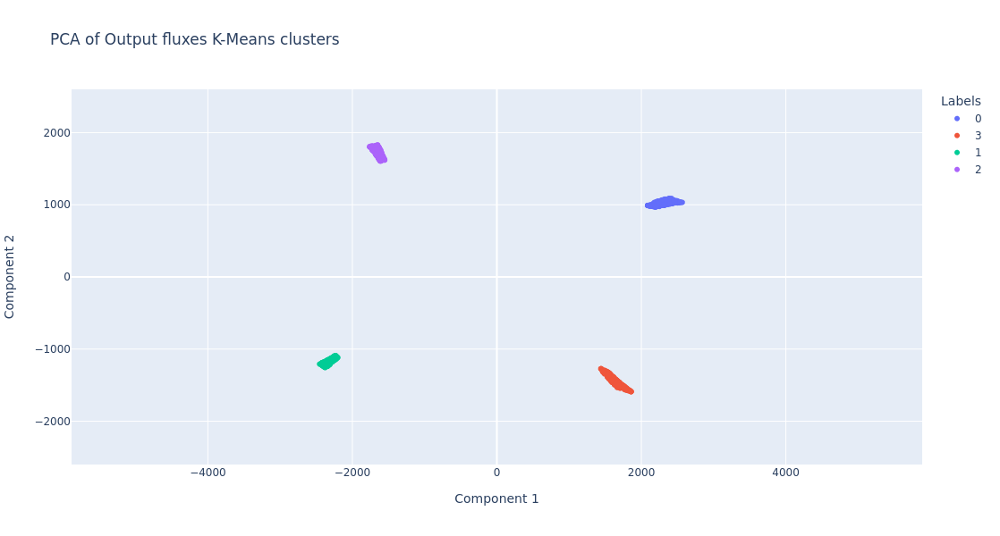

In [18]:
plot_clusters_from_labels(pca_output_fluxes_5m,
                          pca_flux_kmeans_labels_5m,
                          'PCA of Output fluxes K-Means clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcaoutputfluxes',
                          'K-Means',
                          axis_range=[-2600, 2600])

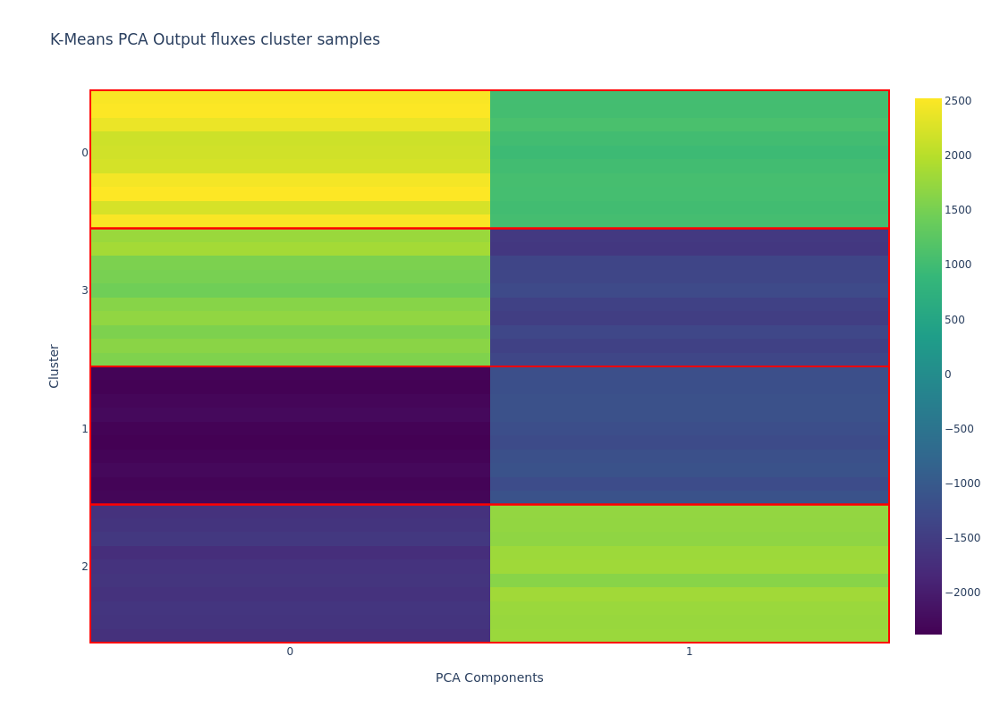

In [20]:
plot_grid_clusters(
    pca_output_fluxes_5m,
    pca_flux_kmeans_labels_5m,
    [2,1,3,0],
    "K-Means PCA Output fluxes cluster samples",
    "PCA Components",
    "Cluster",
    1,
    '5mpcaoutputfluxes',
    'K-Means'
    )

### DBSCAN

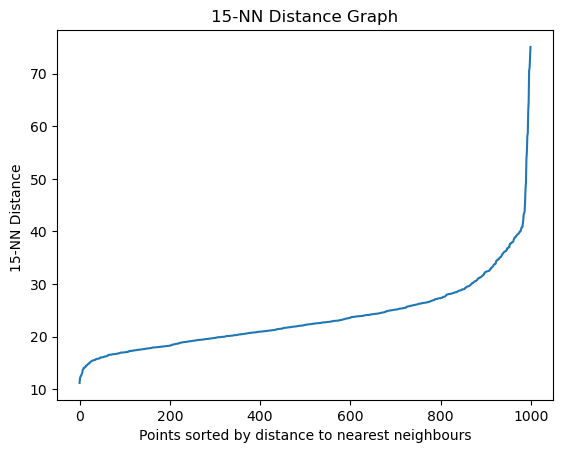

Number of clusters: 4
Numbers that are not noise: 1000


In [116]:
n_neighbours = 15
plot_kneighbours(pca_output_fluxes_5m, n_neighbours)
epsilon = 40
pca_flux_dbscan_labels_5m = get_number_of_clusters(pca_output_fluxes_5m, epsilon, n_neighbours)

The most repeated label is 2 with 257 occurrences.
The least repeated label is 3 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


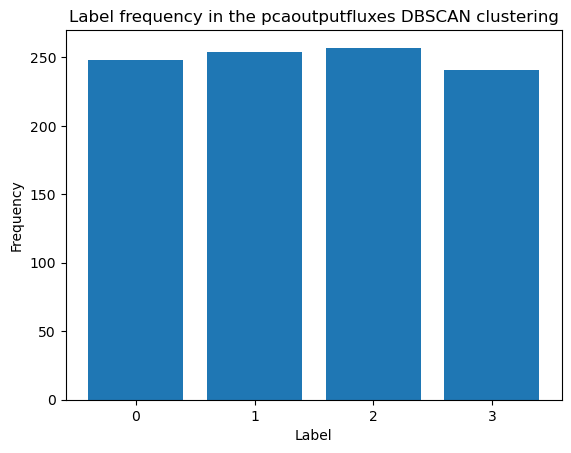

In [117]:
plot_cluster_labels_count(pca_flux_dbscan_labels_5m, 
                          'DBSCAN', 
                          '5mpcaoutputfluxes')

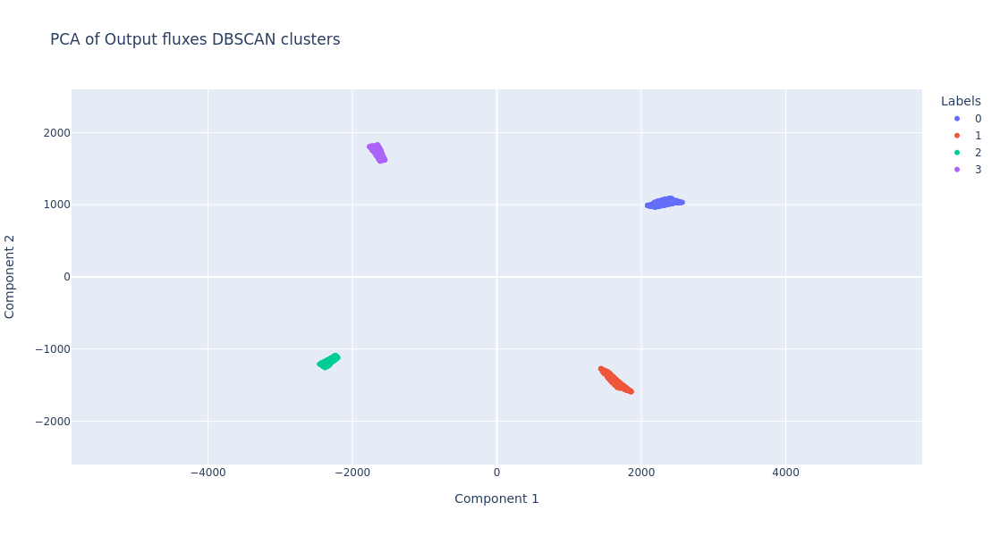

In [118]:
plot_clusters_from_labels(pca_output_fluxes_5m,
                          pca_flux_dbscan_labels_5m,
                          'PCA of Output fluxes DBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcaoutputfluxes',
                          'DBSCAN',
                          axis_range=[-2600, 2600])

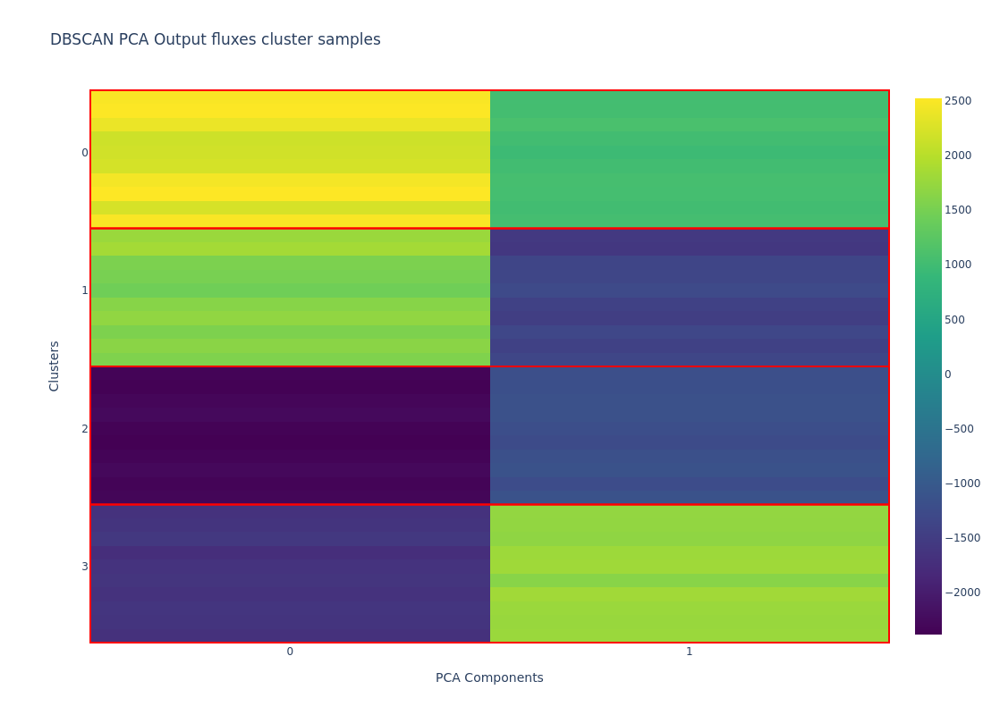

In [119]:
plot_grid_clusters(
    pca_output_fluxes,
    pca_flux_dbscan_labels_5m,
    [3,2,1,0],
    "DBSCAN PCA Output fluxes cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '5mpcaoutputfluxes',
    'DBSCAN'
    )

### HDBSCAN

In [120]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=21)
pca_flux_hdbscan_labels_5m = clusterer.fit_predict(pca_output_fluxes_5m)

The most repeated label is 1 with 257 occurrences.
The least repeated label is 0 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


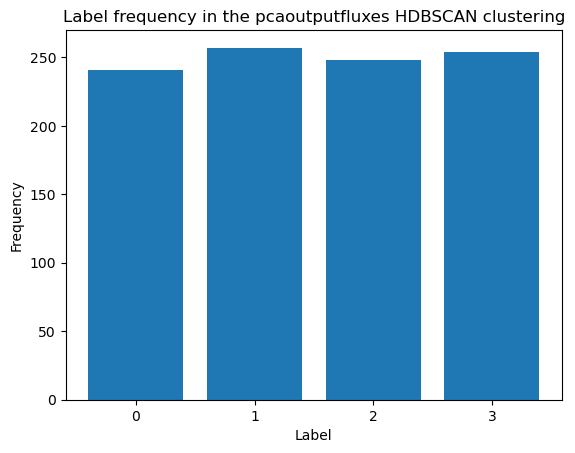

In [121]:
plot_cluster_labels_count(pca_flux_hdbscan_labels_5m, 
                          'HDBSCAN', 
                          '5mpcaoutputfluxes')

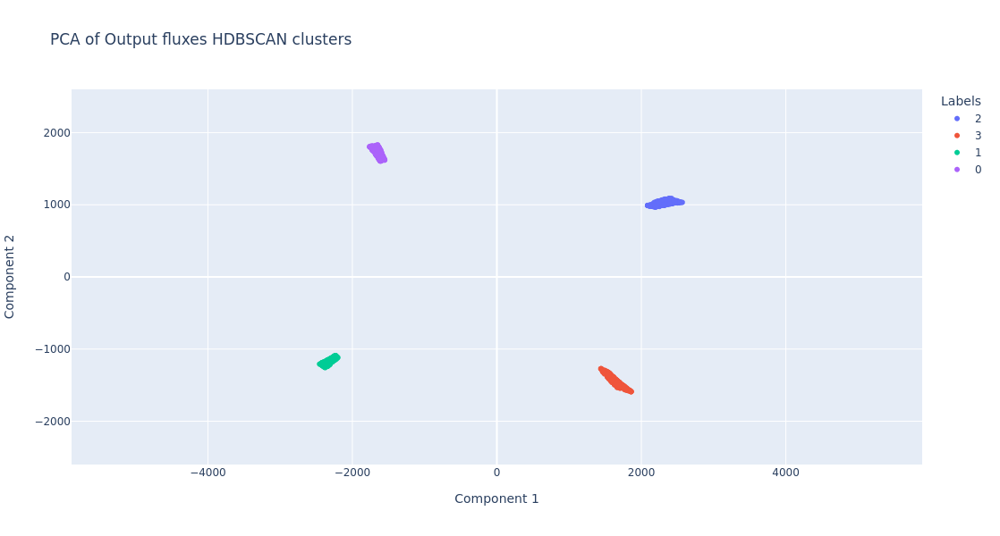

In [122]:
plot_clusters_from_labels(pca_output_fluxes_5m,
                          pca_flux_hdbscan_labels_5m,
                          'PCA of Output fluxes HDBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcaoutputfluxes',
                          'HDBSCAN',
                          axis_range=[-2600, 2600]
                          )

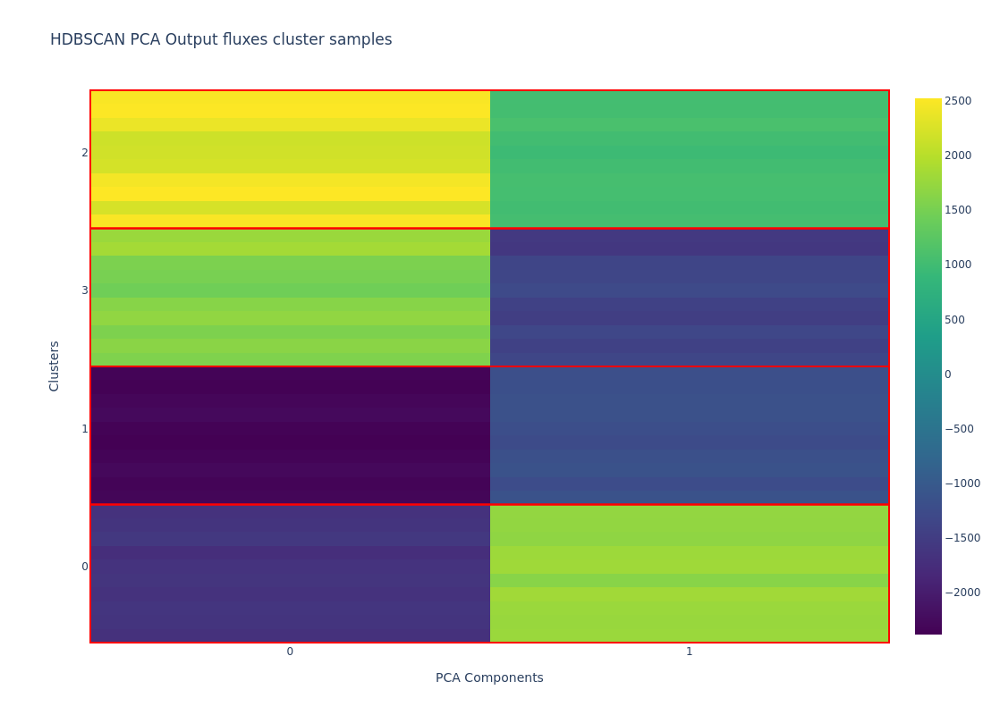

In [123]:
plot_grid_clusters(
    pca_output_fluxes_5m,
    pca_flux_hdbscan_labels_5m,
    [0,1,3,2],
    "HDBSCAN PCA Output fluxes cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '5mpcaoutputfluxes',
    'HDBSCAN'
    )

### Agglomerative clustering

In [124]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=4)
pca_flux_agglomerative_labels_5m = agglomerativeclustering.fit_predict(pca_output_fluxes_5m)

The most repeated label is 3 with 257 occurrences.
The least repeated label is 2 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


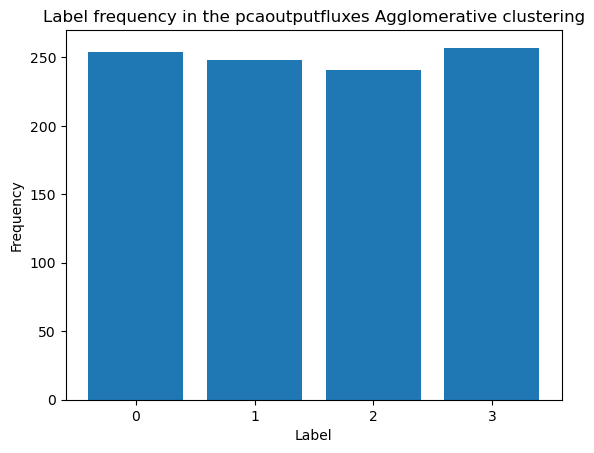

In [125]:
plot_cluster_labels_count(pca_flux_agglomerative_labels_5m, 
                          'Agglomerative',
                          '5mpcaoutputfluxes')

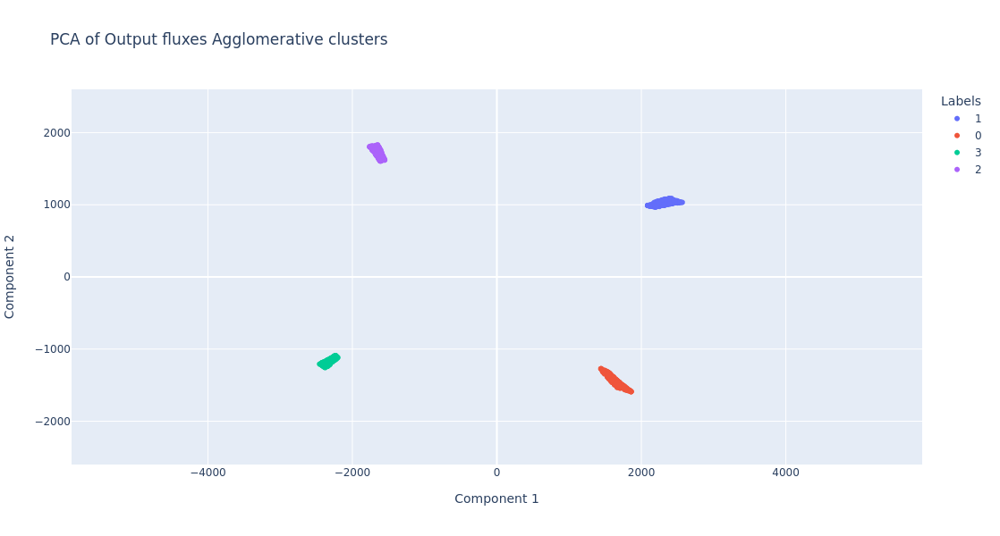

In [126]:
plot_clusters_from_labels(pca_output_fluxes_5m,
                          pca_flux_agglomerative_labels_5m,
                          'PCA of Output fluxes Agglomerative clusters',
                          'Component 1',
                          'Component 2',
                          '5mpcaoutputfluxes',
                          'Agglomerative',
                          axis_range=[-2600, 2600])

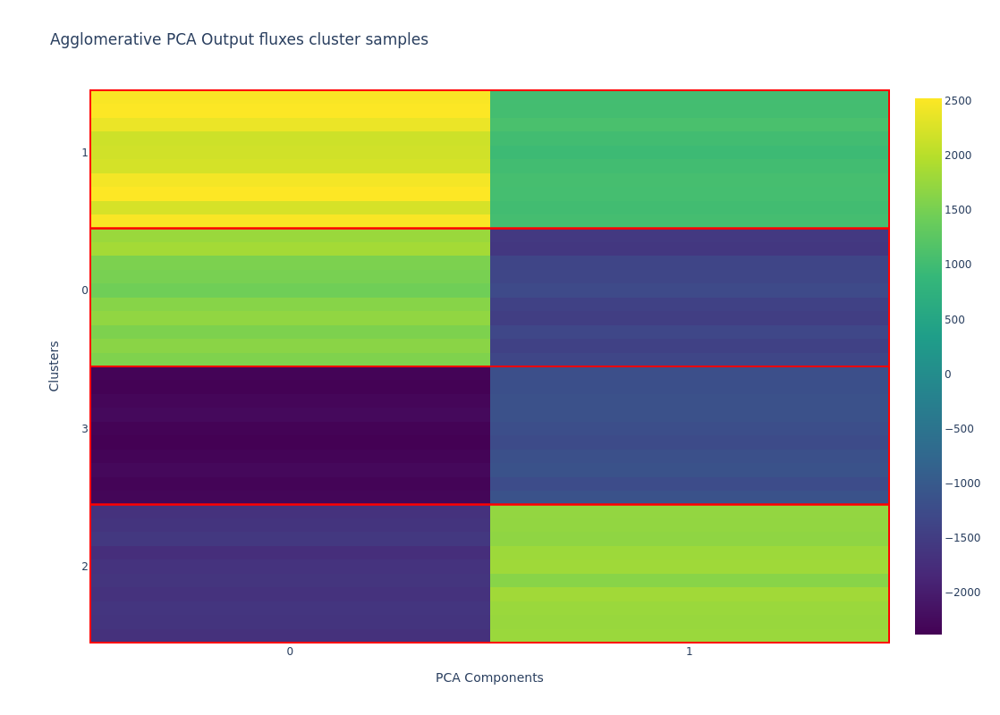

In [127]:
plot_grid_clusters(
    pca_output_fluxes_5m,
    pca_flux_agglomerative_labels_5m,
    [2,3,0,1],
    "Agglomerative PCA Output fluxes cluster samples",
    "PCA Components",
    "Clusters",
    1,
    '5mpcaoutputfluxes',
    'Agglomerative'
    )

In [128]:
print(normalized_mutual_info_score(pca_flux_kmeans_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_flux_dbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_flux_hdbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(pca_flux_agglomerative_labels_5m, zernike_original_labels_5m))
print()

print(normalized_mutual_info_score(pca_flux_dbscan_labels_5m, pca_flux_kmeans_labels_5m))
print(normalized_mutual_info_score(pca_flux_hdbscan_labels_5m, pca_flux_kmeans_labels_5m))
print(normalized_mutual_info_score(pca_flux_agglomerative_labels_5m, pca_flux_kmeans_labels_5m))
print()

print(normalized_mutual_info_score(pca_flux_hdbscan_labels_5m, pca_flux_dbscan_labels_5m))
print(normalized_mutual_info_score(pca_flux_agglomerative_labels_5m, pca_flux_dbscan_labels_5m))
print()

print(normalized_mutual_info_score(pca_flux_agglomerative_labels_5m, pca_flux_hdbscan_labels_5m))

1.0
1.0
1.0
1.0

1.0
1.0
1.0

1.0
1.0

1.0


# Clustering UMAP Output fluxes

In [21]:
umap_output_fluxes_5m = np.load(minidataset_5m_dict['umap_output_fluxes_path'])

The most repeated label is 2 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


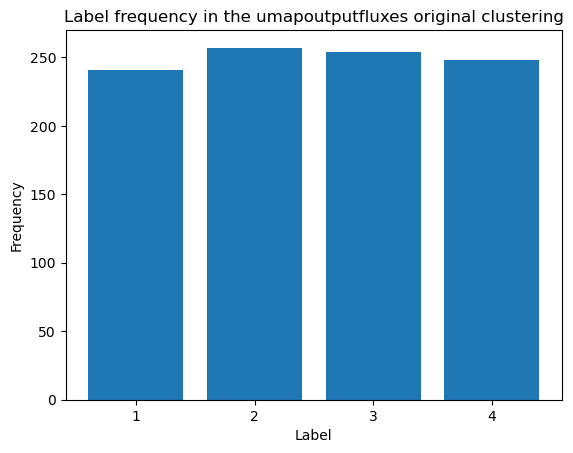

In [130]:
plot_cluster_labels_count(zernike_original_labels_5m, 
                          'original',
                          '5mumapoutputfluxes')

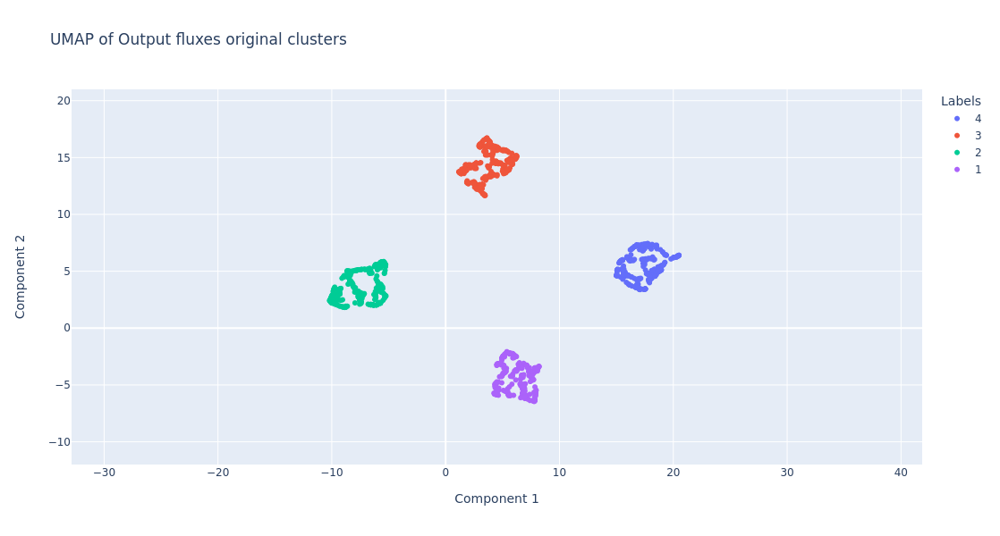

In [131]:
plot_clusters_from_labels(umap_output_fluxes_5m,
                          zernike_original_labels_5m,
                          'UMAP of Output fluxes original clusters',
                          'Component 1',
                          'Component 2',
                          '5mumapoutputfluxes',
                          'original',
                          axis_range=[-12, 21])

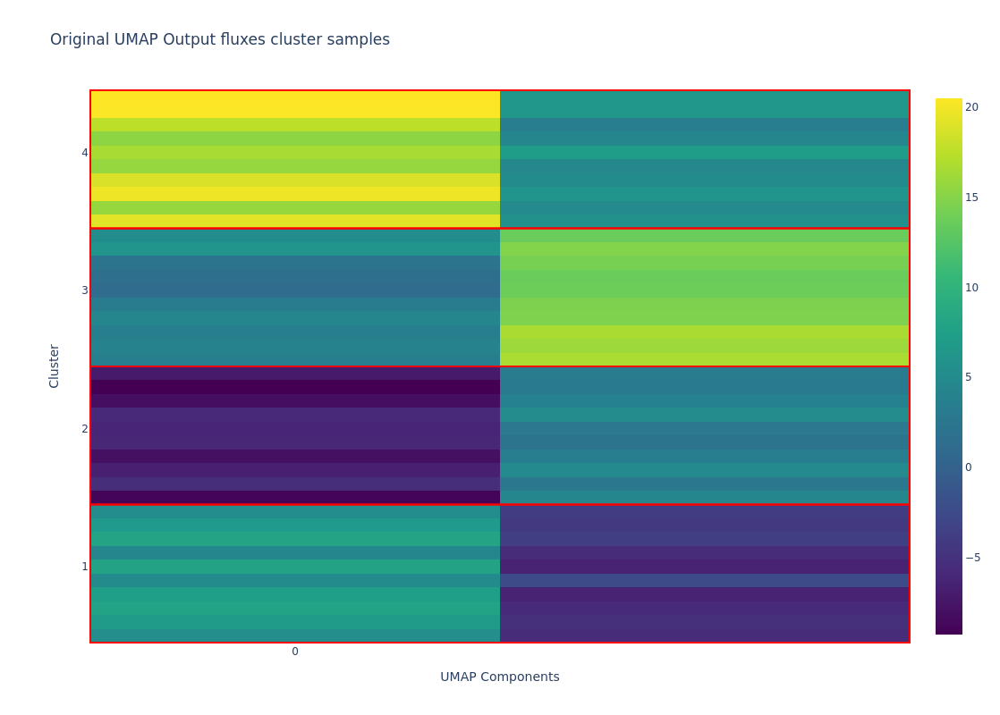

In [132]:
plot_grid_clusters(
    umap_output_fluxes_5m,
    zernike_original_labels_5m,
    [1,2,3,4],
    "Original UMAP Output fluxes cluster samples",
    "UMAP Components",
    "Cluster",
    19,
    '5mumapoutputfluxes',
    'original'
    )

### K-Means

In [22]:
kmeans = KMeans(n_clusters=4,
                n_init=10)
umap_flux_kmeans_labels_5m = kmeans.fit_predict(umap_output_fluxes_5m)

The most repeated label is 0 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


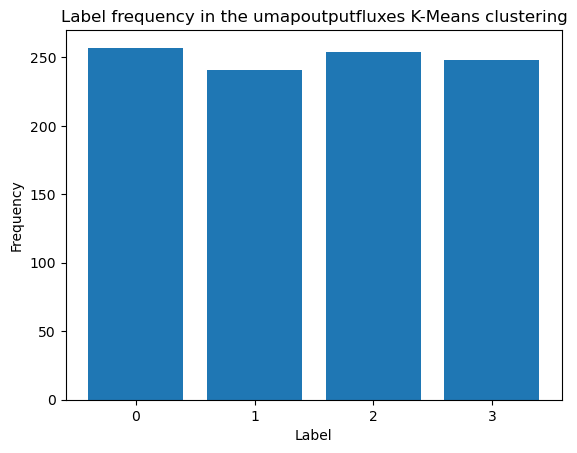

In [23]:
plot_cluster_labels_count(umap_flux_kmeans_labels_5m, 
                          'K-Means',
                          '5mumapoutputfluxes')

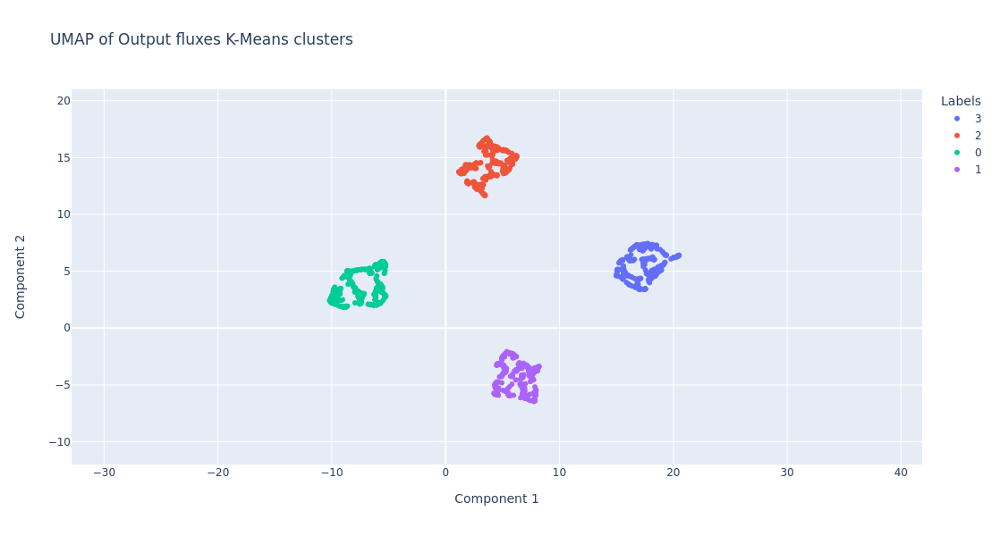

In [24]:
plot_clusters_from_labels(umap_output_fluxes_5m,
                          umap_flux_kmeans_labels_5m,
                          'UMAP of Output fluxes K-Means clusters',
                          'Component 1',
                          'Component 2',
                          '5mumapoutputfluxes',
                          'K-Means',
                          axis_range=[-12, 21])

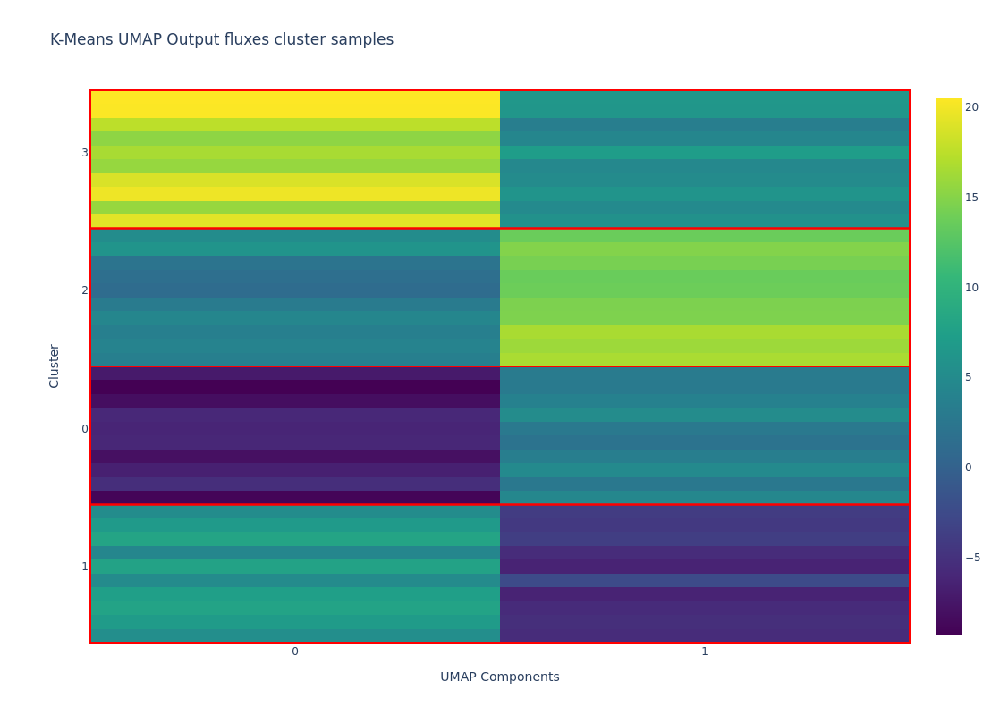

In [26]:
plot_grid_clusters(
    umap_output_fluxes_5m,
    umap_flux_kmeans_labels_5m,
    [1,0,2,3],
    "K-Means UMAP Output fluxes cluster samples",
    "UMAP Components",
    "Cluster",
    1,
    '5mumapoutputfluxes',
    'K-Means'
    )

### DBSCAN

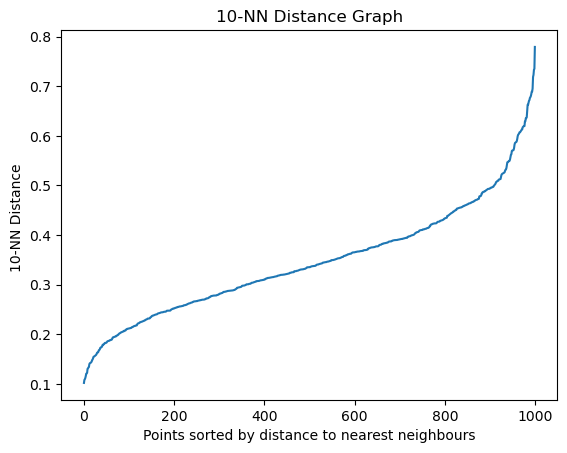

Number of clusters: 4
Numbers that are not noise: 1000


In [137]:
n_neighbours = 10
plot_kneighbours(umap_output_fluxes_5m, n_neighbours)
epsilon = 0.85
umap_flux_dbscan_labels_5m = get_number_of_clusters(umap_output_fluxes_5m, epsilon, n_neighbours)

The most repeated label is 2 with 257 occurrences.
The least repeated label is 3 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


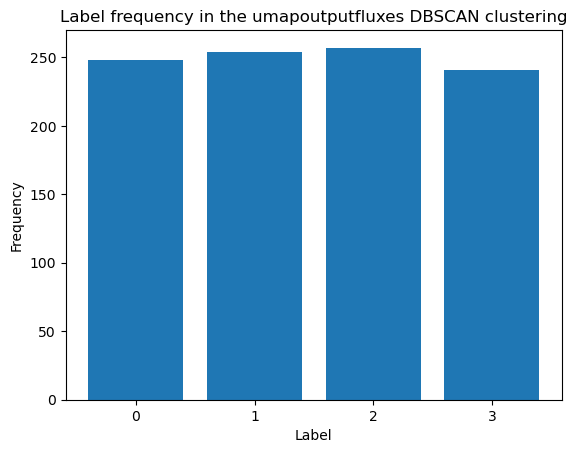

In [138]:
plot_cluster_labels_count(umap_flux_dbscan_labels_5m, 
                          'DBSCAN', 
                          '5mumapoutputfluxes')

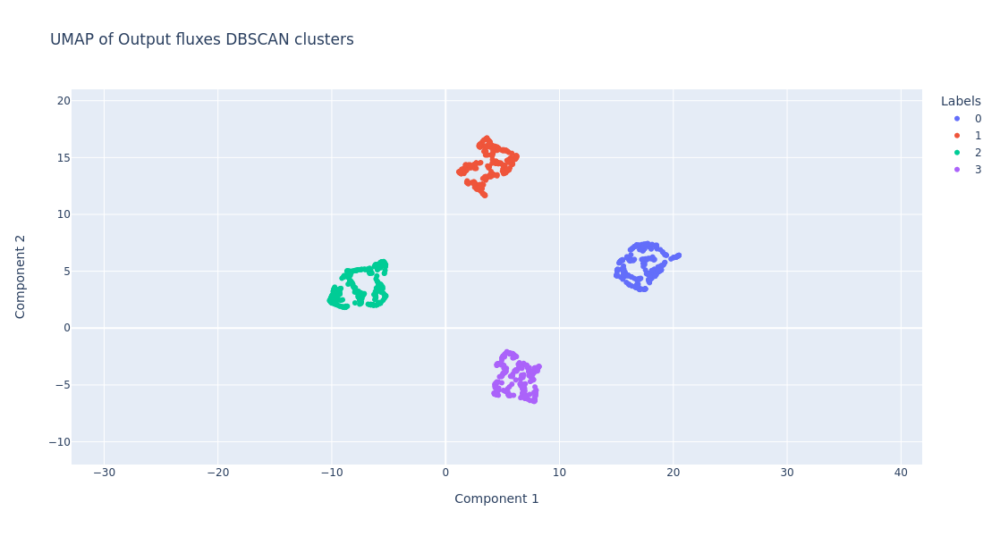

In [139]:
plot_clusters_from_labels(umap_output_fluxes_5m,
                          umap_flux_dbscan_labels_5m,
                          'UMAP of Output fluxes DBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mumapoutputfluxes',
                          'DBSCAN',
                          axis_range=[-12, 21])

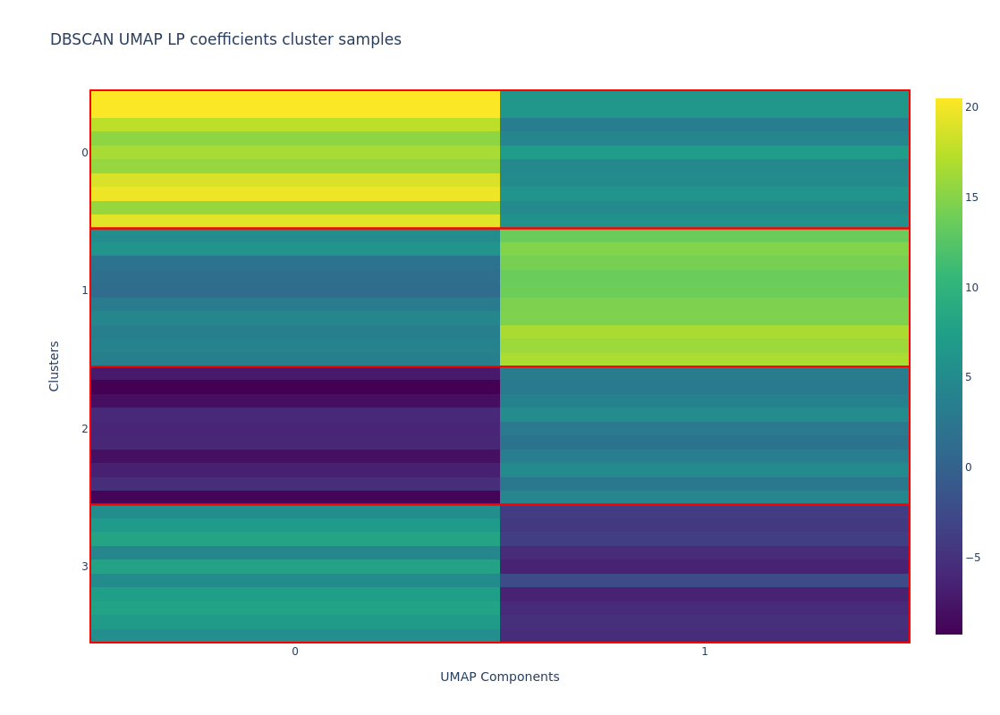

In [140]:
plot_grid_clusters(
    umap_output_fluxes_5m,
    umap_flux_dbscan_labels_5m,
    [3,2,1,0],
    "DBSCAN UMAP LP coefficients cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumapoutputfluxes',
    'DBSCAN'
    )

### HDBSCAN

In [141]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=25)
umap_flux_hdbscan_labels_5m = clusterer.fit_predict(umap_output_fluxes_5m)

The most repeated label is 3 with 257 occurrences.
The least repeated label is 0 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


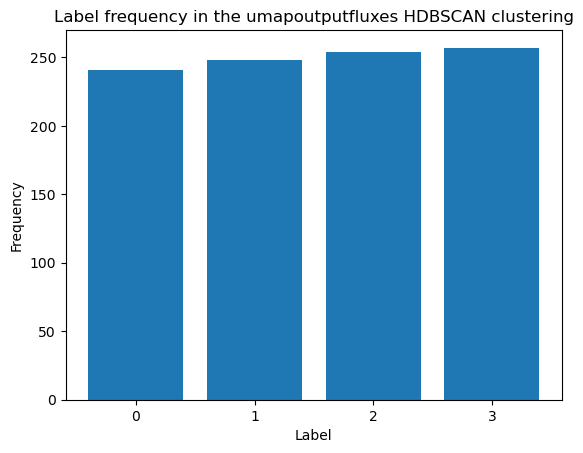

In [142]:
plot_cluster_labels_count(umap_flux_hdbscan_labels_5m,
                          'HDBSCAN', 
                          '5mumapoutputfluxes')

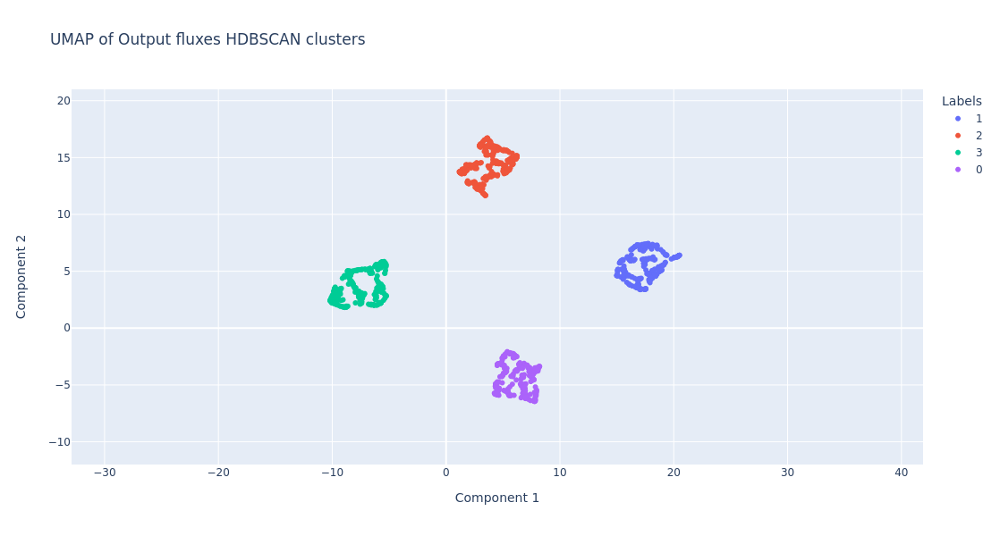

In [143]:
plot_clusters_from_labels(umap_output_fluxes_5m,
                          umap_flux_hdbscan_labels_5m,
                          'UMAP of Output fluxes HDBSCAN clusters',
                          'Component 1',
                          'Component 2',
                          '5mumapoutputfluxes',
                          'HDBSCAN',
                          axis_range=[-12, 21]
                          )

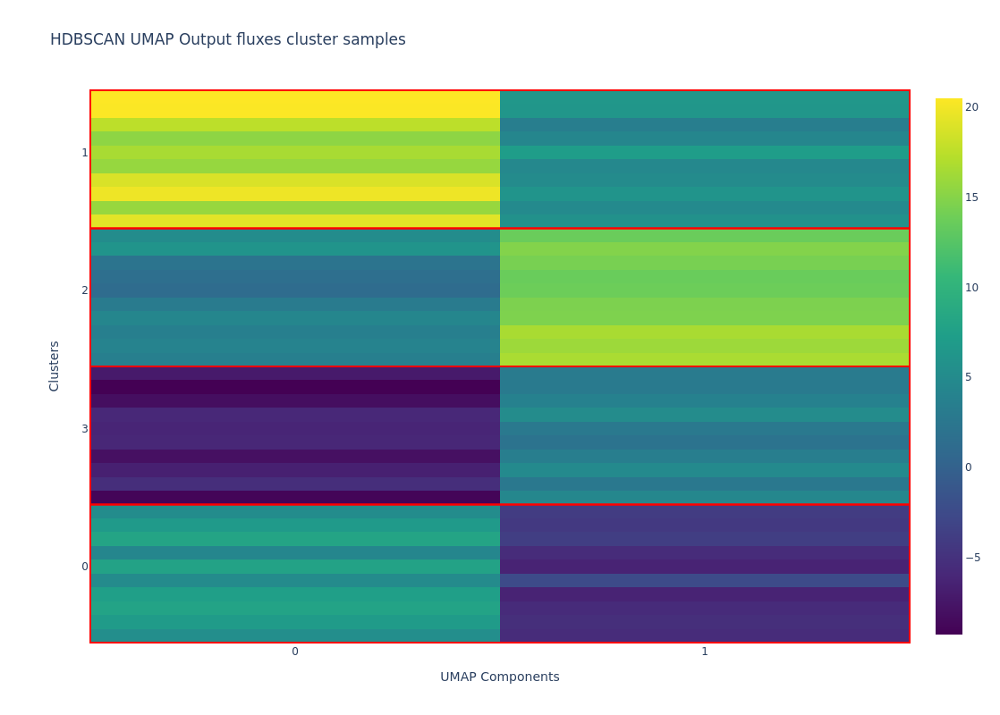

In [144]:
plot_grid_clusters(
    umap_output_fluxes_5m,
    umap_flux_hdbscan_labels_5m,
    [0,3,2,1],
    "HDBSCAN UMAP Output fluxes cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumapoutputfluxes',
    'HDBSCAN'
    )

### Agglomerative clustering

In [145]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=4)
umap_flux_agglomerative_labels_5m = agglomerativeclustering.fit_predict(umap_output_fluxes_5m)

The most repeated label is 2 with 257 occurrences.
The least repeated label is 3 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


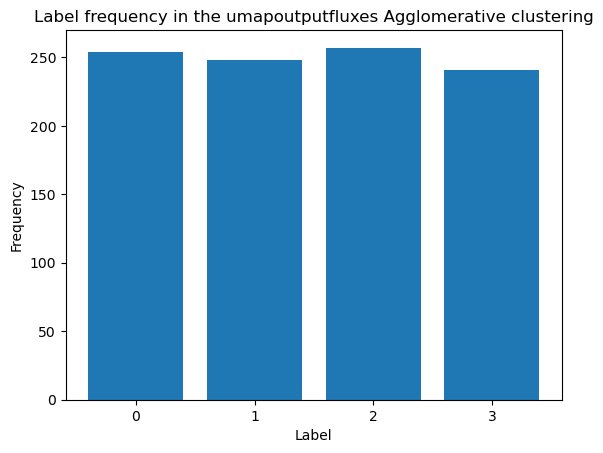

In [146]:
plot_cluster_labels_count(umap_flux_agglomerative_labels_5m, 
                          'Agglomerative',
                          '5mumapoutputfluxes')

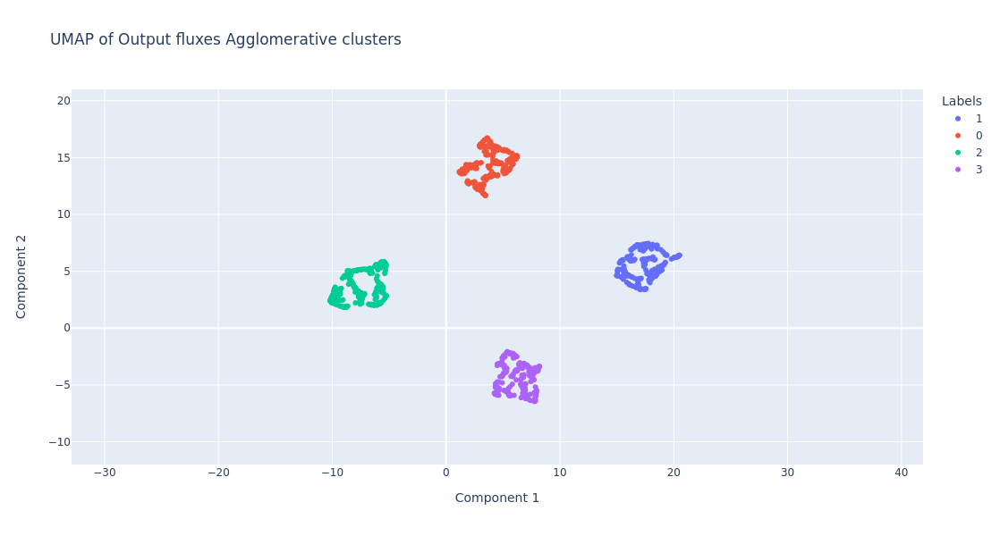

In [147]:
plot_clusters_from_labels(umap_output_fluxes_5m,
                          umap_flux_agglomerative_labels_5m,
                          'UMAP of Output fluxes Agglomerative clusters',
                          'Component 1',
                          'Component 2',
                          '5mumapoutputfluxes',
                          'Agglomerative',
                          axis_range=[-12, 21])

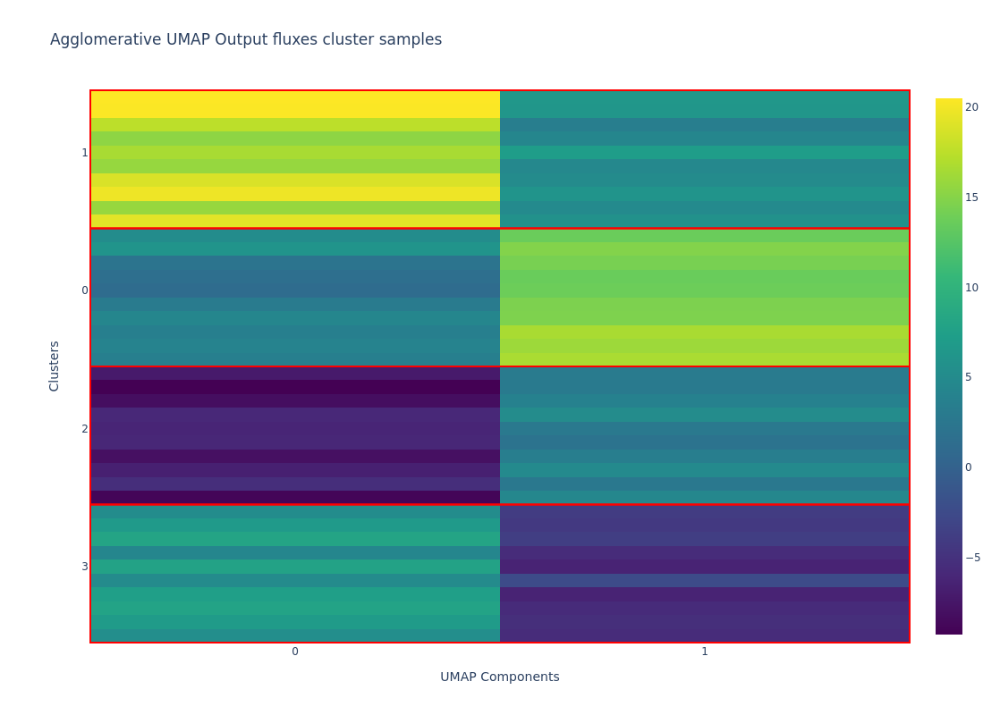

In [148]:
plot_grid_clusters(
    umap_output_fluxes_5m,
    umap_flux_agglomerative_labels_5m,
    [3,2,0,1],
    "Agglomerative UMAP Output fluxes cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumapoutputfluxes',
    'Agglomerative'
    )

In [149]:
print(normalized_mutual_info_score(umap_flux_kmeans_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_flux_dbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_flux_hdbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_flux_agglomerative_labels_5m, zernike_original_labels_5m))
print()

print(normalized_mutual_info_score(umap_flux_dbscan_labels_5m, umap_flux_kmeans_labels_5m))
print(normalized_mutual_info_score(umap_flux_hdbscan_labels_5m, umap_flux_kmeans_labels_5m))
print(normalized_mutual_info_score(umap_flux_agglomerative_labels_5m, umap_flux_kmeans_labels_5m))
print()

print(normalized_mutual_info_score(umap_flux_hdbscan_labels_5m, umap_flux_dbscan_labels_5m))
print(normalized_mutual_info_score(umap_flux_agglomerative_labels_5m, umap_flux_dbscan_labels_5m))
print()

print(normalized_mutual_info_score(umap_flux_agglomerative_labels_5m, umap_flux_hdbscan_labels_5m))

1.0
1.0
1.0
1.0

1.0
1.0
1.0

1.0
1.0

1.0


# Clustering UMAP PSF Intensities

In [192]:
umap_intensities_5m = np.load(minidataset_5m_dict['umap_intensities_path'])

The most repeated label is 2 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


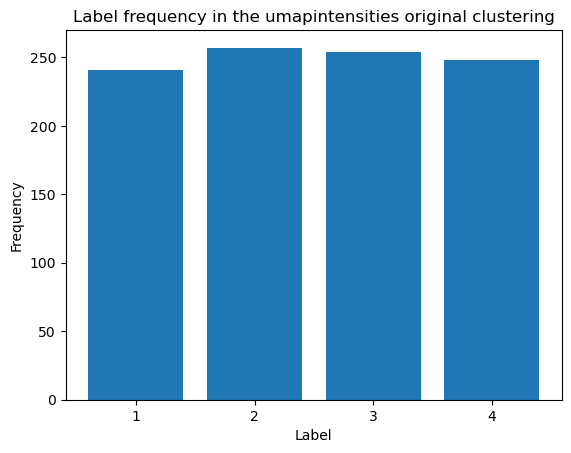

In [193]:
plot_cluster_labels_count(zernike_original_labels_5m, 
                          'original',
                          '5mumapintensities')

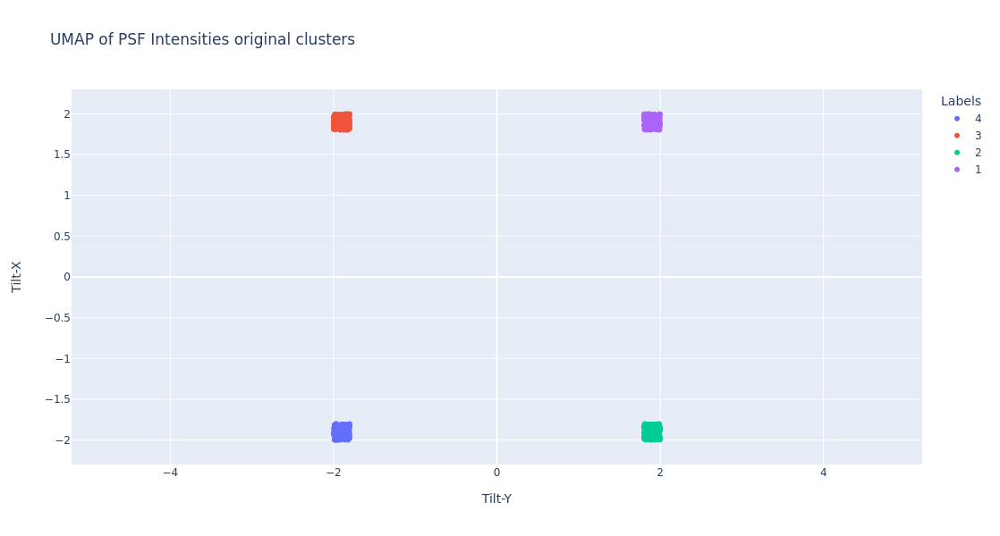

In [194]:
plot_clusters_from_labels(zernike_coefficients_5m,
                          zernike_original_labels_5m,
                          'UMAP of PSF Intensities original clusters',
                          'Tilt-Y',
                          'Tilt-X',
                          '5mumapintensities',
                          'original',
                          axis_range=[-2.3, 2.3])

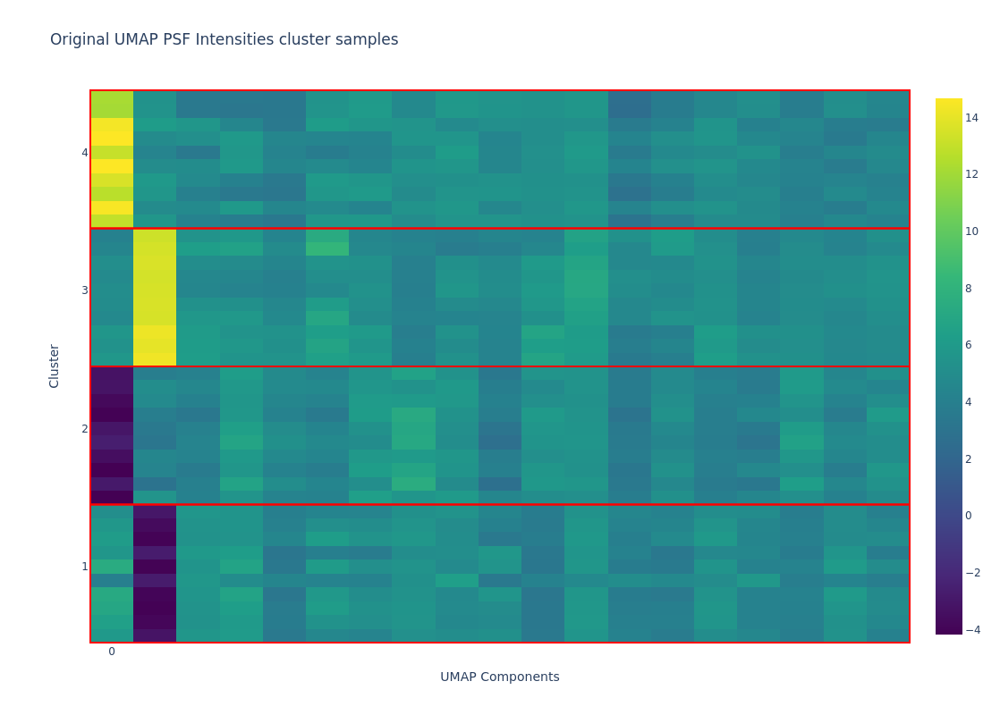

In [195]:
plot_grid_clusters(
    umap_intensities_5m,
    zernike_original_labels_5m,
    [1,2,3,4],
    "Original UMAP PSF Intensities cluster samples",
    "UMAP Components",
    "Cluster",
    19,
    '5mumapintensities',
    'original'
    )

### K-Means

In [196]:
kmeans = KMeans(n_clusters=4,
                n_init=10)
umap_intensities_kmeans_labels_5m = kmeans.fit_predict(umap_intensities_5m)

The most repeated label is 0 with 257 occurrences.
The least repeated label is 3 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


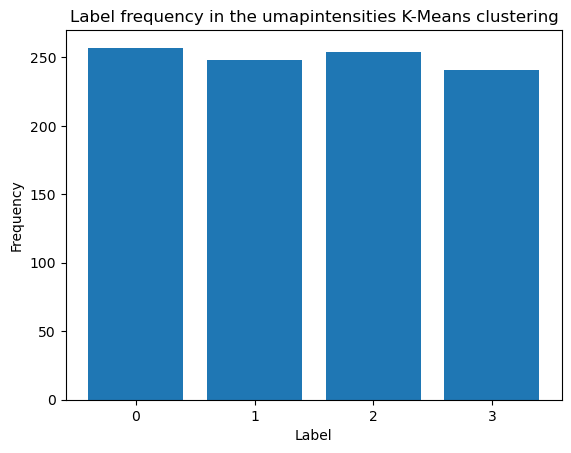

In [197]:
plot_cluster_labels_count(umap_intensities_kmeans_labels_5m, 
                          'K-Means',
                          '5mumapintensities')

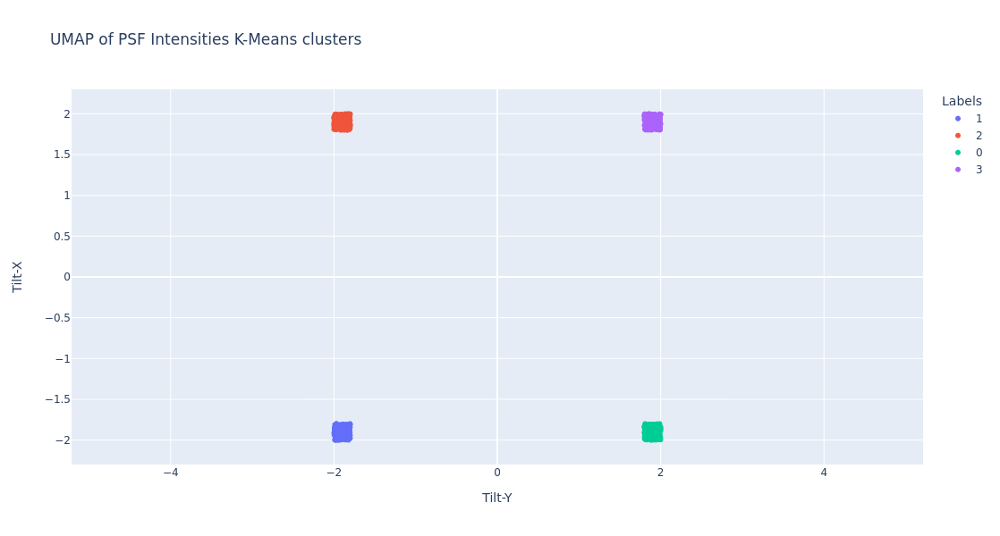

In [198]:
plot_clusters_from_labels(zernike_coefficients_5m,
                          umap_intensities_kmeans_labels_5m,
                          'UMAP of PSF Intensities K-Means clusters',
                          'Tilt-Y',
                          'Tilt-X',
                          '5mumapintensities',
                          'K-Means',
                          axis_range=[-2.3, 2.3])

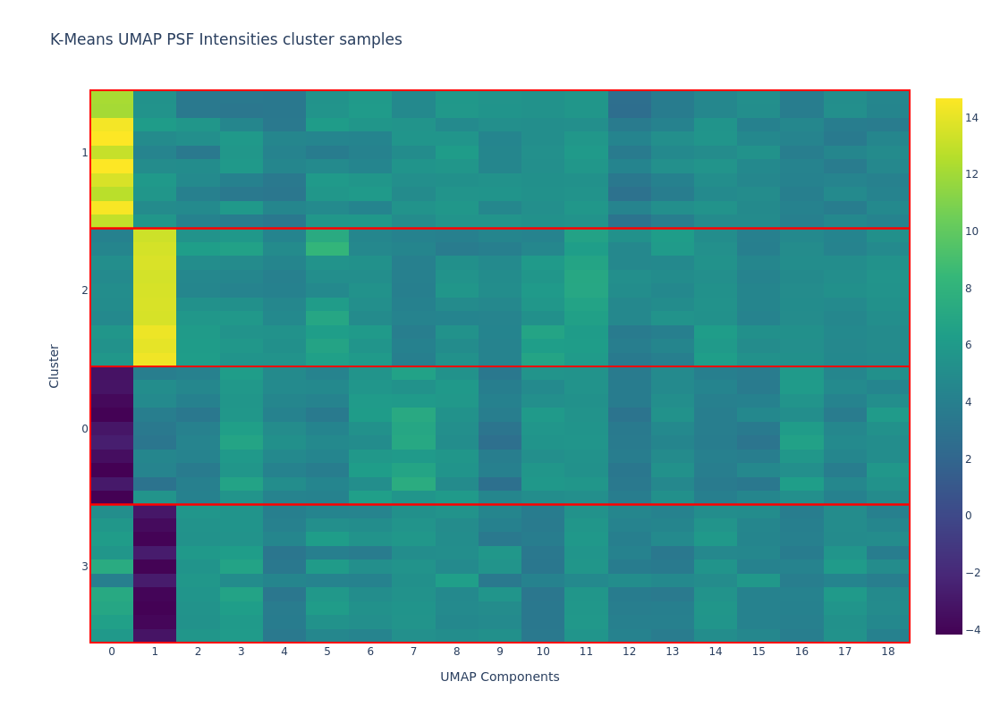

In [199]:
plot_grid_clusters(
    umap_intensities_5m,
    umap_intensities_kmeans_labels_5m,
    [3,0,2,1],
    "K-Means UMAP PSF Intensities cluster samples",
    "UMAP Components",
    "Cluster",
    1,
    '5mumapintensities',
    'K-Means'
    )

### DBSCAN

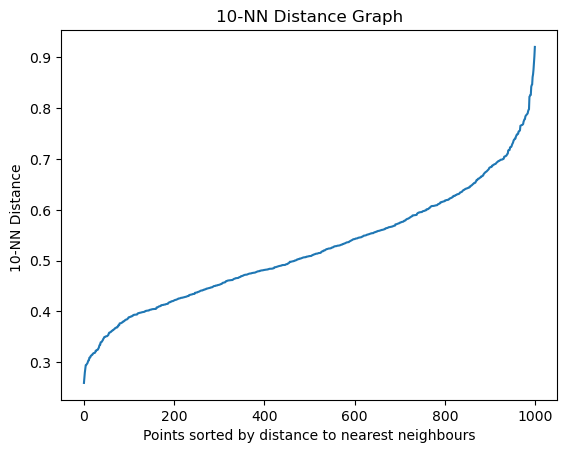

Number of clusters: 4
Numbers that are not noise: 1000


In [179]:
n_neighbours = 10
plot_kneighbours(umap_intensities_5m, n_neighbours)
epsilon = 0.85
dbscan_labels = get_number_of_clusters(umap_intensities_5m, epsilon, n_neighbours)

The most repeated label is 2 with 257 occurrences.
The least repeated label is 3 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


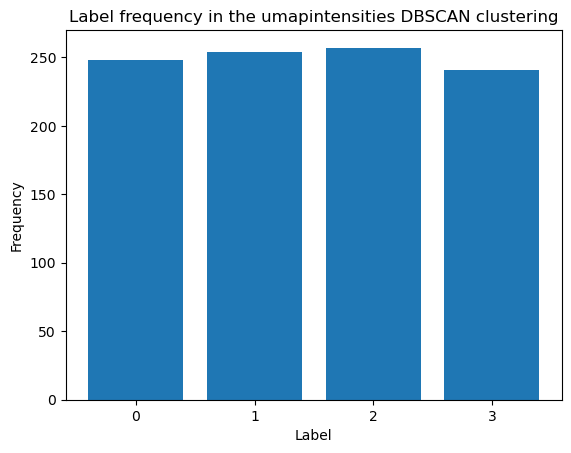

In [180]:
plot_cluster_labels_count(umap_intensities_dbscan_labels_5m, 
                          'DBSCAN', 
                          '5mumapintensities')

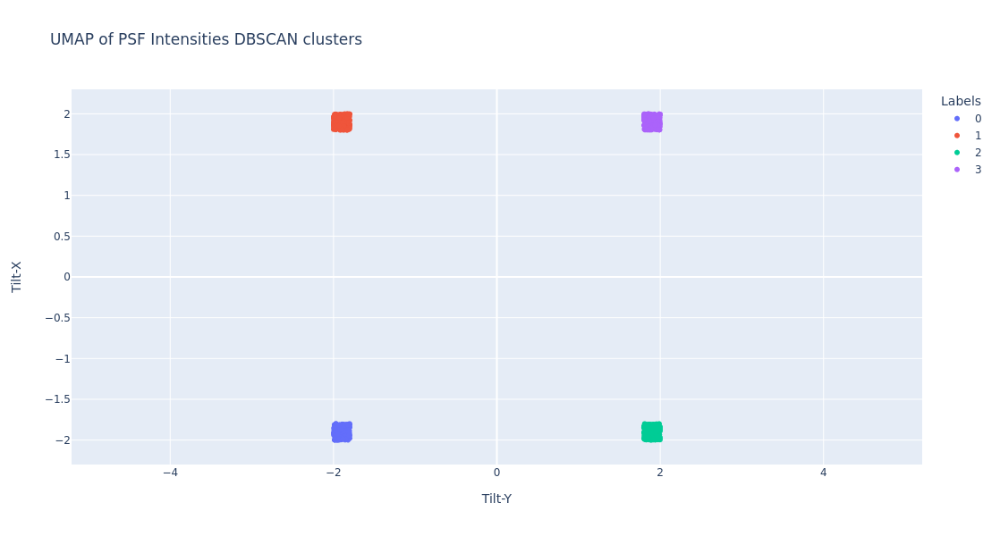

In [181]:
plot_clusters_from_labels(zernike_coefficients_5m,
                          umap_intensities_dbscan_labels_5m,
                          'UMAP of PSF Intensities DBSCAN clusters',
                          'Tilt-Y',
                          'Tilt-X',
                          '5mumapintensities',
                          'DBSCAN',
                          axis_range=[-2.3, 2.3])

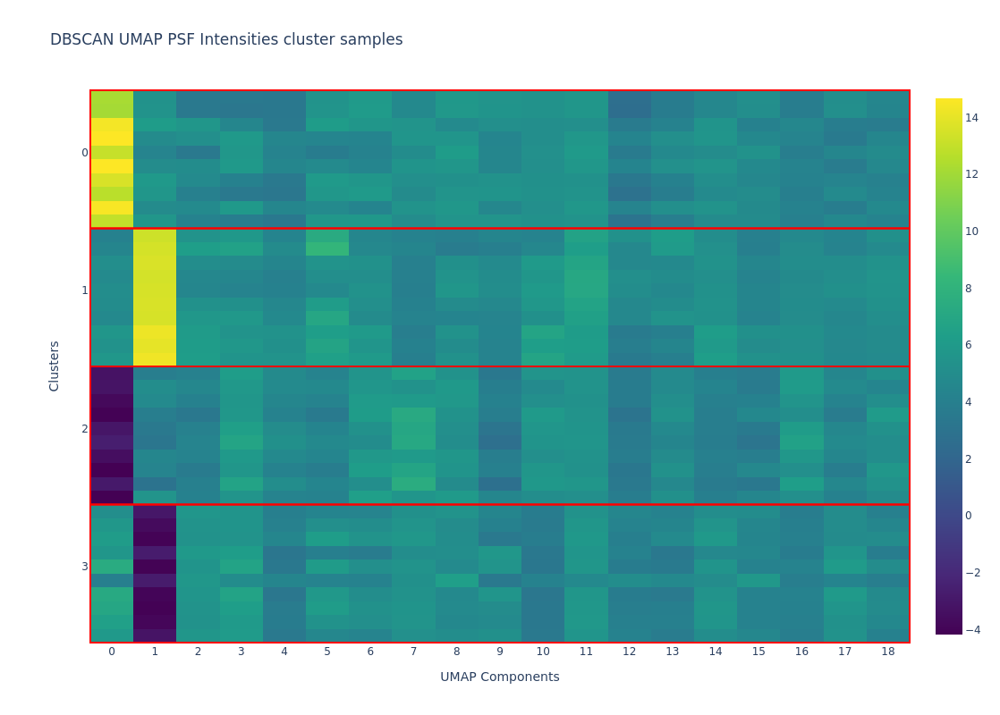

In [182]:
plot_grid_clusters(
    umap_intensities_5m,
    umap_intensities_dbscan_labels_5m,
    [3,2,1,0],
    "DBSCAN UMAP PSF Intensities cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumapintensities',
    'DBSCAN'
    )

### HDBSCAN

In [183]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=25)
umap_intensities_hdbscan_labels_5m = clusterer.fit_predict(umap_intensities_5m)

The most repeated label is 3 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


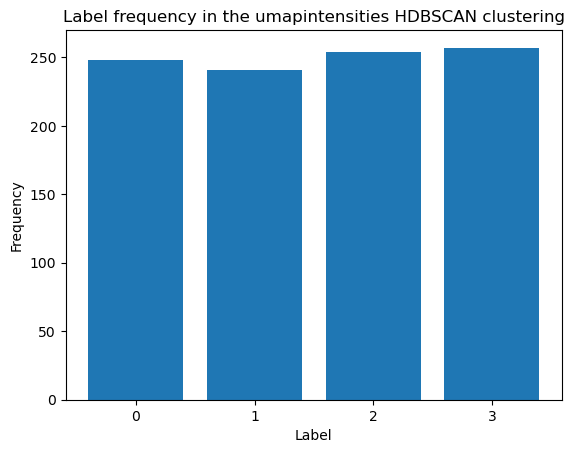

In [184]:
plot_cluster_labels_count(umap_intensities_hdbscan_labels_5m, 
                          'HDBSCAN', 
                          '5mumapintensities')

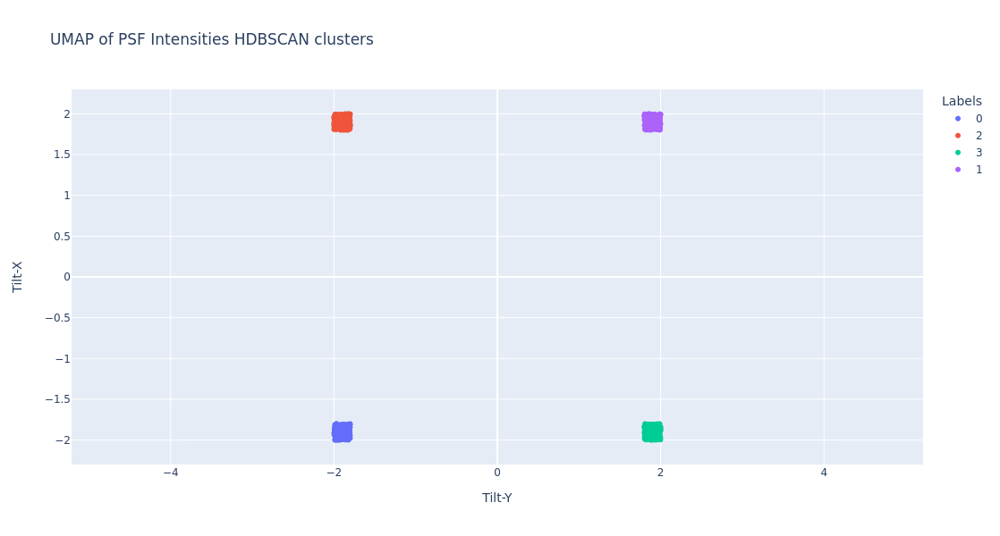

In [185]:
plot_clusters_from_labels(zernike_coefficients_5m,
                          umap_intensities_hdbscan_labels_5m,
                          'UMAP of PSF Intensities HDBSCAN clusters',
                          'Tilt-Y',
                          'Tilt-X',
                          '5mumapintensities',
                          'HDBSCAN',
                          axis_range=[-2.3, 2.3]
                          )

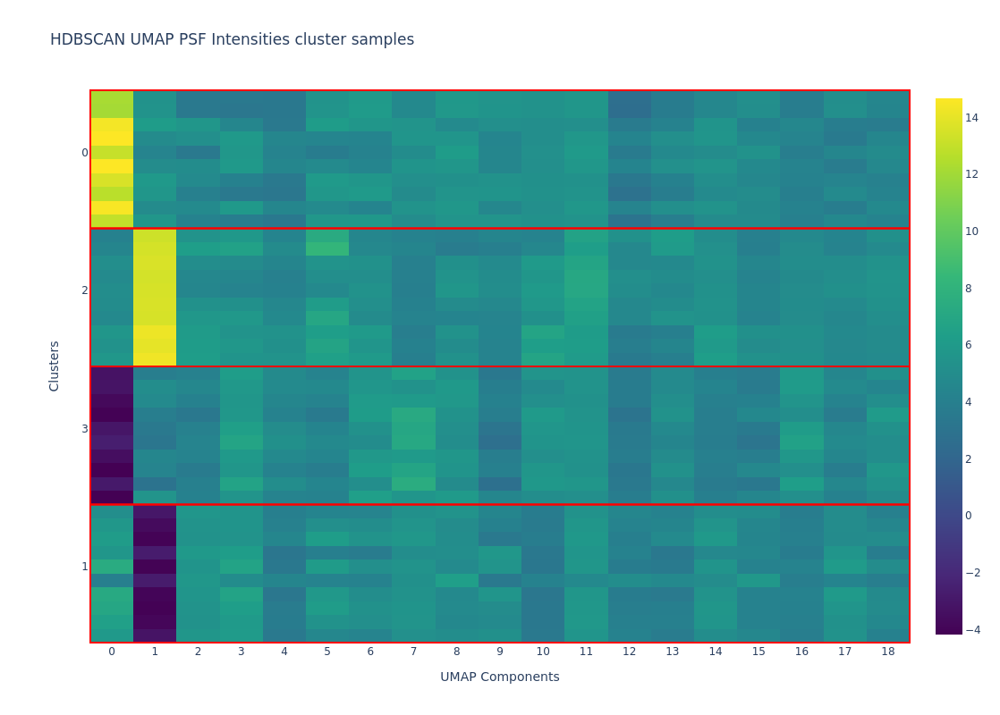

In [186]:
plot_grid_clusters(
    umap_intensities_5m,
    umap_intensities_hdbscan_labels_5m,
    [1,3,2,0],
    "HDBSCAN UMAP PSF Intensities cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumapintensities',
    'HDBSCAN'
    )

### Agglomerative clustering

In [187]:
agglomerativeclustering = AgglomerativeClustering(n_clusters=4)
umap_intensities_agglomerative_labels_5m = agglomerativeclustering.fit_predict(umap_intensities_5m)

The most repeated label is 0 with 257 occurrences.
The least repeated label is 1 with 241 occurrence.
Cluster density mean: 250.0
Cluster density variance: 6.123724356957945


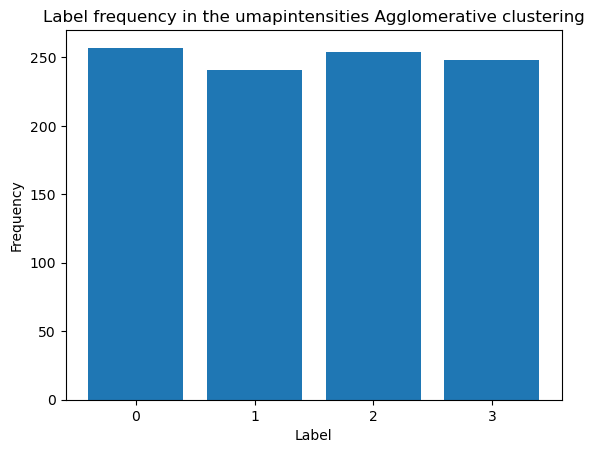

In [188]:
plot_cluster_labels_count(umap_intensities_agglomerative_labels_5m, 
                          'Agglomerative',
                          '5mumapintensities')

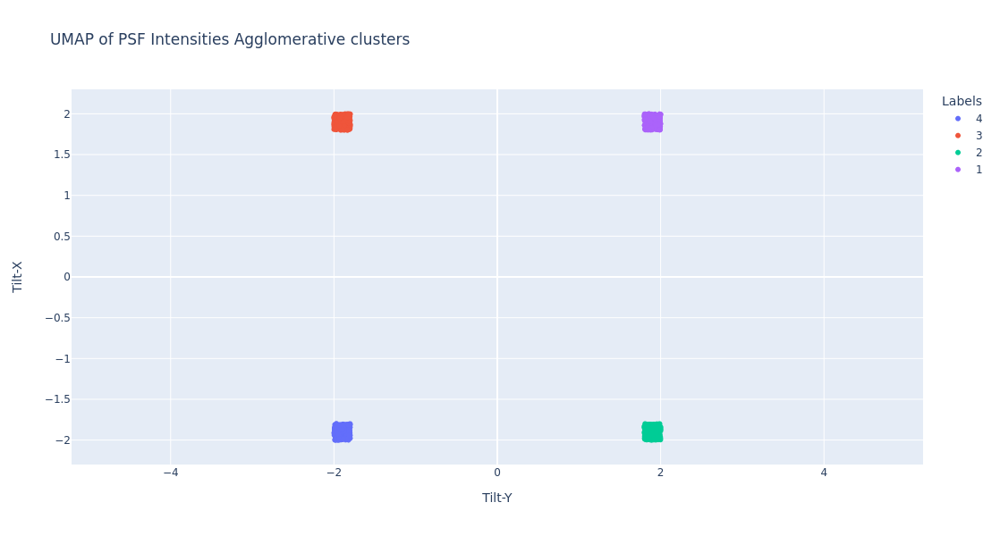

In [189]:
plot_clusters_from_labels(zernike_coefficients_5m,
                          umap_intensities_agglomerative_labels_5m,
                          'UMAP of PSF Intensities Agglomerative clusters',
                          'Tilt-Y',
                          'Tilt-X',
                          '5mumapintensities',
                          'Agglomerative',
                          axis_range=[-2.3, 2.3])

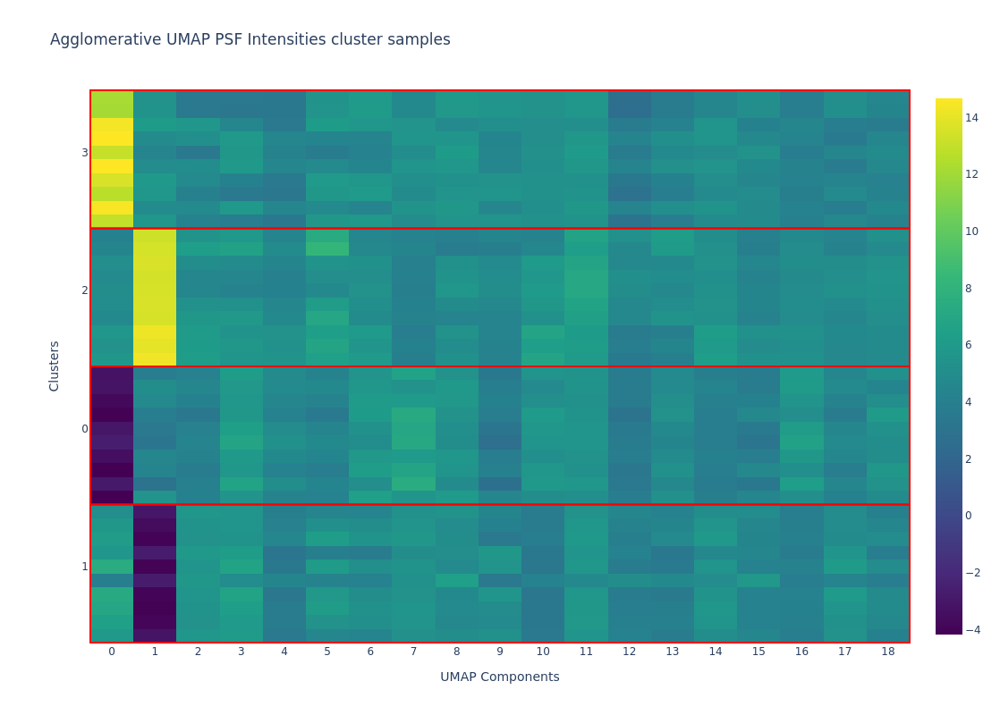

In [190]:
plot_grid_clusters(
    umap_intensities_5m,
    umap_intensities_agglomerative_labels_5m,
    [1,0,2,3],
    "Agglomerative UMAP PSF Intensities cluster samples",
    "UMAP Components",
    "Clusters",
    1,
    '5mumapintensities',
    'Agglomerative'
    )

In [191]:
print(normalized_mutual_info_score(umap_intensities_kmeans_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_intensities_dbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_intensities_hdbscan_labels_5m, zernike_original_labels_5m))
print(normalized_mutual_info_score(umap_intensities_agglomerative_labels_5m, zernike_original_labels_5m))
print()

print(normalized_mutual_info_score(umap_intensities_dbscan_labels_5m, pca_intensities_kmeans_labels))
print(normalized_mutual_info_score(umap_intensities_hdbscan_labels_5m, pca_intensities_kmeans_labels))
print(normalized_mutual_info_score(umap_intensities_agglomerative_labels_5m, pca_intensities_kmeans_labels))

print()
print(normalized_mutual_info_score(umap_intensities_hdbscan_labels_5m, pca_intensities_dbscan_labels))
print(normalized_mutual_info_score(umap_intensities_agglomerative_labels_5m, pca_intensities_dbscan_labels))

print()
print(normalized_mutual_info_score(umap_intensities_agglomerative_labels_5m, pca_intensities_hdbscan_labels))

1.0
1.0
1.0
1.0

1.0
1.0
1.0000000000000002

1.0
1.0000000000000002

1.0
